# Bayesian Calibration Using Alan's Processed Data

In this notebook, we do the full Bayesian calibration fit that *may* end up in the final paper, using data that went into the Nature Paper, processed by Alan. 

## Data Loading and Import

In [1]:
import h5py
import matplotlib.pyplot as plt
import numpy as np
from edges_cal import modelling as mdl
from edges_analysis.analysis import averaging
from edges_analysis import read_step
from pathlib import Path
from edges_analysis.analysis import s11 as s11m
from edges_cal import receiver_calibration_func as rcf

import mcmc_utils as mutl
from yabf import load_likelihood_from_yaml
from getdist import loadMCSamples
from yabf import ParamVec
from edges_analysis.analysis.calibrate import LabCalibration
from edges_estimate.eor_models import AbsorptionProfile
from edges_estimate.fitting import SemiLinearFit
from edges_cal.modelling import NoiseWaves, LinLog, Polynomial, UnitTransform
from yabf.core.samplers import run_map
from edges_estimate.likelihoods import NoiseWaveLikelihood, DataCalibrationLikelihood, LinearFG
from edges_cal import CalibrationObservation
from scipy import stats
from yabf.samplers.emcee import emcee
from scipy.interpolate import InterpolatedUnivariateSpline as spline
from getdist import plots
import alan_data_utils as utils
import alan_data as adata
from getdist import loadMCSamples
import glob
from p_tqdm import p_map
from getdist import MCSamples, ParamNames
import run_alan_precal_mcmc as precal
import run_alan_cal_mcmc as cal_mcmc
from IPython.display import Image
import notebook_utils as nutl
from astropy import units as u
from scipy.optimize import minimize
import pickle

from scipy.stats import gaussian_kde
plt.ion()
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
nutl.setup_mpl()

## Bayesian Pre-Calibration

### Maximum-Likelihood Only

In [3]:
calobs16 = utils.get_calobs(smooth=16)
calobs32 = utils.get_calobs(smooth=32)


In [7]:
def make_s11_sys(name, nscale, ndelay, scale_max, delay_max):
    out = dict(
        scale_model = Polynomial(n_terms=nscale, transform=UnitTransform(range=(50, 100))),
        delay_model = Polynomial(n_terms=ndelay, transform=UnitTransform(range=(50, 100)))
    )
    
    scale_params = {f"{name}_logscale_{i}": {'min': np.log10(1 - scale_max), 'max': np.log10(1 + scale_max), 'determines': f'logscale_{i}'} for i in range(nscale)}
    delay_params = {f"{name}_delay_{i}": {'min': -delay_max, 'max': delay_max, 'determines': f'delay_{i}'} for i in range(ndelay)}
    
    return {
        **out,
        **scale_params,
        **delay_params
    }
     

In [28]:
cal_lks = {}
cal_lks['ML'] = utils.get_cal_lk(utils.calobs, tns_width=500)
#cal_lks['ML (src)'] = utils.get_cal_lk(utils.calobs, reweight_sources=True, sig_by_tns=False)
#cal_lks['ML (frq)'] = utils.get_cal_lk(utils.calobs, reweight_frequencies=True, sig_by_tns=False)
cal_lks['ML (unw)'] = utils.get_cal_lk(utils.calobs, sig_by_sigq=False, sig_by_tns=False, tns_width=500)
#cal_lks['ML (<cbl,frq)'] = utils.get_cal_lk(utils.calobs, reweight_frequencies=True, cable_noise_factor=100, sig_by_tns=False)
#cal_lks['ML (<cbl,tns)'] = utils.get_cal_lk(utils.calobs, reweight_frequencies=False, cable_noise_factor=100, sig_by_tns=False)
cal_lks['ML (<cbl)'] = utils.get_cal_lk(utils.calobs, reweight_frequencies=False, cable_noise_factor=100, sig_by_tns=True, tns_width=500)
#cal_lks['ML (-short)'] = utils.get_cal_lk(utils.calobs, ignore_sources=("short",))
#cal_lks['ML (-open)'] = utils.get_cal_lk(utils.calobs, ignore_sources=("open",))
#cal_lks['ML (-cbl)'] = utils.get_cal_lk(utils.calobs, ignore_sources=("open",'short'))
#cal_lks['ML (<short)'] = utils.get_cal_lk(utils.calobs, source_factors=(1, 1, 1, 100))
#cal_lks['ML (<short,hot)'] = utils.get_cal_lk(utils.calobs, source_factors=(1, 100, 1, 100))

cal_lks['ML (s11)'] = utils.get_cal_lk(
    utils.calobs, 
    s11_systematic_params={
        'short': make_s11_sys('short', nscale=1, ndelay=1, scale_max=1e-2, delay_max=10)
    }, 
    tns_width=500
)

cal_lks['ML (s11,cbl2)'] = utils.get_cal_lk(
    utils.calobs, 
    s11_systematic_params={
        'short': make_s11_sys('short', nscale=2, ndelay=1, scale_max=1e-2, delay_max=10),
        'open': make_s11_sys('open', nscale=2, ndelay=1, scale_max=1e-2, delay_max=10),
    }, 
    tns_width=500
)

cal_lks['ML (s11,cbl31)'] = utils.get_cal_lk(
    utils.calobs, 
    s11_systematic_params={
        'short': make_s11_sys('short', nscale=3, ndelay=1, scale_max=1e-2, delay_max=10),
        'open': make_s11_sys('open', nscale=3, ndelay=1, scale_max=1e-2, delay_max=10),
    }, 
    tns_width=500
)

cal_lks['ML (s11,cbl41)'] = utils.get_cal_lk(
    utils.calobs, 
    s11_systematic_params={
        'short': make_s11_sys('short', nscale=4, ndelay=1, scale_max=1e-2, delay_max=10),
        'open': make_s11_sys('open', nscale=4, ndelay=1, scale_max=1e-2, delay_max=10),
    }, 
    tns_width=500
)

cal_lks['ML (s11,cbl12)'] = utils.get_cal_lk(
    utils.calobs, 
    s11_systematic_params={
        'short': make_s11_sys('short', nscale=1, ndelay=2, scale_max=1e-2, delay_max=10),
        'open': make_s11_sys('open', nscale=1, ndelay=2, scale_max=1e-2, delay_max=10),
    }, 
    tns_width=500
)

cal_lks['ML (s11,cbl13)'] = utils.get_cal_lk(
    utils.calobs, 
    s11_systematic_params={
        'short': make_s11_sys('short', nscale=3, ndelay=3, scale_max=1e-2, delay_max=10),
        'open': make_s11_sys('open', nscale=3, ndelay=3, scale_max=1e-2, delay_max=10),
    }, 
    tns_width=500
)
cal_lks['ML (s11,cbl14)'] = utils.get_cal_lk(
    utils.calobs, 
    s11_systematic_params={
        'short': make_s11_sys('short', nscale=1, ndelay=4, scale_max=1e-2, delay_max=10),
        'open': make_s11_sys('open', nscale=1, ndelay=4, scale_max=1e-2, delay_max=10),
    }, 
    tns_width=500
)

cal_lks['ML (s11,cbl22)'] = utils.get_cal_lk(
    utils.calobs, 
    s11_systematic_params={
        'short': make_s11_sys('short', nscale=2, ndelay=2, scale_max=1e-2, delay_max=10),
        'open': make_s11_sys('open', nscale=2, ndelay=2, scale_max=1e-2, delay_max=10),
    }, 
    tns_width=500
)

cal_lks['ML (s11,cbl33)'] = utils.get_cal_lk(
    utils.calobs, 
    s11_systematic_params={
        'short': make_s11_sys('short', nscale=3, ndelay=3, scale_max=1e-2, delay_max=10),
        'open': make_s11_sys('open', nscale=3, ndelay=3, scale_max=1e-2, delay_max=10),
    }, 
    tns_width=500
)

cal_lks['ML (s11,cbl44)'] = utils.get_cal_lk(
    utils.calobs, 
    s11_systematic_params={
        'short': make_s11_sys('short', nscale=4, ndelay=4, scale_max=1e-2, delay_max=10),
        'open': make_s11_sys('open', nscale=4, ndelay=4, scale_max=1e-2, delay_max=10),
    }, 
    tns_width=500
)







# cal_lks['ML (s11,cbl)'] = utils.get_cal_lk(utils.calobs, s11_systematic_params={
#     'short': {
#         'scale': {'min': 0.99, 'max': 1.01}, 
#         #'offset': {'min': -0.1, 'max': 0.1}, 
#         'delay': {'min': -.01, 'max': 0.01}
#     },
#     'open': {
#         'open_scale': {'min': 0.99, 'max': 1.01, 'determines': 'scale'}, 
#         #'open_offset': {'min': -0.1, 'max': 0.1, 'determines': 'offset'}, 
#         'open_delay': {'min': -.01, 'max': 0.01, 'determines': 'delay'}
#     },
# }, tns_width=500)

# cal_lks['ML (s11,cbl) (32ch)'] = utils.get_cal_lk(calobs32, s11_systematic_params={
#     'short': {
#         'scale': {'min': 0.99, 'max': 1.01}, 
#         #'offset': {'min': -0.1, 'max': 0.1}, 
#         'delay': {'min': -.01, 'max': 0.01}
#     },
#     'open': {
#         'open_scale': {'min': 0.99, 'max': 1.01, 'determines': 'scale'}, 
#         #'open_offset': {'min': -0.1, 'max': 0.1, 'determines': 'offset'}, 
#         'open_delay': {'min': -.01, 'max': 0.01, 'determines': 'delay'}
#     },
# }, tns_width=500)

# cal_lks['ML (s11,cbl1) (32ch)'] = utils.get_cal_lk(calobs32, s11_systematic_params={
#     'short': {
#         'scale': {'min': 0.99, 'max': 1.01}, 
#         #'offset': {'min': -0.1, 'max': 0.1}, 
#         'delay': {'min': -.01, 'max': 0.01}
#     },
#     'open': {
#         'scale': {'min': 0.99, 'max': 1.01, 'determines': 'scale'}, 
#         #'open_offset': {'min': -0.1, 'max': 0.1, 'determines': 'offset'}, 
#         'delay': {'min': -.01, 'max': 0.01, 'determines': 'delay'}
#     },
# }, tns_width=500)



# cal_lks['ML (s11,all)'] = utils.get_cal_lk(utils.calobs, s11_systematic_params={
#     'short': {
#         'scale': {'min': 0.99, 'max': 1.01}, 
#         #'offset': {'min': -0.1, 'max': 0.1}, 
#         'delay': {'min': -.01, 'max': 0.01}
#     },
#     'open': {
#         'open_scale': {'min': 0.99, 'max': 1.01, 'determines': 'scale'}, 
#         #'open_offset': {'min': -0.1, 'max': 0.1, 'determines': 'offset'}, 
#         'open_delay': {'min': -.01, 'max': 0.01, 'determines': 'delay'}
#     },
#     'ambient': {
#         'ambient_scale': {'min': 0.99, 'max': 1.01, 'determines': 'scale'}, 
#         #'ambient_offset': {'min': -0.1, 'max': 0.1, 'determines': 'offset'}, 
#         'ambient_delay': {'min': -.01, 'max': 0.01, 'determines': 'delay'}
#     },
#     'hot_load': {
#         'hot_load_scale': {'min': 0.99, 'max': 1.01, 'determines': 'scale'}, 
#         #'hot_load_offset': {'min': -0.1, 'max': 0.1, 'determines': 'offset'}, 
#         'hot_load_delay': {'min': -.01, 'max': 0.01, 'determines': 'delay'}
#     },
# }, tns_width=500)

# cal_lks['ML (s11,all,lna)'] = utils.get_cal_lk(utils.calobs, s11_systematic_params={
#     'short': {
#         'scale': {'min': 0.99, 'max': 1.01}, 
#         #'offset': {'min': -0.1, 'max': 0.1}, 
#         'delay': {'min': -.01, 'max': 0.01}
#     },
#     'open': {
#         'open_scale': {'min': 0.99, 'max': 1.01, 'determines': 'scale'}, 
#         #'open_offset': {'min': -0.1, 'max': 0.1, 'determines': 'offset'}, 
#         'open_delay': {'min': -.01, 'max': 0.01, 'determines': 'delay'}
#     },
#     'ambient': {
#         'ambient_scale': {'min': 0.99, 'max': 1.01, 'determines': 'scale'}, 
#         #'ambient_offset': {'min': -0.1, 'max': 0.1, 'determines': 'offset'}, 
#         'ambient_delay': {'min': -.01, 'max': 0.01, 'determines': 'delay'}
#     },
#     'hot_load': {
#         'hot_load_scale': {'min': 0.99, 'max': 1.01, 'determines': 'scale'}, 
#         #'hot_load_offset': {'min': -0.1, 'max': 0.1, 'determines': 'offset'}, 
#         'hot_load_delay': {'min': -.01, 'max': 0.01, 'determines': 'delay'}
#     },
#     'rcv': {
#         'rcv_scale': {'min': 0.99, 'max': 1.01, 'determines': 'scale'}, 
#         #'hot_load_offset': {'min': -0.1, 'max': 0.1, 'determines': 'offset'}, 
#         'rcv_delay': {'min': -.01, 'max': 0.01, 'determines': 'delay'}
#     },
# }, tns_width=500)


In [ ]:
with open("cal_lk_res.pkl", 'rb') as fl:
    cal_lk_res = pickle.load(fl)
    
#del cal_lk_res['ML (s11)']

for name, lk in cal_lks.items():
    if name not in cal_lk_res:
        print(name)
        cal_lk_res[name] = run_map(lk.partial_linear_model, dual_annealing_kw={})

In [ ]:
with open("cal_lk_res.pkl", 'wb') as fl:
    pickle.dump(cal_lk_res, fl)

In [21]:
curves = {
    name: lk.get_cal_curves(cal_lk_res[name].x) for name, lk in cal_lks.items()
}

In [22]:
recals = {}

recals['alan'] = adata.sky_data['t_ant']

for name, clb in (('Iterative', utils.calobs), ("Iterative (16ch)", calobs16)):
    recals[name] = utils.recalibrate(utils.get_labcal(clb), f_sky=adata.sky_data['freq'], t_sky=adata.sky_data['t_ant'])
    
for name, lk in cal_lks.items():
    a, b = lk.get_linear_coefficients(
        freq=adata.sky_freq, labcal=utils.labcal, params=cal_lk_res[name].x
    )
    recals[name] = utils.recalibrate(utils.labcal, f_sky=adata.sky_data['freq'], t_sky=adata.sky_data['t_ant'], a=a,b=b)
    
for name, clb in (("Iterative (32ch)", calobs32),):
    recals[name] = utils.recalibrate(utils.get_labcal(clb), f_sky=adata.sky_data['freq'], t_sky=adata.sky_data['t_ant'])

In [23]:
from multiprocessing import Pool

In [24]:
def get_slf(recal):
    linlog5 = mdl.LinLog(n_terms=5)
    return SemiLinearFit(
        fg=linlog5.at(x=adata.sky_freq), 
        eor=utils.make_absorption(adata.sky_freq),
        spectrum=recal, 
        sigma=0.03
    )
def get_features(recal):
    slf = get_slf(recal)
    return slf(dual_annealing_kw={})

In [25]:
p = Pool(16)

Process ForkPoolWorker-25:
Process ForkPoolWorker-30:
Process ForkPoolWorker-32:
Process ForkPoolWorker-24:
Process ForkPoolWorker-28:
Process ForkPoolWorker-22:
Process ForkPoolWorker-27:
Process ForkPoolWorker-26:
Process ForkPoolWorker-29:
Process ForkPoolWorker-21:
Process ForkPoolWorker-17:
Process ForkPoolWorker-19:
Process ForkPoolWorker-18:
Process ForkPoolWorker-23:
Process ForkPoolWorker-31:
Process ForkPoolWorker-20:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/home/smurray/miniconda3/envs/edges/lib/python3.9/multiprocessing/process.py", line 315, in _bootstrap
    self.run()
Traceback (most recent call last):
Traceback (most recent call last):
  File "/home/smurray/miniconda3/envs/edges/lib/python3.9

In [26]:
# Don't change this, it's finnicky with multiprocessing.
features = dict(zip(recals.keys(), list(p.map(get_features, list(recals.values())))))
slfs = {name: get_slf(recal) for name, recal in recals.items()}

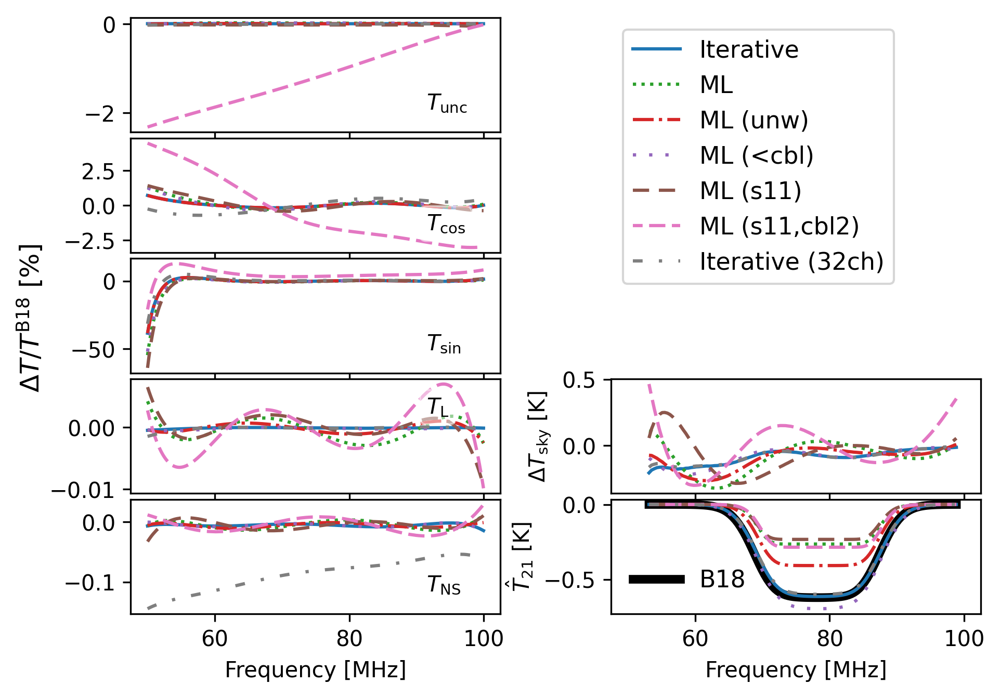

In [27]:
fig, ax = plt.subplots(5, 2, sharex=True, figsize=(nutl.double_width, 1.5*nutl.single_width), gridspec_kw={'hspace': 0.05, 'wspace': 0.3})

plt.rcParams['axes.labelsize'] = 10
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10

ignore = [
    'ML (src)',
    'ML (frq)',
    'ML (sep)',
    'ML (sep,lin)',
    'ML (sep,nl)',
    'Iterative (16ch)',
    'ML (-cbl)',
    'ML (<short,hot)',
    'ML (<cbl,frq)',
    'ML (<cbl,tns)',
    'ML (-short)',
    'ML (-open)',
    'ML (<short)',
    'ML (s11,all,lna)',
    # 'ML (s11)',
    # 'ML (s11,cbl)',
    # 'ML (s11,cbl) (32ch)',
    'ML (s11,cbl1) (32ch)',
]

linestyles = ['-', '--', ':', '-.'] + [
     (0, (1, 4)),
     (0, (5, 3)),
     (2, (5, 2)),
     (0, (3, 5, 1, 5)),
     (0, (3, 1, 1, 1)),
     (0, (3, 3, 1, 3, 1, 3)),
     (1, (4, 3, 1, 3, 1, 3)),
     (0, (3, 1, 1, 1, 1, 1))
]

for i, (name, model) in enumerate(curves['ML'].items()):
    if name == 'params':
        continue
    
    if name == 'tload':
        aname = 'offset'
    elif name == 'tns':
        aname = 'scale'
    else:
        aname = name
        
    alans = adata.calibration[aname].copy()
    
    ylab = {
        'tunc': r'$T_{\rm unc}$',
        'tcos': r'$T_{\rm cos}$',
        'tsin': r'$T_{\rm sin}$',
        'tload': r'$T_{\rm L}$',
        'tns': r'$T_{\rm NS}$'
    }[name]
    ax[i, 0].text(0.8, 0.2 if i!=3 else 0.7, ylab, transform=ax[i, 0].transAxes, 
                  fontweight='heavy', backgroundcolor='white', 
                  bbox={'alpha': 0.5, 'facecolor': 'white', 'edgecolor': 'white', 'boxstyle':'round'})
    calobs_name = {
        'tunc': 'Tunc',
        'tcos': 'Tcos',
        'tsin': 'Tsin',
        'tload': 'C2',
        'tns': 'C1'
    }[name]
    
    v = getattr(utils.calobs, calobs_name)()
    v16 = getattr(calobs16, calobs_name)()
    v32 = getattr(calobs32, calobs_name)()
    
    if calobs_name == 'C2':
        v = utils.calobs.t_load - v
        v16 = utils.calobs.t_load - v16
        v32 = utils.calobs.t_load - v32
        alans = utils.calobs.t_load - alans
    if calobs_name == 'C1':
        v *= utils.calobs.t_load_ns
        v16 *= utils.calobs.t_load_ns
        v32 *= utils.calobs.t_load_ns
        alans *= utils.calobs.t_load_ns
        
    all_curves = (('Iterative', v), ("Iterative (16ch)", v16)) + tuple(curves.items()) + (('Iterative (32ch)', v32),)
    for j, (lbl, crv) in enumerate(all_curves):
        if lbl in ignore:
            continue
            
        if isinstance(crv, dict):
            m = crv[name]
        else:
            m = crv
            
        freq = utils.calobs.freq.freq
            
        if '16ch' in lbl:
            a = alans[::2]
            f = freq[::2].copy()
        elif '32ch' in lbl:
            a = alans[::4]
            f = freq[::4].copy()
        else:
            a = alans
            f = freq.copy()
            
        ax[i, 0].plot(f, 100*(m - a)/a, label=lbl, ls=linestyles[j%len(linestyles)], color=f'C{j%10}')

linlog5 = mdl.LinLog(n_terms=5)

for i, (name, recal) in enumerate(recals.items()):
    if name in ignore:
        continue
        
    color = 'k' if not i else f"C{(i-1)%10}"
    ls=linestyles[(i-1)%len(linestyles)] if i > 0 else '-'
    
    if name != 'alan':
        ax[-2, 1].plot(adata.sky_freq, recal - adata.sky_data['t_ant'], color=color, ls=ls)

    res, slf = features[name], slfs[name]
    if not res.success:
        print(i, "was not successful")

    ax[-1, 1].plot(adata.sky_freq, slf.get_eor(res.x), color=color, ls=ls, lw=4 if name=='alan' else 1.5, label='B18' if name == 'alan' else None, )

ax[0, 1].axis('off')
ax[1, 1].axis('off')
ax[2, 1].axis('off')

ax[-1, 1].set_ylabel(r"$\hat{T}_{21}$ [K]")

# fig.text(0.04, 2.5/7, )
#plt.annotate(r'$\Delta T / T^{\rm B18}$', va='center', rotation='vertical', xytext=(0.04, 2.5/7), xy=(0.04, 1), transform=fig.transFigure)
ax[-2, 1].set_ylabel(r"$\Delta T_{\rm sky}$ [K]")
ax[0, 0].legend(ncol=1, bbox_to_anchor=(1.3, 1.), loc='upper left')
ax[-1, 1].legend(loc='lower left', frameon=False)
ax[-1, 1].set_xlabel("Frequency [MHz]")
ax[-1, 0].set_xlabel("Frequency [MHz]")

fig.supylabel(r"$\Delta T / T^{\rm B18}$ [%]")
fig.savefig("plots/differences_with_alan.pdf")
#fig.suptitle("Calibration Function Estimates")

In [166]:
(
    cal_lks['ML (s11,cbl)'].partial_linear_model.logp(params=cal_lk_res['ML (s11,cbl) (32ch)'].x),
    cal_lks['ML (s11,cbl)'].partial_linear_model.logp(params=cal_lk_res['ML (s11,cbl)'].x)
)

(8679.803510074798, 8878.306560896559)

In [167]:
(
    cal_lks['ML (s11,cbl) (32ch)'].partial_linear_model.logp(params=cal_lk_res['ML (s11,cbl) (32ch)'].x),
    cal_lks['ML (s11,cbl) (32ch)'].partial_linear_model.logp(params=cal_lk_res['ML (s11,cbl)'].x)
)

(2124.6435669656216, 1928.912336388958)

In [152]:
curves['ML (s11,all)']['tload'][0], utils.calobs.t_load - utils.calobs.C2()[0], utils.calobs.t_load - adata.calibration['offset'][0]

(301.59749749049524, 301.593570300207, 301.595028)

In [154]:
100*(1 - curves['ML (s11,all)']['tload'][0]/(utils.calobs.t_load - adata.calibration['offset'][0])), 100*(1 - (utils.calobs.t_load - utils.calobs.C2()[0])/(utils.calobs.t_load - adata.calibration['offset'][0]))

(-0.0008188100817152488, 0.00048333018044521836)

In [11]:
plm = cal_lks['ML'].partial_linear_model
%timeit plm()

14.3 ms ± 959 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [13]:
plm = cal_lks['ML (s11,cbl)'].partial_linear_model
%timeit plm()

21.2 ms ± 1.05 ms per loop (mean ± std. dev. of 7 runs, 100 loops each)


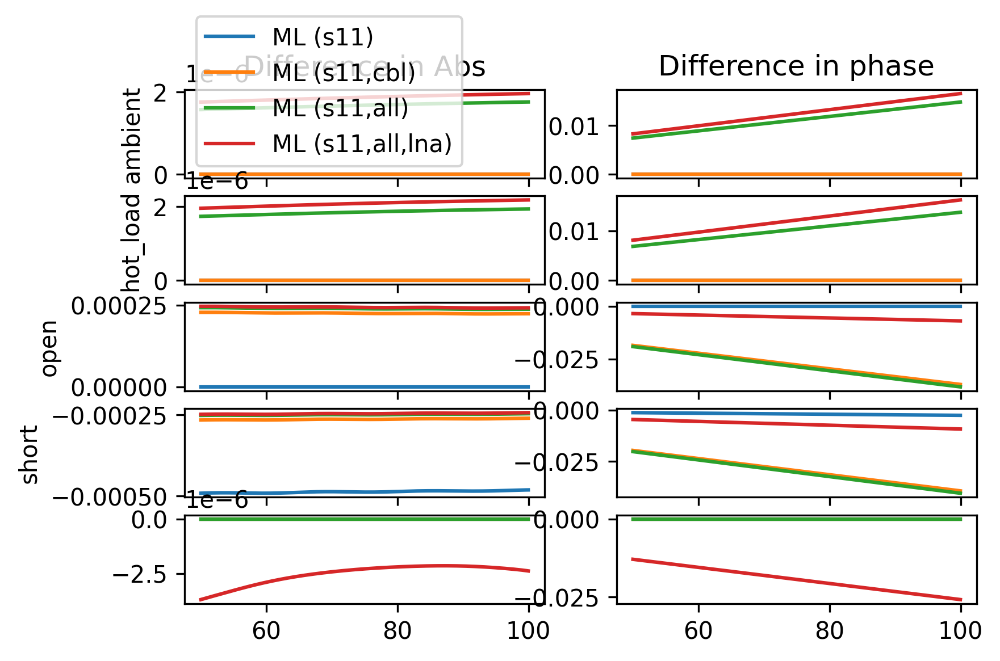

In [14]:
fig, ax = plt.subplots(5, 2, sharex=True)

f = utils.calobs.freq.freq.to_value("MHz")

for name, lk in cal_lks.items():
    if name in ignore:
        continue
    
    if 'open_gamma' in lk.partial_linear_model.child_provides:
        ctx = lk.partial_linear_model.get_ctx(params=cal_lk_res[name].x)

        for i, src in enumerate(utils.calobs.load_names):
            ax[i,0].plot(f, np.abs(ctx[f'{src}_gamma'])- np.abs(utils.calobs.loads[src].reflections.s11_model(f)), label=name)
            ax[i,1].plot(f, np.unwrap(np.angle(ctx[f'{src}_gamma'])) - np.unwrap(np.angle(utils.calobs.loads[src].reflections.s11_model(f))))

            ax[i,0].set_ylabel(src)

        ax[-1, 0].plot(f, np.abs(ctx[f'rcv_gamma'])- np.abs(utils.calobs.receiver.s11_model(f)))
        ax[-1,1].plot(f, np.unwrap(np.angle(ctx[f'rcv_gamma'])) - np.unwrap(np.angle(utils.calobs.receiver.s11_model(f))))

        
ax[0,0].set_title("Difference in Abs")
ax[0,1].set_title("Difference in phase")

        
ax[0,0].legend()
    

In [144]:
## Bayesian Information Criterion
for name, lk in cal_lks.items():
    lnl = lk.partial_linear_model.logl(params=cal_lk_res[name].x)
    print(f"{name:<15}", 
          len(lk.partial_linear_model.child_active_params) * np.log(len(lk.data['data_variance'])) - 2 * lnl,
          lnl,
          cal_lk_res[name].x
         )

ML              -15351.241619233033 7700.574108116674 [ 1.48631339e+03 -1.95133424e+02  6.28180855e+01 -2.15014873e+01
  7.37325297e+00 -1.36729744e+00]
ML (unw)        6082677.702151008 -3041313.8977770037 [1486.28874478 -195.47840379   63.01295727  -20.03555585    7.12887304
   -2.58125607]
ML (<cbl)       73095.96869564647 -36523.03104932308 [1486.26040991 -195.79922456   63.31499146  -18.66759879    6.80132201
   -3.77354494]
ML (s11)        -17697.472569521207 8882.00734942748 [ 1.48634120e+03 -1.95089601e+02  6.24954010e+01 -2.18127973e+01
  7.71360434e+00 -9.99156810e-01  9.99482053e-01  2.65886134e-05]
ML (s11,cbl)    -17725.032339430287 8904.10500054874 [ 1.48620711e+03 -1.94899155e+02  6.38127790e+01 -2.28499794e+01
  6.21317624e+00  2.05602655e-02  9.90519315e-01  5.28637646e-04
  9.90005944e-01  5.51240320e-04]
ML (s11,cbl) (32ch) -4231.569295179609 2150.442006617802 [ 1.48565051e+03 -1.93987326e+02  6.31243018e+01 -2.25780427e+01
  6.27550484e+00  8.65864467e-02  9.9051568

In [11]:
antsim = utils.calobs.new_load('AntSim1', io_obj = utils.calobs.metadata['io'])

In [12]:
these_loads = {**utils.calobs.loads, **{'antsim': antsim}}

In [13]:
(these_loads['ambient'].spectrum.variance_Q / these_loads['ambient'].spectrum.n_integrations)

array([2.49426004e-09, 2.43529932e-09, 2.42969331e-09, ...,
       1.69198031e-09, 1.77153942e-09, 1.73304741e-09])

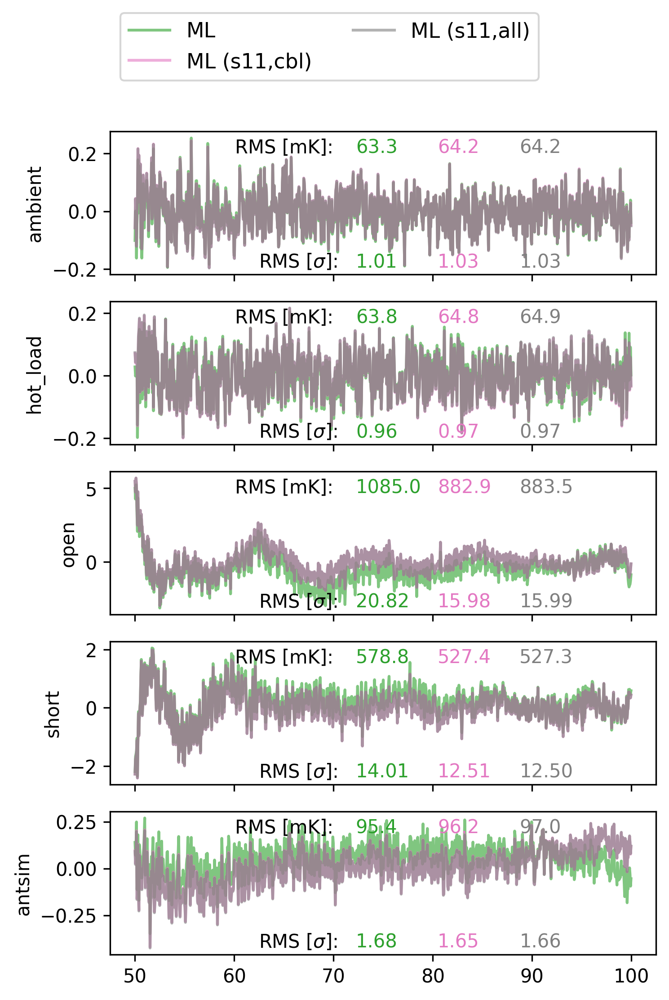

In [15]:
fig, ax = plt.subplots(5, 1, figsize=(1.5*nutl.single_width, 2.2*nutl.single_width), sharex=True)


n = 0
for j, (name, lk) in enumerate(cal_lks.items()):
    if name in ignore + ['ML (unw)', 'ML (s11)', 'ML (<cbl)']:
        continue
        
    
    
    for i, (src, load) in enumerate(these_loads.items()):
        a, b = lk.get_linear_coefficients(
            freq=utils.calobs.freq.freq.to_value("MHz"), labcal=utils.labcal, params=cal_lk_res[name].x, load=load
        )

        cal = utils.labcal.calobs.t_load_ns * a * load.spectrum.averaged_Q + a * 300 + b
        
        res = cal - load.temp_ave
        ax[i].plot(utils.calobs.freq.freq, res, label=name, alpha=0.6, color=f'C{j+2}')
        
        if j==0:
            ax[i].text(0.42, 0.85, "RMS [mK]: ", transform=ax[i].transAxes, horizontalalignment='right')
        ax[i].text(0.45 + n*0.15, 0.85, f"{np.sqrt(np.mean(np.square(res)))*1000:.1f}", color=f"C{j+2}", transform=ax[i].transAxes)
        
        tns = lk.t_ns_model.model(parameters=cal_lk_res[name].x[:utils.calobs.cterms])
        res2 = res / np.sqrt(load.spectrum.variance_Q / load.spectrum.n_integrations) / tns
        
        if j==0:
            ax[i].text(0.42, 0.05, "RMS [$\sigma$]: ",transform=ax[i].transAxes, horizontalalignment='right')
        ax[i].text(0.45 + n*0.15, 0.05, f"{np.sqrt(np.mean(np.square(res2))):.2f}", color=f"C{j+2}", transform=ax[i].transAxes)
            
        ax[i].set_ylabel(src)
        
    n += 1
    
ax[0].legend(ncol=2, bbox_to_anchor=(0,0.95, 0, 0.95), loc="upper left")
plt.tight_layout()
plt.savefig("plots/lab_residuals.pdf")

### Using polychord

In [3]:
import run_alan_precal_mcmc as precalmc

In [38]:
cal_runs = precalmc.get_completed_cal_runs(read=True)

NameError: name 'precalmc' is not defined

In [52]:
cal_runs.keys()

dict_keys(['smooth08_tns0100_ign[()]_sim[()]_s11()', "smooth08_tns0500_ign[()]_sim[()]_s11('short', 'open')", 'smooth08_tns0500_ign[()]_sim[()]_s11()'])

In [4]:
kw = precalmc.get_kwargs("smooth08_tns0500_ign[()]_sim[()]_s11('short', 'open')")
kw['s11_sys'] = ('short', 'open')
lk = precalmc.get_likelihood(**kw)

In [19]:
cal_blobs = {
    name: precalmc.get_all_cal_curves(mcsamples, nthreads=16) for name, mcsamples in cal_runs.items()
}

[04/20/22 14:36:14] WARNING  alan_precal/smooth08_tns0500_ign[()]_sim[()]_s11(_blobs.npz doesn't exist, so producing it.                                                      ]8;id=1650490574.3547812-131139;file:///data4/smurray/Projects/radio/EOR/Edges/bayesian-calibration/run_alan_precal_mcmc.py\run_alan_precal_mcmc.py]8;;\:85

  0%|          | 0/16 [00:00<?, ?it/s]

In [22]:
for run, mc in cal_runs.items():
    lk = precalmc.get_likelihood(**precalmc.get_kwargs(mc.root))
    n = 0
    for i, (name, model) in enumerate(lk.nw_model.linear_model.model.models.items()):
        for j in range(model.n_terms):
            mc.addDerived(cal_blobs[run]['params'][:, n], name=f'{name}_{j}', label=f'{name}_{j}')
            n += 1

ValueError: all the input array dimensions for the concatenation axis must match exactly, but along dimension 0, the array at index 0 has size 11428 and the array at index 1 has size 2772

In [29]:
def plot_tns_triangle(key: str):
    g = plots.get_subplot_plotter()
    g.triangle_plot(
        cal_runs[key],filled=True, params=[f't_lns_{i}' for i in range(utils.calobs.cterms)],
        markers={f"t_lns_{i}": val*utils.calobs.t_load_ns for i, val in enumerate(utils.calobs.C1_poly.coeffs[::-1])}
    )
    g.export(f"{key}_full_triangle.png")

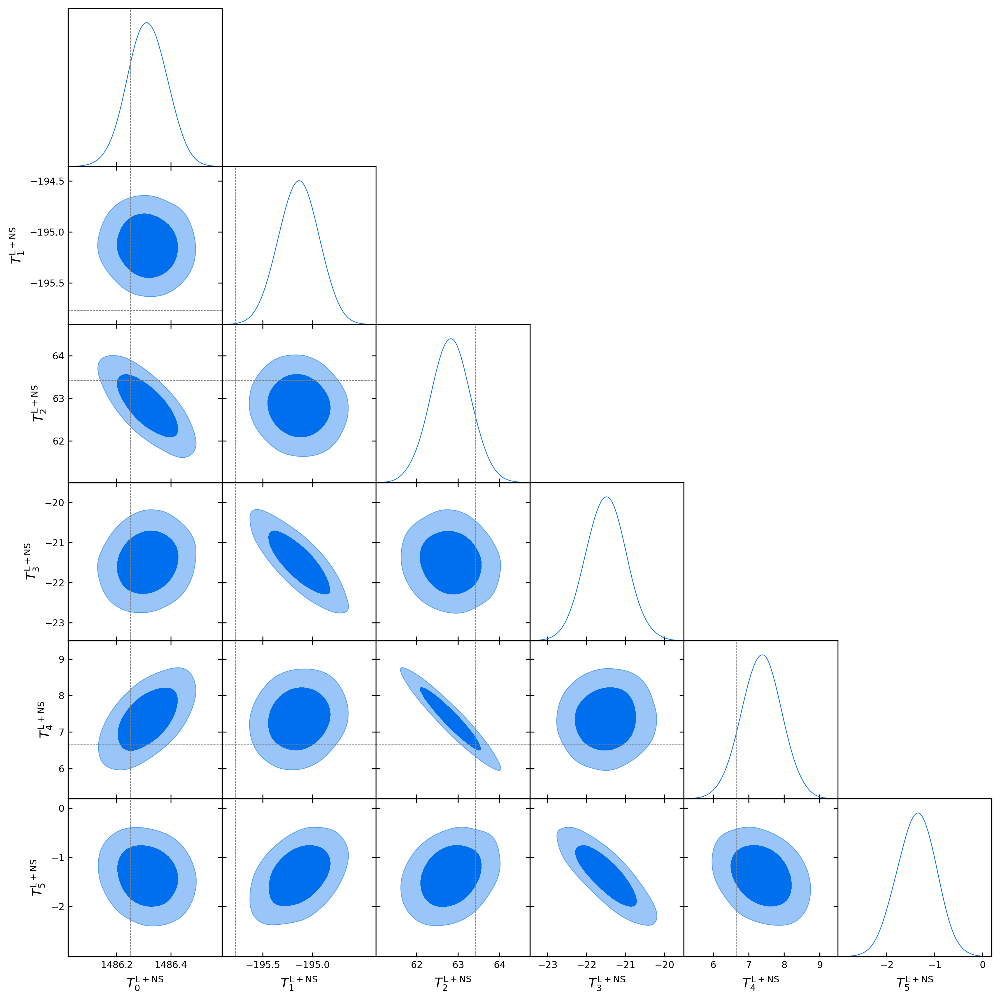

In [30]:
plot_tns_triangle(tuple(cal_runs.keys())[0])

In [44]:
mc =  new  #cal_runs[tuple(cal_runs.keys())[0]]
lk = precalmc.get_likelihood(**precalmc.get_kwargs(mc.root))

In [45]:
tns = mc.getMeans()[:6]

In [46]:
curves = lk.get_cal_curves(params=tns)

In [42]:
curves.keys()

dict_keys(['tunc', 'tcos', 'tsin', 'tload', 'tns', 'params'])

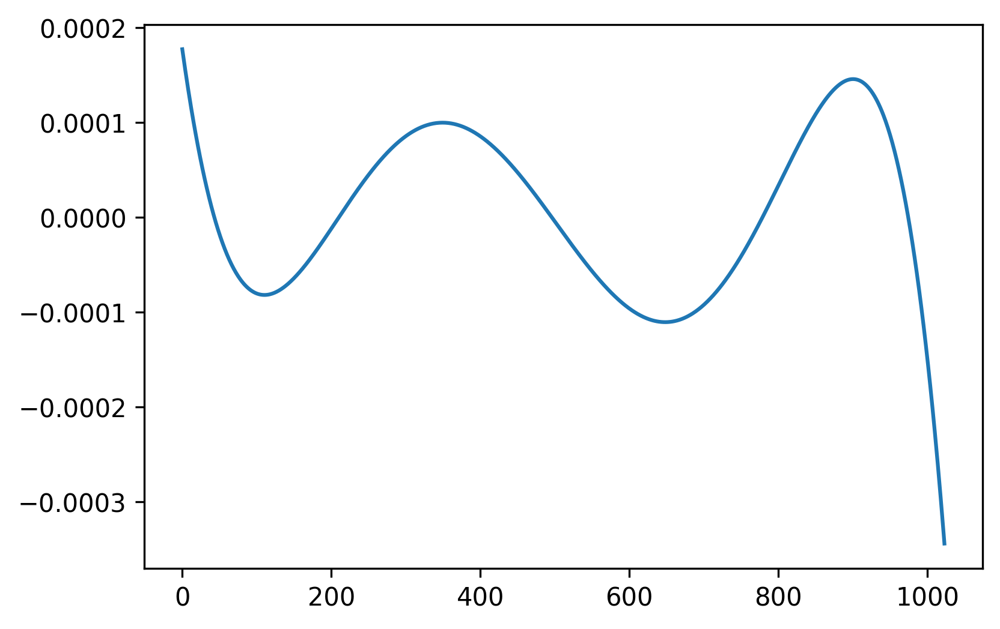

In [47]:
plt.plot((utils.calobs.C1()*utils.calobs.t_load_ns - curves['tns'])/(utils.calobs.C1()*utils.calobs.t_load_ns))

## Dependence on C/W terms

In [4]:
import run_alan_cal_mcmc as calmc

In [5]:
cal_runs = calmc.precal.get_completed_cal_runs(read=True)

In [6]:
cal_runs = {c:v for c,v in cal_runs.items() if 'smooth32' in c and 'c0' in c and 'antsim' in c}

In [7]:
labcal32 = utils.get_labcal(calobs32)

In [8]:
recal_temps = {name: calmc.precal.get_recalibrated_src_temp_best(mc, calobs32, labcal32) for name, mc in cal_runs.items()}

In [9]:
antsim32 = calobs32.new_load("AntSim1", io_obj = calobs32.metadata['io'])
loads = {**calobs32.loads, **{'AntSim1': antsim32}}

In [10]:
def evidence_plot(filt, xlabel, xcoord):
    fig, ax = plt.subplots(1, 1)
    twax = ax.twinx()

    aev = []
    sev = []
    eev = []
    for cr in cal_runs:
        kw = calmc.precal.get_kwargs(cr)
        if filt(kw):
            r = recal_temps[cr]['AntSim1']
            rms = np.sqrt(np.mean((r['cal_temp'] - antsim32.temp_ave)**2 / r['cal_var']))

            ev = mutl.get_evidence('alan_cal/'+str(cr))

            label= None
            if kw['antsim']:
                color = 'C4'
                if not aev:
                    label='S11 + AntSim'
                aev.append(ev)
            elif kw['s11_sys']:
                color = 'k'
                if not sev:
                    label="S11, No AntSim"
                sev.append(ev)
            else:
                color = 'C1'
                if not eev:
                    label='No S11 or Antsim'
                eev.append(ev)
                
            ax.scatter(kw[xcoord], ev, color=color, label=label)
            twax.scatter(kw[xcoord], rms, color=color, marker='*')


    ax.legend(bbox_to_anchor=(0.5, 1), loc='lower center', ncol=3, fontsize=10, handletextpad=0.4)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(r"$\log \mathcal{Z}$")
    twax.set_ylabel(r"$\sqrt{\bar{\chi}^2}$")

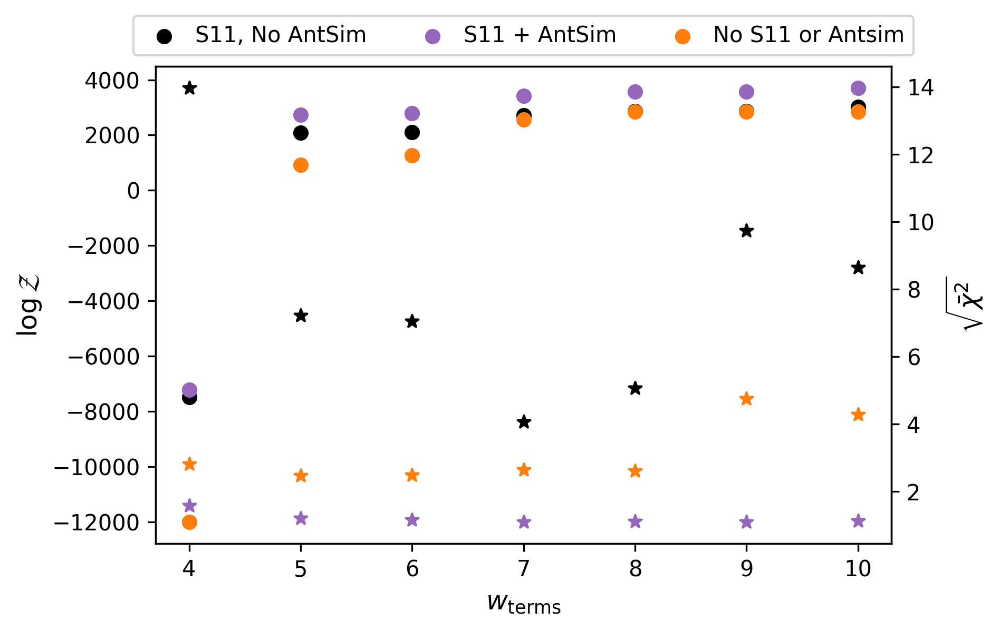

In [11]:
evidence_plot(lambda kw: kw.get('cterms', None) == 6, xlabel=r"$w_{\rm terms}$", xcoord='wterms')

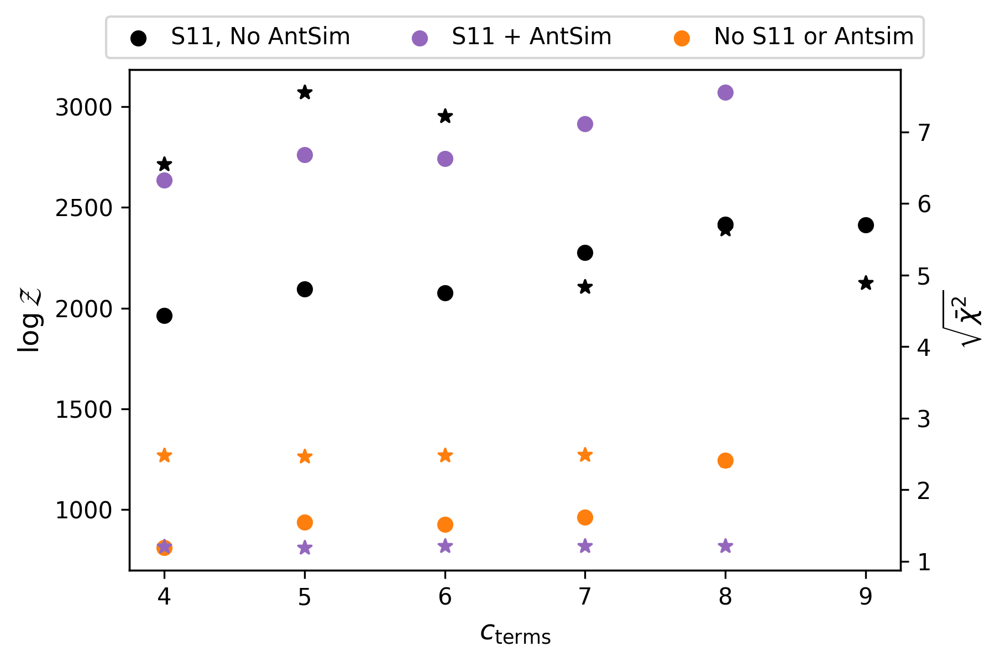

In [12]:
evidence_plot(lambda kw: kw.get('wterms', None) == 5, xlabel=r"$c_{\rm terms}$", xcoord='cterms')

In [12]:
def plot_recal_best(loads, recals, fig=None, ax=None, c='C0', label=None):
    if fig is None:
        fig, ax = plt.subplots(len(loads), 1, sharex=True)
        
    for i, load in enumerate(loads.values()):
        r = recals[load.load_name]['cal_temp']
        
        ax[i].plot(load.freq.freq.to_value("MHz"), r - load.temp_ave, color=c, label=label)
        ax[i].text(0.95, 0.8, load.load_name, transform=ax[i].transAxes, ha='right')
        ax[i].grid(True)
        
    fig.supylabel("Temp [K]")

In [13]:
sky_recals = dict(np.load("sky_recals_cal.npz", allow_pickle=True))

In [112]:
np.savez("sky_recals_cal.npz", **sky_recals)

In [17]:
try:
    sky_recals
except NameError:
    sky_recals = {}

def objfunc(f):
    return lambda x: -f(x)

use = 'map'
sky_recals[use] = {}
for name, run in cal_runs.items():
    kw = precal.get_kwargs(name)
    lk = precal.get_likelihood(**kw)
    
    n = len(lk.partial_linear_model.child_active_params)
    
    # Maximum likelihood NOT maximum a posteriori.
    if use == 'mc-ml':
        pbest = run.samples[np.argmax(-run.loglikes)][:n]
    elif use == 'mc-map':
        pbest = np.zeros((len(lk.partial_linear_model.child_active_params)))
        for i, s in enumerate(run.samples.T):
            kde = gaussian_kde(s, weights=run.weights)
            res = minimize(objfunc(kde.logpdf), x0=[s[np.argmax(-run.loglikes)]])
            pbest[i] = res.x[0]
    elif use == 'map':
        res = run_map(lk.partial_linear_model, x0=run.samples[np.argmax(-run.loglikes)][:n])
        pbest = res.x
    elif use == 'ml':
        res = run_map(lk.partial_linear_model, x0=run.samples[np.argmax(-run.loglikes)][:n], with_prior=False)
        pbest = res.x
    elif use == 'mean':
        pbest = run.getMeans()[:len(lk.partial_linear_model.child_active_params)]
    
    print(name, pbest)
    a, b = lk.get_linear_coefficients(
        freq=adata.sky_freq, labcal=labcal32, params=pbest
    )
    
    sky_recals[use][name] = utils.recalibrate(labcal32, f_sky=adata.sky_data['freq'], t_sky=adata.sky_data['t_ant'], a=a,b=b)

c04_w05_smooth32_tns0500_ign[()]_sim[()]_s11('short', 'open')_antsim-False [ 1.48516878e+03 -1.94740902e+02  6.81821276e+01 -2.11750525e+01
  1.00017770e+00  4.43181531e-04  9.99657588e-01  4.67865971e-04]
c04_w05_smooth32_tns0500_ign[()]_sim[()]_s11('short', 'open')_antsim-True [ 1.48533024e+03 -1.94285190e+02  6.76470375e+01 -2.13659878e+01
  1.00274467e+00  1.04863793e-04  1.00222692e+00  1.32293864e-04]
c04_w05_smooth32_tns0500_ign[()]_sim[()]_s11()_antsim-False [1485.19430417 -194.62653753   68.25264586  -21.35574238]
c05_w05_smooth32_tns0500_ign[()]_sim[()]_s11('short', 'open')_antsim-False [ 1.48570039e+03 -1.94241877e+02  6.26786930e+01 -2.21270005e+01
  6.73063211e+00  1.00016886e+00  5.05721528e-04  9.99647948e-01
  5.29334526e-04]
c05_w05_smooth32_tns0500_ign[()]_sim[()]_s11('short', 'open')_antsim-True [ 1.48586637e+03 -1.93616441e+02  6.17937458e+01 -2.25656940e+01
  7.12704751e+00  1.00273023e+00  1.05896279e-04  1.00221105e+00
  1.32697854e-04]
c05_w05_smooth32_tns0500_i

In [22]:
cal_lk_res['ML (s11,cbl) (32ch)']

      fun: -2116.213630255388
 hess_inv: <10x10 LbfgsInvHessProduct with dtype=float64>
      jac: array([  23.49113233,    4.76556656,    9.61504077,    4.01487308,
          1.29357432,  -16.60509962, -172.66425053,  190.09239622,
        895.63208808,  224.50994948])
  message: 'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 253
      nit: 12
     njev: 23
   status: 0
  success: True
        x: array([ 1.48571190e+03, -1.94834449e+02,  6.28524581e+01, -1.86550831e+01,
        6.63524430e+00, -3.42230044e+00,  1.00025353e+00,  3.90024767e-04,
        9.99734900e-01,  4.13109708e-04])

In [32]:
from scipy.stats import lognorm

In [49]:
ln = lognorm(s=0.0005)

In [50]:
x = np.linspace(0.99, 1.01, 100)

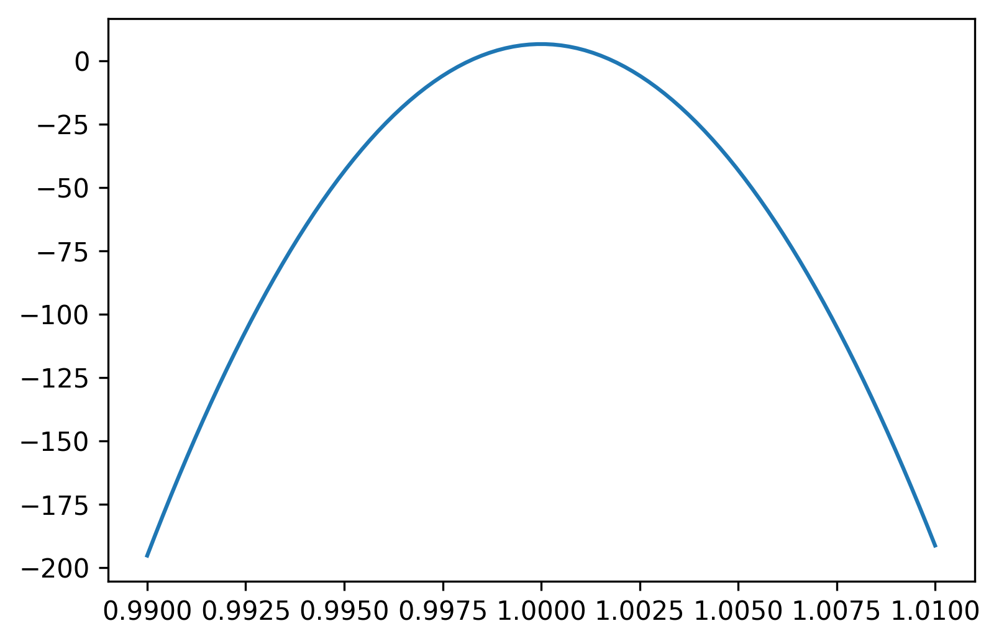

In [51]:
plt.plot(x, ln.logpdf(x))
#plt.xscale('log')

In [37]:
ln.logpdf(1) - ln.logpdf(0.95)

210.42887063584666

In [18]:
def residual_plot(filt, use='mean'):
    
    fig, ax = plt.subplots(len(loads)+1, 1, sharex=True)
    linlog5 = mdl.LinLog(n_terms=5)
    n = 0
    for i, (name, rc) in enumerate(recal_temps.items()):
        kw = precal.get_kwargs(name)
        if filt(kw):
            plot_recal_best(loads, rc, c=f'C{n}', label=name[:7].replace('_', ' '), fig=fig, ax=ax)

            n += 1

            slf = SemiLinearFit(
                fg=linlog5.at(x=adata.sky_freq), 
                eor=utils.make_absorption(adata.sky_freq), # fix=('tau',) 
                spectrum=sky_recals[use][name], 
                sigma=0.03
            )
            res = slf()
            if not res.success:
                print(i, "was not successful")

            ax[-1].plot(
                adata.sky_freq, 
                slf.get_eor(res.x), 
            )

    ax[0].legend(bbox_to_anchor=(1.1, 1.))
    return fig, ax

Text(0.5, 0.98, 'Without AntSim')

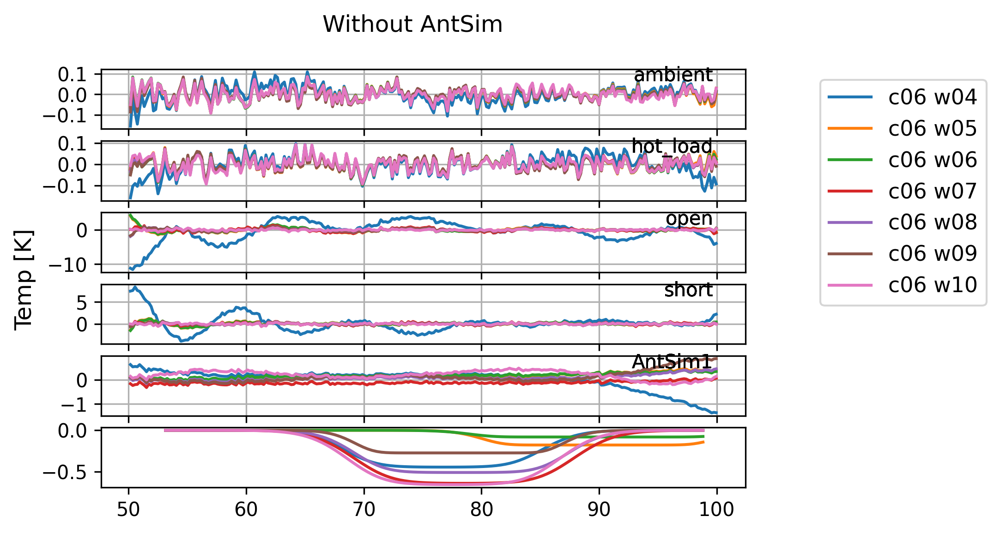

In [36]:
fig, ax = residual_plot(lambda kw: kw['cterms'] == 6 and not kw['antsim'] and kw['s11_sys'] and kw['smooth'] == 32, use='map')
fig.suptitle("Without AntSim")

In [110]:
kw = cal_mcmc.precal.get_kwargs('c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False')
lk = cal_mcmc.precal.get_likelihood(**kw)

In [111]:
res = run_map(lk.partial_linear_model, x0=cal_lk_res['ML (s11,cbl) (32ch)'].x, options={'eps': 1e-12})

In [112]:
res

      fun: -2092.3426344289596
 hess_inv: <10x10 LbfgsInvHessProduct with dtype=float64>
      jac: array([  271.        ,  1128.22857143,   761.64539007,  1045.86476868,
        1582.8348135 ,   467.89342806,  -163.69449378,  3388.77727235,
         316.51115799, -2848.99216469])
  message: 'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 418
      nit: 21
     njev: 38
   status: 0
  success: True
        x: array([ 1.48569847e+03, -1.94835055e+02,  6.28505155e+01, -1.86454656e+01,
        6.62130231e+00, -3.39980456e+00,  1.00023010e+00,  3.95853809e-04,
        9.99711586e-01,  4.18881813e-04])

In [113]:
res.x - cal_lk_res['ML (s11,cbl) (32ch)'].x

array([-2.10631993e-06, -5.84297041e-06,  5.77328713e-07,  7.43195022e-06,
        3.10957429e-06, -8.61618600e-06, -2.42423192e-05,  3.41006494e-05,
       -2.37175850e-05,  3.37048931e-05])

In [114]:
resorig = run_map(lk.partial_linear_model)

In [115]:
run = cal_runs['c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False']
resorig2 = run_map(lk.partial_linear_model, x0=run.samples[np.argmax(-run.loglikes)][:10])

In [116]:
resorig2

      fun: -2122.641742728378
 hess_inv: <10x10 LbfgsInvHessProduct with dtype=float64>
      jac: array([ 2.37830832e+00,  1.08802765e+01,  1.20166978e+01,  9.20690505e+00,
        1.23490737e+01,  8.51732694e+00,  1.32165929e+03, -7.11174989e+03,
       -1.41769319e+03,  8.02692807e+03])
  message: 'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 451
      nit: 17
     njev: 41
   status: 0
  success: True
        x: array([ 1.48569846e+03, -1.94009063e+02,  6.22494642e+01, -2.22629328e+01,
        7.52783422e+00, -2.49462709e-01,  1.00013817e+00,  5.24280143e-04,
        9.99617310e-01,  5.47131275e-04])

In [127]:
resnew = run_map(cal_lks['ML (s11,cbl) (32ch)'].partial_linear_model, x0=resorig2.x, options={'eps': 1e-12})

In [128]:
resnew

      fun: -2116.7706592056616
 hess_inv: <10x10 LbfgsInvHessProduct with dtype=float64>
      jac: array([ -498.5       ,   -53.94285714,  1060.31205674,  -241.42348754,
         618.40142096,    70.03264128,   544.73889876, -1157.78675998,
         442.0242034 ,  1893.56797666])
  message: 'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 253
      nit: 3
     njev: 23
   status: 0
  success: True
        x: array([ 1.48569038e+03, -1.94017151e+02,  6.22505490e+01, -2.22709486e+01,
        7.51974499e+00, -2.57588766e-01,  1.00013801e+00,  5.24297426e-04,
        9.99617154e-01,  5.47104083e-04])

In [117]:
(resorig2.x - cal_lk_res['ML (s11,cbl) (32ch)'].x)/cal_lk_res['ML (s11,cbl) (32ch)'].x

array([-7.20800959e-09, -4.23941412e-03, -9.56318022e-03,  1.94012765e-01,
        1.36911955e-01, -9.26624211e-01, -1.16140424e-04,  4.49275918e-01,
       -1.18024970e-04,  4.20467443e-01])

In [118]:
res2 = run_map(cal_lks['ML (s11,cbl) (32ch)'].partial_linear_model)

In [119]:
cal_lks['ML (s11,cbl) (32ch)'].partial_linear_model.logl(params=cal_lk_res['ML (s11,cbl) (32ch)'].x), cal_lks['ML (s11,cbl) (32ch)'].partial_linear_model.logp(params=cal_lk_res['ML (s11,cbl) (32ch)'].x) 

(2111.8505896516126, 2086.0521499994325)

In [120]:
lk.partial_linear_model.logl(params=cal_lk_res['ML (s11,cbl) (32ch)'].x), lk.partial_linear_model.logp(params=cal_lk_res['ML (s11,cbl) (32ch)'].x) 

(2111.8505896516126, 2092.2516557194826)

In [121]:
cal_lks['ML (s11,cbl) (32ch)'].partial_linear_model.logl(params=res.x), cal_lks['ML (s11,cbl) (32ch)'].partial_linear_model.logp(params=res.x) 

(2111.9453473091007, 2086.1469076569206)

In [122]:
 for p, v in zip(cal_lks['ML (s11,cbl) (32ch)'].partial_linear_model.child_active_params, resorig2.x):
        print(p.name, p.min, p.max, v,  p.prior.logpdf(v))

t_lns_0 985.6792188425802 1985.6792188425802 1485.6984587933678 -6.907755278982137
t_lns_1 -694.8354187831087 305.1645812168913 -194.00906300870028 -6.907755278982137
t_lns_2 -437.15068149899815 562.8493185010018 62.24946415062799 -6.907755278982137
t_lns_3 -518.6395529550045 481.36044704499545 -22.262932790263672 -6.907755278982137
t_lns_4 -493.39743895441546 506.60256104558454 7.527834222563002 -6.907755278982137
t_lns_5 -503.45498399200585 496.54501600799415 -0.24946270893828926 -6.907755278982137
open_scale 0.99 1.01 1.0001381734524755 3.912023005428145
open_delay -0.01 0.01 0.0005242801428162661 3.912023005428146
scale 0.99 1.01 0.9996173099183122 3.912023005428145
delay -0.01 0.01 0.000547131275222775 3.912023005428146


In [123]:
cal_lks['ML (s11,cbl) (32ch)'].partial_linear_model.logl(params=resorig2.x), cal_lks['ML (s11,cbl) (32ch)'].partial_linear_model.logp(params=resorig2.x) 

(2142.3080227879227, 2116.5095831357426)

In [129]:
cal_lks['ML (s11,cbl) (32ch)'].partial_linear_model.logl(params=resnew.x), cal_lks['ML (s11,cbl) (32ch)'].partial_linear_model.logp(params=resnew.x) 

(2142.5690988578417, 2116.7706592056616)

In [124]:
lk.partial_linear_model.logl(params=res.x), lk.partial_linear_model.logp(params=res.x) 

(2111.9453473091007, 2092.3426344289596)

In [125]:
lk.partial_linear_model.logl(params=resorig.x), lk.partial_linear_model.logp(params=resorig.x) 

(2111.039528225937, 2091.4076587465506)

In [126]:
lk.partial_linear_model.logl(params=resorig2.x), lk.partial_linear_model.logp(params=resorig2.x) 

(2142.3080227879227, 2122.641742728378)

In [56]:
for name, m, s in zip(
    [n.name for n in cal_runs['c06_w07_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'].paramNames.names],
    cal_runs['c06_w07_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'].getMeans(),
    np.sqrt(cal_runs['c06_w07_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'].getVars())
):
    print(f"{name:>15}: {m:1.3e} | {s:1.3e}")

        t_lns_0: 1.486e+03 | 7.329e-02
        t_lns_1: -1.949e+02 | 2.949e-01
        t_lns_2: 6.278e+01 | 4.885e-01
        t_lns_3: -1.832e+01 | 1.181e+00
        t_lns_4: 6.691e+00 | 5.715e-01
        t_lns_5: -3.758e+00 | 1.065e+00
 log_open_scale: 1.001e+00 | 2.331e-03
     open_delay: 5.403e-04 | 9.247e-05
log_short_scale: 1.001e+00 | 2.332e-03
    short_delay: 5.911e-04 | 9.204e-05
   logdet_cinv_: 2.535e+02 | 1.304e-01
    logdet_sig_: -7.427e+03 | 5.628e-02
           rms_: 1.641e+03 | 4.321e+00
      tunchat_0: 1.841e+02 | 5.214e-01
      tunchat_1: -2.856e+00 | 3.453e-02
      tunchat_2: 1.707e+00 | 5.604e-02
      tunchat_3: -7.846e-01 | 1.256e-01
      tunchat_4: -1.160e+00 | 8.714e-02
      tunchat_5: 2.716e-01 | 1.120e-01
      tunchat_6: 1.095e+00 | 4.410e-02
      tcoshat_0: -9.117e+00 | 4.474e-02
      tcoshat_1: -3.299e+00 | 8.127e-02
      tcoshat_2: -8.261e+00 | 1.267e-01
      tcoshat_3: 5.314e+00 | 1.079e-01
      tcoshat_4: -4.805e-01 | 4.201e-01
      tcoshat_

In [48]:
for name, m, s in zip(
    [n.name for n in cal_runs['c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'].paramNames.names],
    cal_runs['c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'].getMeans(),
    np.sqrt(cal_runs['c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'].getVars())
):
    print(f"{name:>15}: {m:1.3e} | {s:1.3e}")

        t_lns_0: 1.486e+03 | 7.100e-02
        t_lns_1: -1.940e+02 | 1.923e-01
        t_lns_2: 6.261e+01 | 4.656e-01
        t_lns_3: -2.228e+01 | 5.023e-01
        t_lns_4: 6.872e+00 | 5.387e-01
        t_lns_5: -2.150e-01 | 3.987e-01
 log_open_scale: 9.975e-01 | 1.923e-03
     open_delay: 5.302e-04 | 8.901e-05
log_short_scale: 9.970e-01 | 1.922e-03
    short_delay: 5.530e-04 | 8.838e-05
   logdet_cinv_: 2.210e+02 | 7.710e-02
    logdet_sig_: -7.427e+03 | 5.422e-02
           rms_: 2.921e+03 | 4.764e+00
      tunchat_0: 1.832e+02 | 4.348e-01
      tunchat_1: -2.972e+00 | 2.197e-02
      tunchat_2: 1.281e+00 | 5.002e-02
      tunchat_3: -4.332e-01 | 2.937e-02
      tunchat_4: 2.661e-01 | 5.667e-02
      tcoshat_0: -9.198e+00 | 4.106e-02
      tcoshat_1: -3.273e+00 | 8.193e-02
      tcoshat_2: -7.586e+00 | 1.702e-02
      tcoshat_3: 4.598e+00 | 1.880e-02
      tcoshat_4: -2.598e+00 | 1.020e-02
      tsinhat_0: 1.101e+01 | 6.209e-02
      tsinhat_1: 9.029e+00 | 5.372e-02
      tsinhat_2

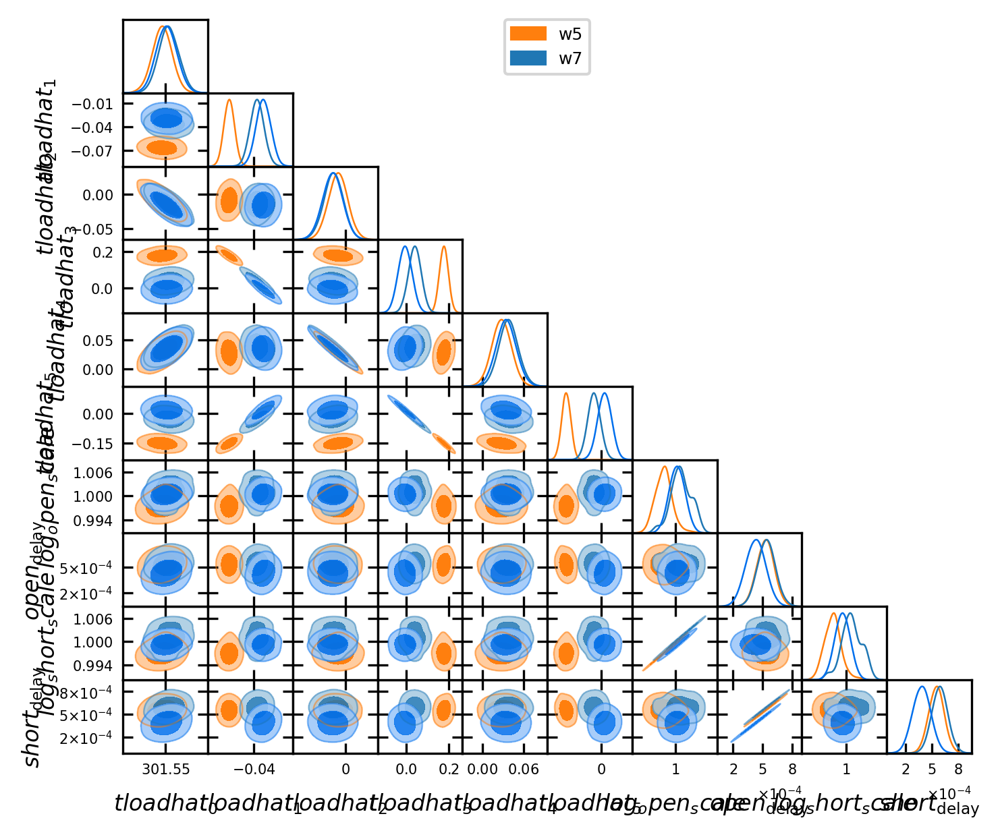

In [37]:
g = plots.get_subplot_plotter(width_inch=5, subplot_size_ratio=0.85)
g.triangle_plot(
    [
        cal_runs['c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'], 
#        done['alan_data_fg5_simul_tau-fixed'],
        cal_runs['c06_w07_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'], 
        cal_runs['c06_w08_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'], 
#        done['alan_data_fg10_simul_tau-fixed_iterative_recal'],
    ], 
    legend_labels=[
        r"w5",
        r"w7",
#        r"Simultaneous $N_{\rm FG}=7$",
#        r"Simultaneous $N_{\rm FG}=10$",
    ],
    contour_colors=['C1', 'C0'],
    filled=True, 
    params=['tloadhat_0',
             'tloadhat_1',
             'tloadhat_2',
             'tloadhat_3',
             'tloadhat_4',
             'tloadhat_5',
             'log_open_scale',
             'open_delay',
             'log_short_scale',
             'short_delay'],
)
#g.export("triangle_fg10_iso_vs_simul.png")

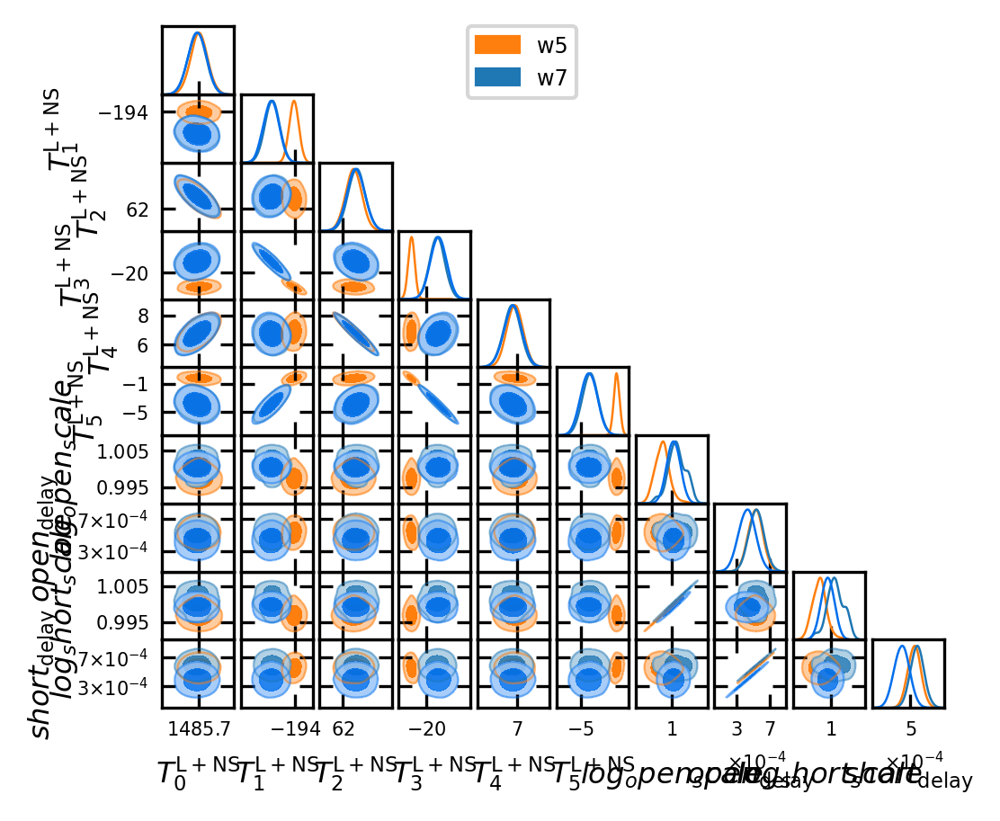

In [38]:
g = plots.get_subplot_plotter(width_inch=3.7, subplot_size_ratio=0.85)
g.triangle_plot(
    [
        cal_runs['c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'], 
#        done['alan_data_fg5_simul_tau-fixed'],
        cal_runs['c06_w07_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'], 
        cal_runs['c06_w08_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'], 
#        done['alan_data_fg10_simul_tau-fixed_iterative_recal'],
    ], 
    legend_labels=[
        r"w5",
        r"w7",
#        r"Simultaneous $N_{\rm FG}=7$",
#        r"Simultaneous $N_{\rm FG}=10$",
    ],
    contour_colors=['C1', 'C0'],
    filled=True, 
    params=['t_lns_0',
             't_lns_1',
             't_lns_2',
             't_lns_3',
             't_lns_4',
             't_lns_5',
             'log_open_scale',
             'open_delay',
             'log_short_scale',
             'short_delay'],
)

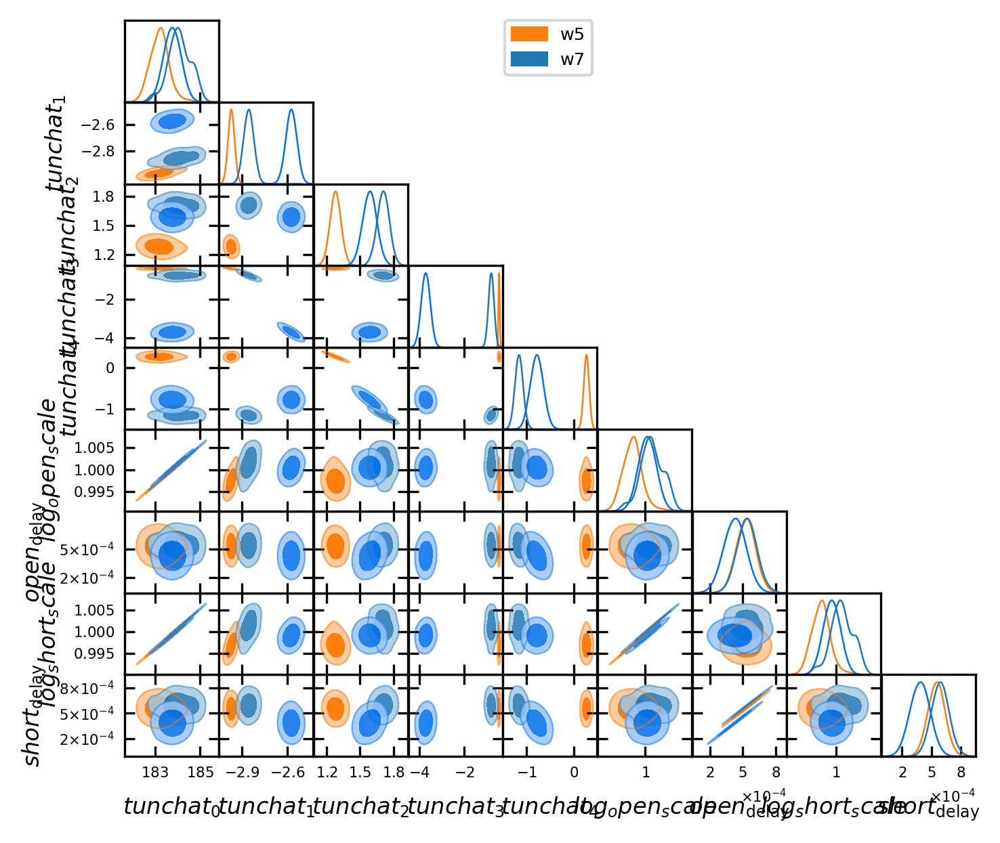

In [39]:
g = plots.get_subplot_plotter(width_inch=5, subplot_size_ratio=0.85)
g.triangle_plot(
    [
        cal_runs['c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'], 
#        done['alan_data_fg5_simul_tau-fixed'],
        cal_runs['c06_w07_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'], 
        cal_runs['c06_w08_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'], 
#        done['alan_data_fg10_simul_tau-fixed_iterative_recal'],
    ], 
    legend_labels=[
        r"w5",
        r"w7",
#        r"Simultaneous $N_{\rm FG}=7$",
#        r"Simultaneous $N_{\rm FG}=10$",
    ],
    contour_colors=['C1', 'C0'],
    filled=True, 
    params=['tunchat_0',
             'tunchat_1',
             'tunchat_2',
             'tunchat_3',
             'tunchat_4',
             # 'tunchat_6',
             'log_open_scale',
             'open_delay',
             'log_short_scale',
             'short_delay'],
)

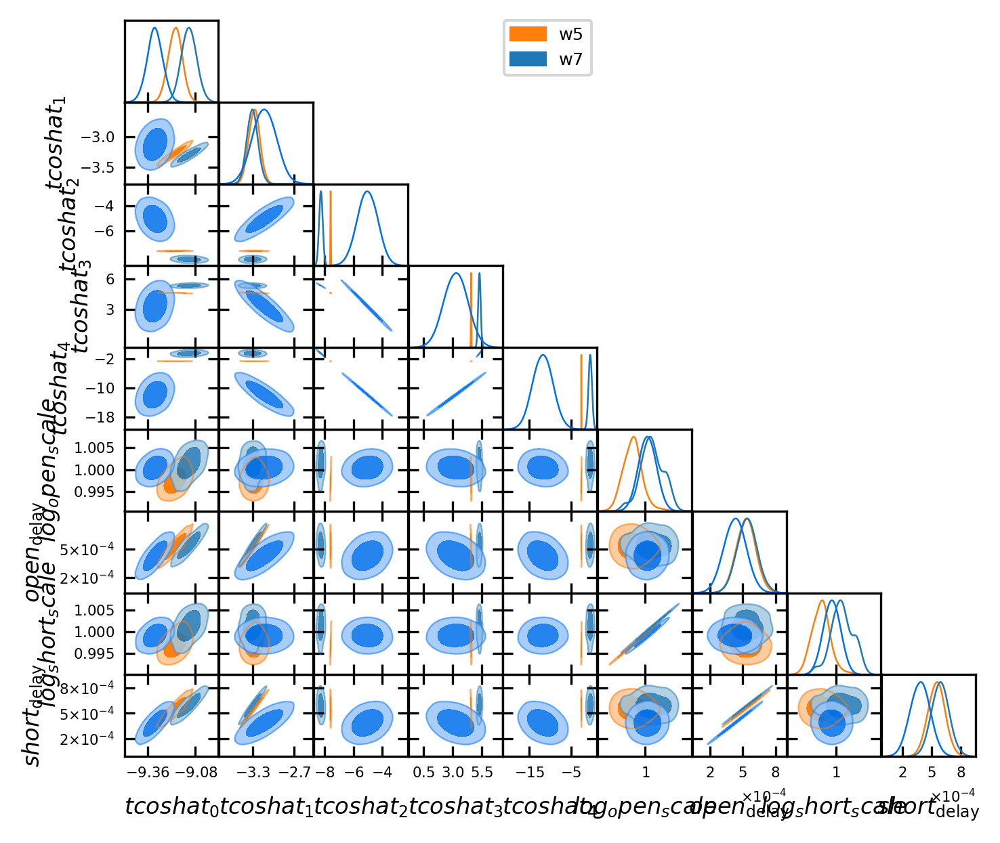

In [40]:
g = plots.get_subplot_plotter(width_inch=5, subplot_size_ratio=0.85)
g.triangle_plot(
    [
        cal_runs['c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'], 
#        done['alan_data_fg5_simul_tau-fixed'],
        cal_runs['c06_w07_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'],
        cal_runs['c06_w08_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'],
#        done['alan_data_fg10_simul_tau-fixed_iterative_recal'],
    ], 
    legend_labels=[
        r"w5",
        r"w7",
#        r"Simultaneous $N_{\rm FG}=7$",
#        r"Simultaneous $N_{\rm FG}=10$",
    ],
    contour_colors=['C1', 'C0'],
    filled=True, 
    params=['tcoshat_0',
             'tcoshat_1',
             'tcoshat_2',
             'tcoshat_3',
             'tcoshat_4',
             # 'tunchat_6',
             'log_open_scale',
             'open_delay',
             'log_short_scale',
             'short_delay'],
)

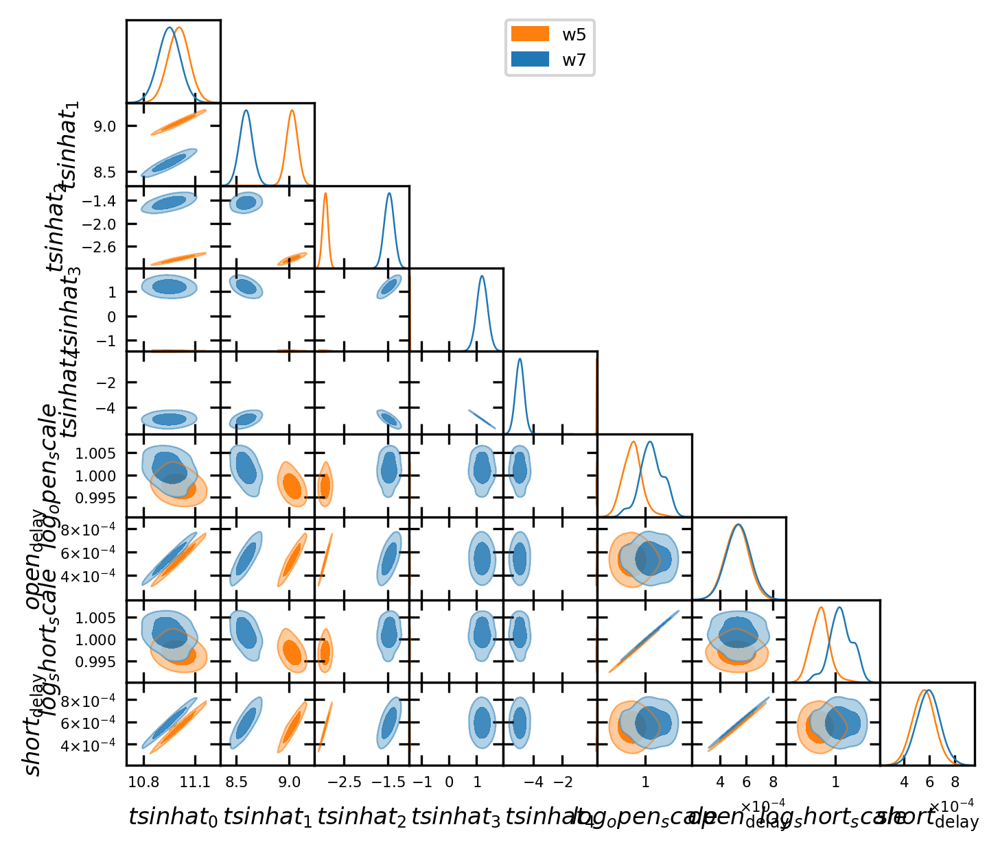

In [35]:
g = plots.get_subplot_plotter(width_inch=5, subplot_size_ratio=0.85)
g.triangle_plot(
    [
        cal_runs['c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'], 
#        done['alan_data_fg5_simul_tau-fixed'],
        cal_runs['c06_w07_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False'], 
#        done['alan_data_fg10_simul_tau-fixed_iterative_recal'],
    ], 
    legend_labels=[
        r"w5",
        r"w7",
#        r"Simultaneous $N_{\rm FG}=7$",
#        r"Simultaneous $N_{\rm FG}=10$",
    ],
    contour_colors=['C1', 'C0'],
    filled=True, 
    params=['tsinhat_0',
             'tsinhat_1',
             'tsinhat_2',
             'tsinhat_3',
             'tsinhat_4',
             # 'tunchat_6',
             'log_open_scale',
             'open_delay',
             'log_short_scale',
             'short_delay'],
)

In [25]:
def65_cr = cal_runs["c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11(\'short\', \'open\')_antsim-False"]

def65_kw= cal_mcmc.precal.get_kwargs(Path(def65_cr.root).name)
def65 = cal_mcmc.precal.get_likelihood(**def65_kw)

TypeError: get_likelihood() got an unexpected keyword argument 's11_unif_prior'

In [65]:
def65_kw

{'tns_width': 500,
 'ignore_sources': (),
 's11_sys': ('short', 'open'),
 'antsim': False,
 'cterms': 6,
 'wterms': 5,
 'smooth': 32,
 'as_sim': ()}

In [56]:
def65_res = run_map(def65.partial_linear_model)

In [57]:
def65_res.x

array([ 1.48567922e+03, -1.94835419e+02,  6.28493185e+01, -1.86395530e+01,
        6.60256115e+00, -3.45498360e+00,  1.00031733e+00,  3.83098930e-04,
        9.99798547e-01,  4.06234324e-04])

In [60]:
pbest = def65_cr.samples[np.argmax(-def65_cr.loglikes)][:10]
pworst = def65_cr.samples[np.argmax(def65_cr.loglikes)][:10]

In [61]:
pbest

array([ 1.48569846e+03, -1.94009060e+02,  6.22494675e+01, -2.22629303e+01,
        7.52783759e+00, -2.49460542e-01,  9.89512100e-01,  5.68779766e-04,
        9.88997046e-01,  5.91392729e-04])

In [62]:
-def65_cr.loglikes.min() / 2

2149.70235

In [63]:
(
    def65.partial_linear_model(params=pbest, with_prior=False)[0], 
    def65.partial_linear_model(params=pworst, with_prior=False)[0], 
    def65.partial_linear_model(params=def65_res.x, with_prior=False)[0]
)

(2149.6884802451023, 2059.852728932288, 2110.943337316194)

In [66]:
(
    def65.partial_linear_model(params=pbest, with_prior=True)[0], 
    def65.partial_linear_model(params=pworst, with_prior=True)[0], 
    def65.partial_linear_model(params=def65_res.x, with_prior=True)[0]
)

(2103.8763396890663, 2030.328164962911, 2083.783966488717)

In [38]:
uwsamples = np.genfromtxt("alan_cal/c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11('short', 'open')_antsim-False_equal_weights.txt")

In [41]:
samples = np.genfromtxt("alan_cal/c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11('short', 'open')_antsim-False.txt")

In [43]:
def65_cr.root

"alan_cal/c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11('short', 'open')_antsim-False"

In [42]:
samples.shape

(26274, 37)

In [39]:
uwsamples.shape

(2013, 43)

In [44]:
len(def65.partial_linear_model.child_active_params)

10

In [67]:
out = def65.partial_linear_model()[1]

In [68]:
p0 = def65_cr.samples[0][:10]

In [69]:
p0

array([ 1.48580409e+03, -1.93423268e+02,  6.31182981e+01, -2.18671720e+01,
        6.01803033e+00, -4.75759338e-01,  1.00505576e+00,  6.31141585e-04,
        1.00450865e+00,  6.67735823e-04])

In [70]:
out = def65.partial_linear_model(params=p0)[1]

In [72]:
out

[221.27104463968962,
 -7426.378932587902,
 3084.530757221206,
 (184.8793583024605,
  -2.9954692808928103,
  1.186535613674181,
  -0.44960106319077636,
  0.3624995377820294),
 (-9.08195980329033,
  -3.139526005037015,
  -7.548817974452247,
  4.531547925296572,
  -2.558521735686358),
 (11.039445203005554,
  9.011521955825566,
  -2.817699130202364,
  -1.432507032082583,
  0.401646540266632),
 (301.5489004057674,
  -0.08954635568862686,
  -0.029603756149994026,
  0.20795811357814833,
  0.057697143319855704,
  -0.1810083131685612),
 [3084.530757221206, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]]

In [49]:
out

[223.68235420461747,
 -9233.782690267244,
 6346.536362673446,
 (184.9329597814628,
  -2.9810865704870806,
  1.180783820743435,
  -0.5507682006686869,
  0.3363240658177083),
 (-9.08918595041781,
  -3.1474397688028124,
  -7.515468302903175,
  4.532829876656582,
  -2.5777802723996452),
 (11.036932776453153,
  9.0283260558462,
  -2.812168921656736,
  -1.4547978405787207,
  0.3940149534103427),
 (301.59613857047333,
  -0.059325902639165436,
  -0.01097715929617927,
  0.02143592712544427,
  0.004986581417024952,
  -0.09126114707080211),
 [6346.536362673446, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]]

In [46]:
out

[223.4930404886885,
 -9234.00704631805,
 6461.987618810126,
 (183.82108440798427,
  -2.983663404485659,
  1.2056832119871785,
  -0.40967131529198536,
  0.3753236910314756),
 (-9.412491134279716,
  -3.7199202589249585,
  -7.321213103206783,
  4.603491025468696,
  -2.7955970002532537),
 (10.615473806226468,
  8.755336213271901,
  -3.3460066131273742,
  -1.5554568955536765,
  0.3425750770024568),
 (301.51340358281396,
  -0.10845172069263184,
  0.017000056021617756,
  0.2801750379647338,
  0.058122849109052306,
  -0.22914460512156462),
 [6461.987618810126, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]]

In [40]:
def65_cr.samples.shape

(26274, 35)

In [104]:
nos11_cr = cal_runs['c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11()_antsim-False']

In [105]:
nos11 = cal_mcmc.precal.get_likelihood(**cal_mcmc.precal.get_kwargs('c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11()_antsim-False'))

In [110]:
nos11_cr.loglikes[-1]

-1944.74203

In [107]:
nos11_cr.samples[-1][:6]

array([ 1.48626656e+03, -1.92704964e+02,  5.93658258e+01, -2.42694374e+01,
        9.44878206e+00,  8.23238367e-01])

In [111]:
-2*nos11.partial_linear_model(nos11_cr.samples[-1][:6], with_prior=False)[0]

-1944.729788511635

{'tns_width': 500, 'ignore_sources': (), 's11_sys': (), 'antsim': False, 'cterms': 6, 'wterms': 4, 'smooth': 32, 'as_sim': ()} c06_w04_smooth32_tns0500_ign[()]_sim[()]_s11()_antsim-False
{'tns_width': 500, 'ignore_sources': (), 's11_sys': (), 'antsim': False, 'cterms': 6, 'wterms': 5, 'smooth': 32, 'as_sim': ()} c06_w05_smooth32_tns0500_ign[()]_sim[()]_s11()_antsim-False
{'tns_width': 500, 'ignore_sources': (), 's11_sys': (), 'antsim': False, 'cterms': 6, 'wterms': 6, 'smooth': 32, 'as_sim': ()} c06_w06_smooth32_tns0500_ign[()]_sim[()]_s11()_antsim-False
{'tns_width': 500, 'ignore_sources': (), 's11_sys': (), 'antsim': False, 'cterms': 6, 'wterms': 7, 'smooth': 32, 'as_sim': ()} c06_w07_smooth32_tns0500_ign[()]_sim[()]_s11()_antsim-False
17 was not successful
{'tns_width': 500, 'ignore_sources': (), 's11_sys': (), 'antsim': False, 'cterms': 6, 'wterms': 8, 'smooth': 32, 'as_sim': ()} c06_w08_smooth32_tns0500_ign[()]_sim[()]_s11()_antsim-False
{'tns_width': 500, 'ignore_sources': (), 's

Text(0.5, 0.98, 'Without AntSim or S11')

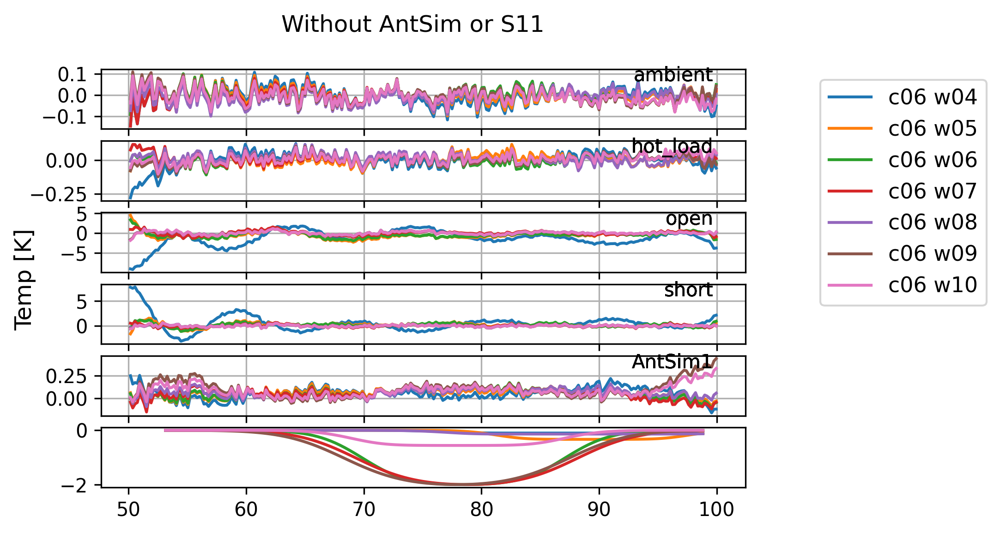

In [63]:
fig, ax = residual_plot(lambda kw: kw['cterms'] == 6 and not kw['s11_sys'])
fig.suptitle("Without AntSim or S11")

Text(0.5, 0.98, 'With AntSim')

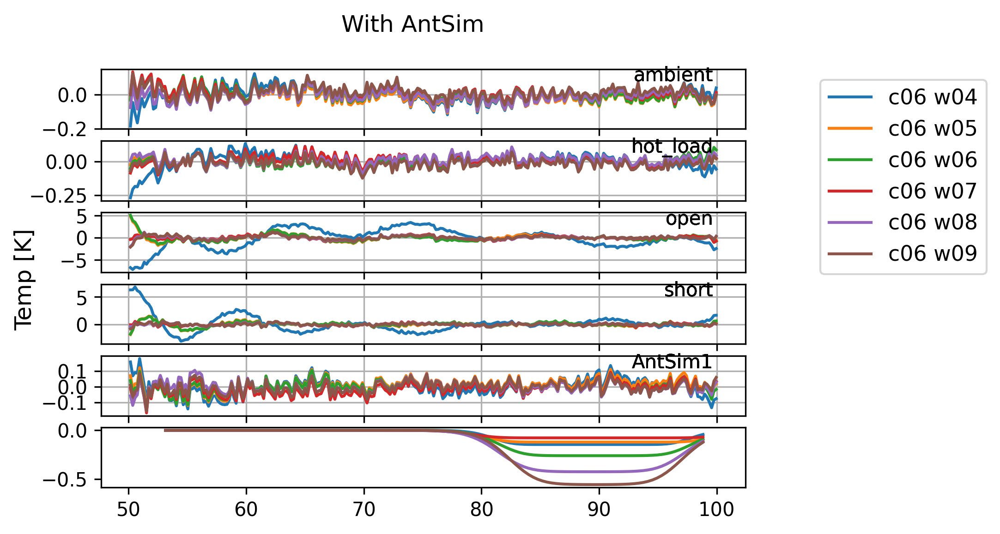

In [26]:


fig, ax = plt.subplots(len(loads)+1, 1, sharex=True)
linlog5 = mdl.LinLog(n_terms=5)
n = 0
for i, (name, rc) in enumerate(recal_temps.items()):
    kw = precal.get_kwargs(name)
    if kw['cterms'] == 6 and kw['antsim']:
        plot_recal_best(loads, rc, c=f'C{n}', label=name[:7].replace('_', ' '), fig=fig, ax=ax)
        n += 1
        
        slf = SemiLinearFit(
            fg=linlog5.at(x=adata.sky_freq), 
            eor=utils.make_absorption(adata.sky_freq), # fix=('tau',) 
            spectrum=sky_recals[name], 
            sigma=0.03
        )
        res = slf()
        if not res.success:
            print(i, "was not successful")
        
        ax[-1].plot(
            adata.sky_freq, 
            slf.get_eor(res.x), 
        )


ax[0].legend(bbox_to_anchor=(1.1, 1.))
fig.suptitle("With AntSim")

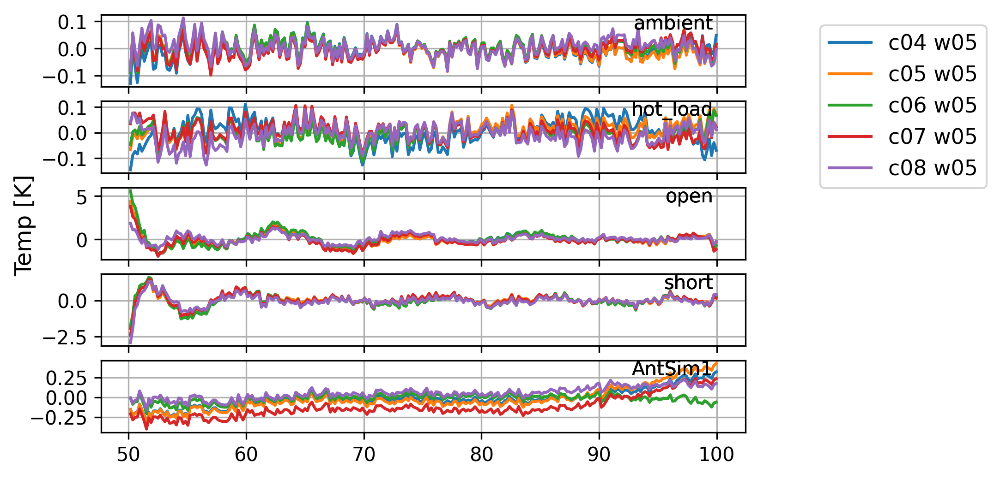

In [19]:
loads = {**calobs32.loads, **{'AntSim1': antsim32}}

fig, ax = plt.subplots(len(loads), 1, sharex=True)

n = 0
for i, (name, rc) in enumerate(recal_temps.items()):
    kw = precal.get_kwargs(name)
    if kw['wterms'] == 5 and not kw['antsim']:
        plot_recal_best(loads, rc, c=f'C{n}', label=name[:7].replace('_', ' '), fig=fig, ax=ax)
        n += 1
        
ax[0].legend(bbox_to_anchor=(1.1, 1.))

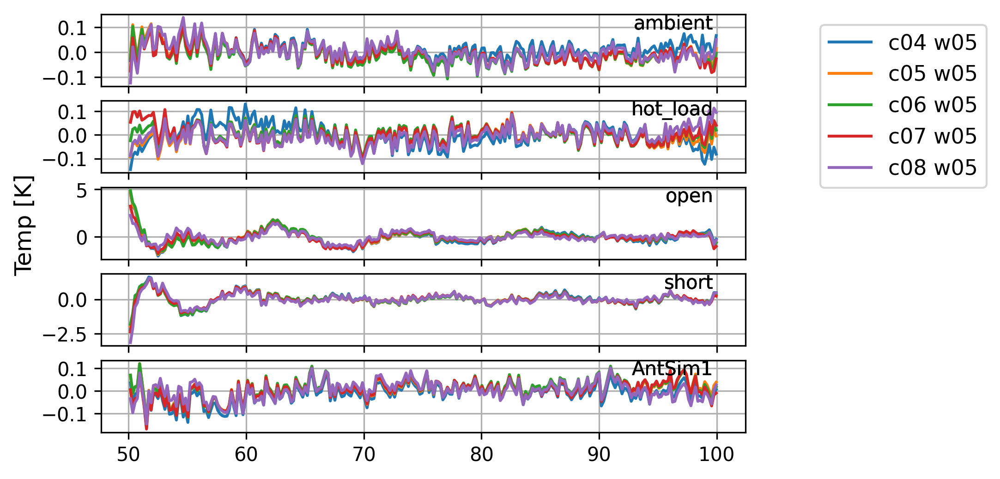

In [20]:
loads = {**calobs32.loads, **{'AntSim1': antsim32}}

fig, ax = plt.subplots(len(loads), 1, sharex=True)

n = 0
for i, (name, rc) in enumerate(recal_temps.items()):
    kw = precal.get_kwargs(name)
    if kw['wterms'] == 5 and kw['antsim']:
        plot_recal_best(loads, rc, c=f'C{n}', label=name[:7].replace('_', ' '), fig=fig, ax=ax)
        n += 1
        
ax[0].legend(bbox_to_anchor=(1.1, 1.))

(<Figure size 3600x2400 with 4 Axes>,
 array([<AxesSubplot:title={'center':'ambient'}, ylabel='Temp. [K]'>,
        <AxesSubplot:title={'center':'hot_load'}, ylabel='Temp. [K]'>,
        <AxesSubplot:title={'center':'open'}, ylabel='Temp. [K]'>,
        <AxesSubplot:title={'center':'short'}, xlabel='Frequency', ylabel='Temp. [K]'>],
       dtype=object))

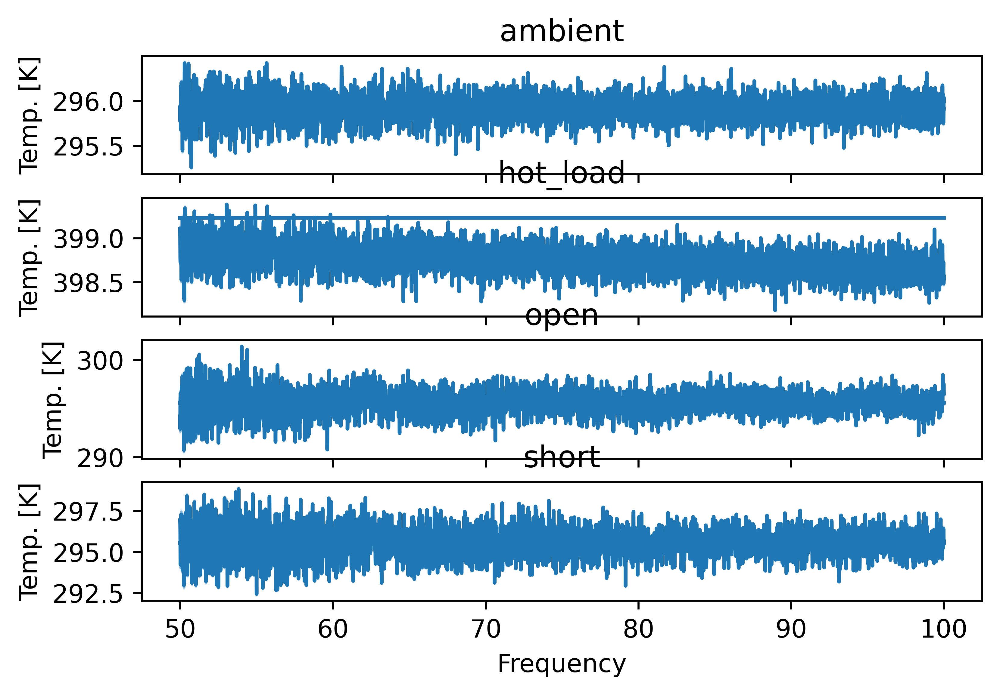

In [28]:
kwargs = cal_mcmc.get_kwargs(cal_runs['c11_w10_smooth16'].root)
lk = cal_mcmc.get_likelihood(tns_width=1000, **kwargs)
utils.plot_recalibrated_sources(cal_blobs['c11_w10_smooth16'], cal_runs['c11_w10_smooth16'], lk, utils.calobs)

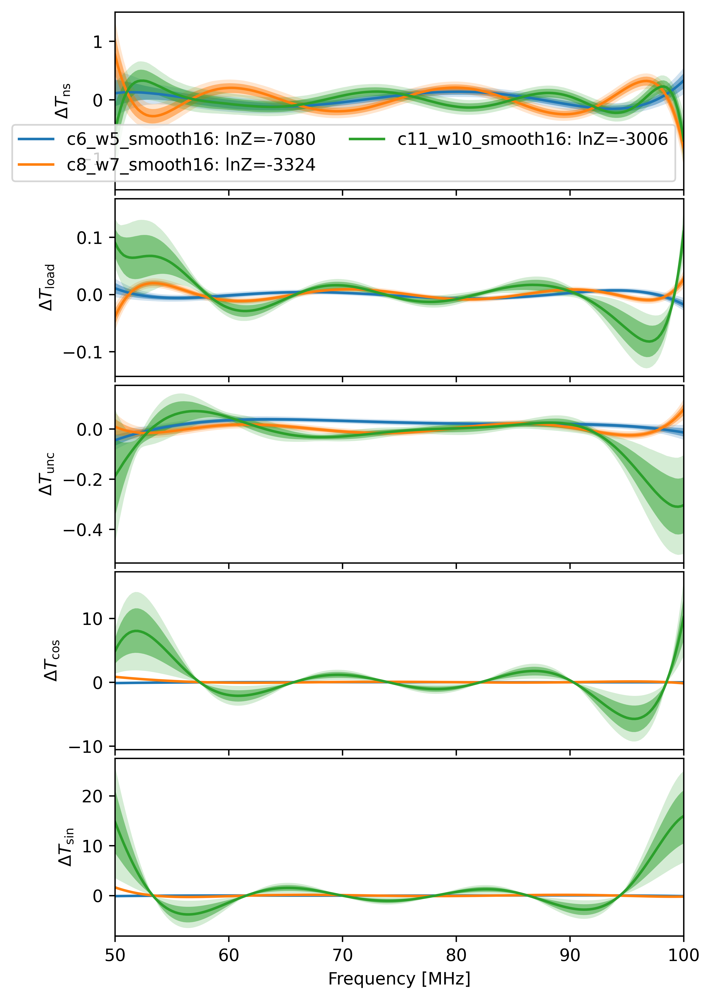

In [16]:
fig, ax =  plt.subplots(5, 1, sharex=True, figsize=(6, 10), gridspec_kw={"hspace": 0.05, 'wspace': 0.05})
for i, name in enumerate(['c6_w5_smooth16', 'c8_w7_smooth16', 'c11_w10_smooth16']):
    blobs = cal_blobs[name]
    mc = cal_runs[name]
    evidence=get_evidence(mc.root)
    utils.plot_cal_solutions(blobs, utils.calobs, fig=fig, ax=ax, cidx=i, label=f"{name.lstrip('_')}: lnZ={evidence:.0f}")
    ax[0].legend(ncol=2, loc='lower right')
    fig.savefig(f"pure_cal_solutions_{i}.png")

In [21]:
cov_w6_c5 = np.cov(cal_blobs['c6_w5']['recal_sky'].T)

In [27]:
corr_w6_c5 = cov_w6_c5/np.sqrt(np.outer(np.diag(cov_w6_c5),np.diag(cov_w6_c5)))

In [35]:
from matplotlib import colors

In [42]:
fig, ax = plt.subplots(1,1)
im = ax.imshow(cov_w6_c5, origin='lower', extent=(utils.sky_data['freq'].min(), utils.sky_data['freq'].max(), utils.sky_data['freq'].min(), utils.sky_data['freq'].max(),),
              norm=colors.SymLogNorm(linthresh=0.001, 
                                               linscale=0.001,
                                              vmin=-1.0, vmax=1.0),
              cmap='seismic')
plt.colorbar(im, ax=ax)
ax.set_xlabel("Frequency [MHz]")
fig.savefig('covariance_of_recal_sky.png')

In [32]:
fig, ax = plt.subplots(1,1)
im = ax.imshow(corr_w6_c5, origin='lower', extent=(utils.sky_data['freq'].min(), utils.sky_data['freq'].max(), utils.sky_data['freq'].min(), utils.sky_data['freq'].max(),))
plt.colorbar(im, ax=ax)
ax.set_xlabel("Frequency [MHz]")
fig.savefig('correlation_of_recal_sky.png')

## Calibration + Sky

### Setup the likelihood

Need to get a reasonable estimate of the variance. In our initial case, we're going to assume the variance of the data is essentially constant over the bandwidth -- this conforms to the way the data is fit by default in Alan's pipeline.

In [ ]:
qant = decalibrate(f_sky=alan_sky_data['freq'], t_sky=alan_sky_data['t_ant'])[0]

In [ ]:
fsky = alan_sky_data['freq']
for n_terms in [5, 10, 15, 20, 25, 30, 35, 40]:
    fit = Polynomial(n_terms=n_terms, transform=UnitTransform(range=(fsky.min(), fsky.max()))).fit(fsky, ydata=qant)
    print(f"variance for n={n_terms} fit: ", np.var(fit.residual))
    
fit = Polynomial(n_terms=25, transform=UnitTransform(range=(fsky.min(), fsky.max()))).fit(fsky, ydata=qant)
qant_var = np.ones_like(qant) * np.var(fit.residual)  # the value for 25 terms.

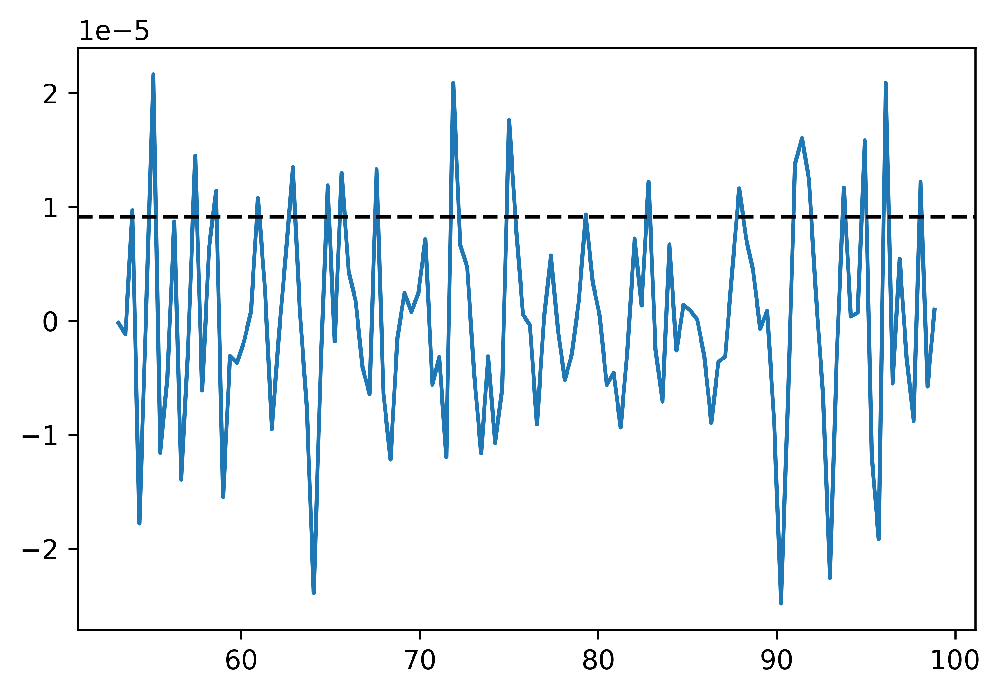

In [45]:
plt.plot(fsky, fit.residual)
plt.axhline(np.sqrt(qant_var[0]), color='k', ls='--')

In [ ]:
fg = LinLog(n_terms=5, parameters=[2000, 10, -10, 5, -5])
eor = AbsorptionProfile(
    freqs=fsky, 
    params={
        "A": {'fiducial': res_recal_s11.x[0], 'min': 0, 'max': 5.0, "ref": stats.norm(0.5, scale=0.01) },
        "w": {'fiducial': res_recal_s11.x[2], 'min': 5, 'max': 25, "ref": stats.norm(15, scale=0.1)},
        #"tau": {'fiducial': 5, 'min': 0, 'max': 20, "ref": stats.norm(5, scale=0.1)},
        "nu0": {'fiducial': res_recal_s11.x[1], 'min': 60, 'max': 90, 'ref': stats.norm(78, scale=0.1)},
    },
    fiducial={"tau": 7.0}
)

In [ ]:
est_tns = calobs.C1_poly.coeffs[::-1] * calobs.t_load_ns

t_ns_params = ParamVec(
    't_lns',
    length=calobs.cterms,
    min=est_tns - 100.0,
    max=est_tns + 100.0,
    fiducial = est_tns,
    ref = [stats.norm(v, scale=1.0) for v in est_tns]
)

In [ ]:
this_labcal = labcal.with_ant_s11(alan_ant_s11_func)

In [ ]:
data_lk = DataCalibrationLikelihood.from_labcal(
    this_labcal, 
    field_freq=fsky,
    q_ant=qant, 
    qvar_ant=qant_var, 
    fg_model=fg, 
    eor_components=(eor,),
    sim=False,
    t_ns_params=t_ns_params,
    loss=loss,
    bm_corr=bmcorr
)

In [ ]:
def view_results(lk, res_data, calobs=calobs):
    eorspec = lk.partial_linear_model.get_ctx(params=res_data.x)

    fig, ax = plt.subplots(2, 2, figsize=(15, 7), sharex=True)

    sim_tns = calobs.C1()*calobs.t_load_ns
        
    nu = calobs.freq.freq
    
    ax[0, 0].plot(nu, eorspec['tns'], label='Simultaneous')
    ax[0, 0].plot(nu, sim_tns, label='Isolated (Fid.)')
    ax[1, 0].plot(nu, eorspec['tns'] - sim_tns, color='k', label=r"$\Delta T_{\rm NS}$")
    #ax[1, 0].plot(nu,(eorspec['tns'] - sim_tns)*lk.data['q']['ant'], color='r', label=r"$\Delta T_{\rm NS} Q_{\rm ant}$")
    ax[0, 0].set_title(r"$T_{\rm NS}$")
    ax[0, 0].set_ylabel("Temperature [K]")
    
    nu = lk.nwfg_model.field_freq
    
    ax[0, 1].plot(nu, eorspec['eor_spectrum'])
    ax[0, 1].plot(nu, slf_recal_s11.get_eor(res_recal_s11.x) + slf_recal_s11.get_resid(res_recal_s11.x), label='')
    ax[0, 1].set_title(r"$T_{21}$")
    ax[1, 1].plot(nu,eorspec['eor_spectrum'] - slf_recal_s11.get_eor(res_recal_s11.x), color='k')
    ax[1, 0].set_ylabel("Difference [K]")
    
    ax[1, 0].set_xlabel("Frequency")
    ax[1, 1].set_xlabel("Frequency")
    
    ax[0, 0].legend()
    ax[1, 0].legend()

### Simple ML Test Cases

#### With Ideal Calibration Data (zero variance)

This is the simplest test case, because it *should* give exactly the same result as the SLF fit (if everything is specified correctly).

We use ideal (simulated) calibration data where we know the input solutions (they are whatever we measured in `calobs`), and set the noise on the sims to be very close to zero, so that they dominate the calibration part. 

## Inspect Data

### Fit Absorption

In [7]:
from edges_estimate.eor_models import AbsorptionProfile
from edges_estimate.fitting import SemiLinearFit

In [9]:
def plot_resids(slf, res, ls='-', label=True):
    plt.plot(slf.eor.freqs, slf.get_resid([0, 75, 20]), label="FG Resid" if label else None, color='C0', ls=ls)
    plt.plot(slf.eor.freqs, slf.get_resid(res.x), label="FG+Abs Resid" if label else None, color='C1', ls=ls)
    plt.plot(slf.eor.freqs, slf.get_eor(res.x) + slf.get_resid(res.x), label="Feature + Noise" if label else None, color='C2', ls=ls)
    
    plt.legend()

In [101]:
data_lk_idealz = DataCalibrationLikelihood.from_labcal(
    this_labcal, 
    field_freq=fsky,
    q_ant=qant, 
    qvar_ant=qant_var, 
    fg_model=LinLog(n_terms=5), 
    eor_components=(eor,),
    sim=True,
    cal_noise=1e-15,
    t_ns_params=t_ns_params,
    loss=loss,
    bm_corr=bmcorr
)

In [102]:
res_data_idealz = run_map(data_lk_idealz.partial_linear_model)

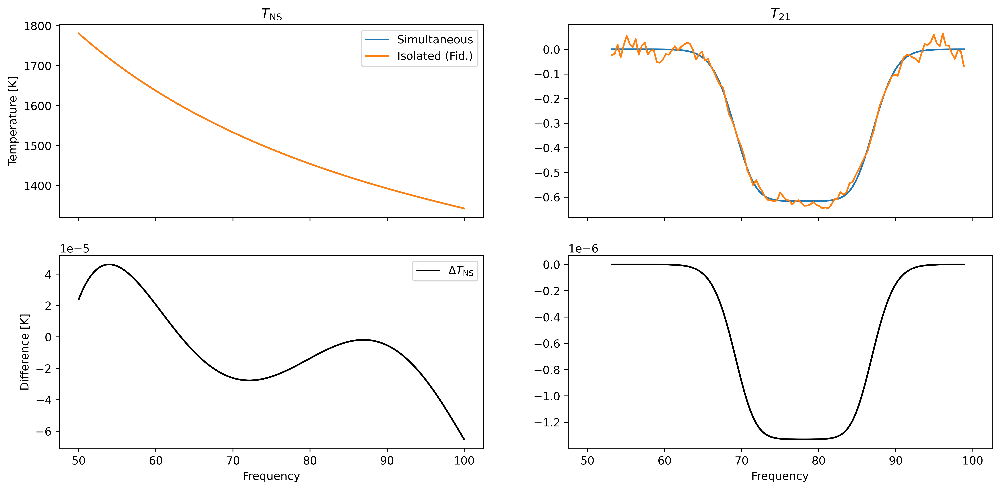

In [103]:
view_results(data_lk_idealz, res_data_idealz, calobs=this_labcal.calobs)

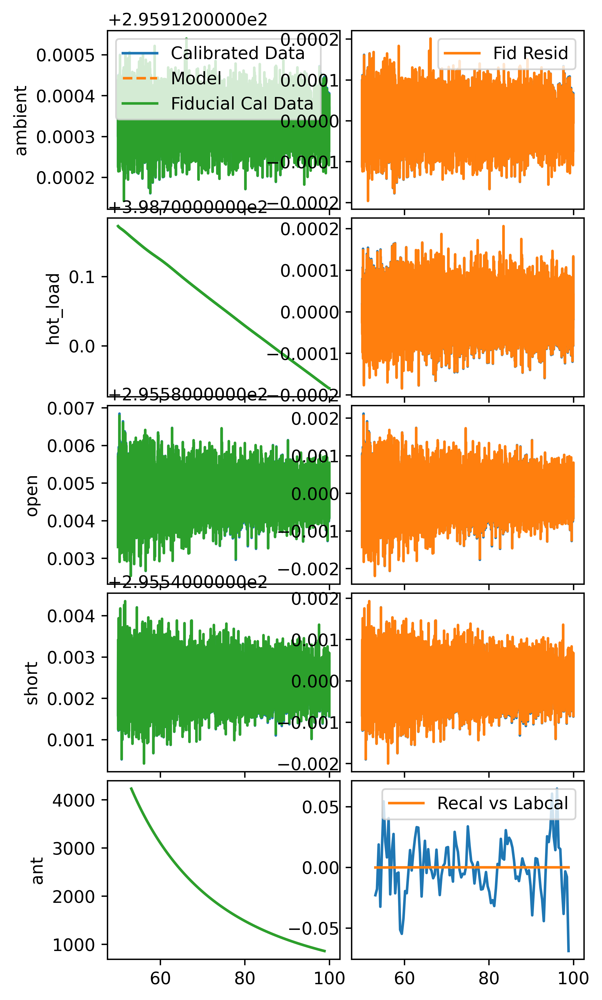

In [104]:
data_lk_idealz.plot_calibrated_temps(params=res_data_idealz.x, labcal=this_labcal);

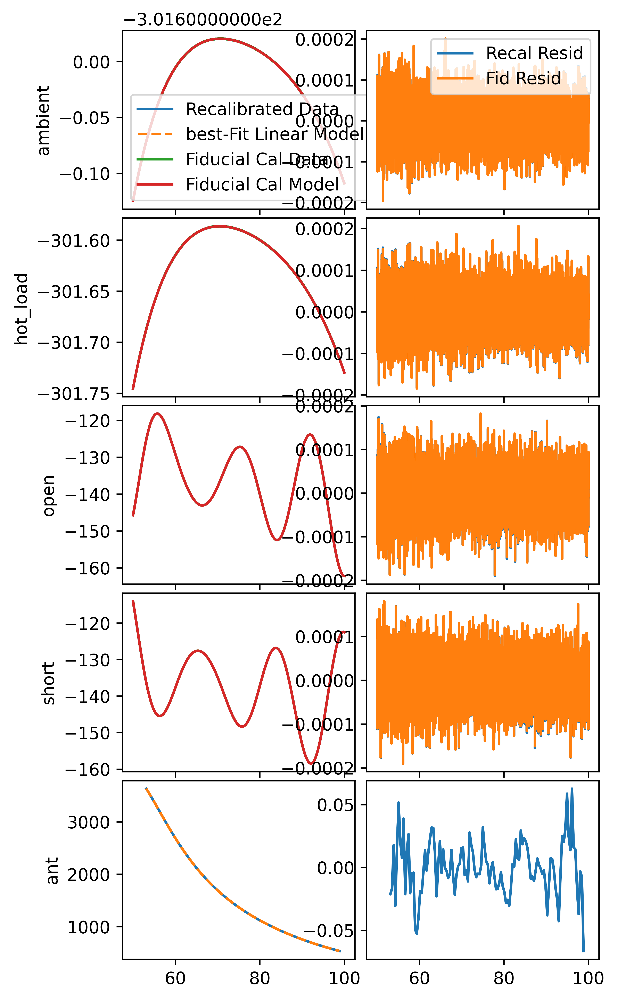

In [105]:
data_lk_idealz.plot_models(params=res_data_idealz.x, calobs=calobs, plot_zscore=False);

In [106]:
compatible_slf = SemiLinearFit(
    fg=linlog5.at(x=alan_sky_data['freq']), 
    eor=make_absorption(alan_sky_data['freq'], fix=('tau',)), 
    spectrum=data_lk_idealz.recalibrated_sky_temp(res_data_idealz.x), 
    sigma= np.sqrt(qant_var) * calobs.C1(alan_sky_data['freq']) * calobs.t_load_ns
)
res_cmp = compatible_slf()

In [70]:
def print_diffs(x, fnc):
    print(fnc(x) - fnc([x[0]-0.01, x[1], x[2]]))
    print(fnc(x) - fnc([x[0]+0.01, x[1], x[2]]))
    print(fnc(x) - fnc([x[0], x[1]-0.01, x[2]]))
    print(fnc(x) - fnc([x[0], x[1]+0.01, x[2]]))
    print(fnc(x) - fnc([x[0], x[1], x[2]-0.01]))
    print(fnc(x) - fnc([x[0], x[1], x[2]+0.01]))
    
def get_slf_diff(x):
    print_diffs(x, compatible_slf.neg_lk)
        

In [74]:
def _get_lk(x):
    return data_lk_ideal.partial_linear_model(params=res_data_ideal.x.tolist()[:-3] + x)[0]

def get_lk_diff(x):
    x = [x[0], x[2], x[1]]
    print_diffs(x, lambda x: -_get_lk(x))

In [75]:
get_slf_diff(res_cmp.x)

-0.8735556586548796
-0.872532365723373
-0.018387697179832685
-0.018064637698472552
-0.009194307322928807
-0.009228893400802463


In [76]:
get_lk_diff(res_cmp.x)

-0.8402439555793535
-0.763350227218325
-0.009848110155871836
-0.0069761963604833
-0.01821214714072994
-0.015143469299800927


In [79]:
xx = (res_data_ideal.x[-3],res_data_ideal.x[-1], res_data_ideal.x[-2]) 
get_slf_diff(xx)

-1.06530168729671
-1.9039562998541442
-0.7645910721446398
0.73601179284924
-2.86024903345168
2.847515528301699


In [80]:
get_lk_diff(xx)

-1.2317573393884231
-1.4854373769048834
-2.61171326281692
2.600124029111612
-0.7531273587519536
0.7270420489512617


In [62]:
-(
    data_lk_ideal.partial_linear_model(params=res_data_ideal.x.tolist()[:-3] + [0.5, 18.0, 78.0] )[0]
    - data_lk_ideal.partial_linear_model(params=res_data_ideal.x.tolist()[:-3] + [0.5, 18.0, 78.1] )[0]
)

1.16887846870668

#### With ideal Calibration Data (data variance)

The aim here is to use calibration data that exactly corresponds to the input model (and where the input model is equivalent to the model used for traditional solutions). This means that 

1. If we obtain a similar solution to the traditional solution, then it is the calibration data itself that is incompatible with the calibration solutions
2. If we obtain a different solution for $T_{21}$ than is usually obtained, then it is either because the sky data has different gains than we are using, and it is shifting the calibration away from where it "should be", or the sky model itself is wrong and this is being compensated by the calibration solutions.

In [92]:
est_tns = calobs.C1_poly.coeffs[::-1] * calobs.t_load_ns

t_ns_params = ParamVec(
    't_lns',
    length=calobs.cterms,
    min=est_tns - 100.0,
    max=est_tns + 100.0,
    fiducial = est_tns,
    ref = [stats.norm(v, scale=1.0) for v in est_tns]
)

data_lk_ideal = DataCalibrationLikelihood.from_labcal(
    this_labcal, 
    field_freq=fsky,
    q_ant=qant, 
    qvar_ant=qant_var, 
    fg_model=LinLog(n_terms=5), 
    eor_components=(eor,),
    sim=True,
    cal_noise='data',
    t_ns_params=t_ns_params,
    loss=loss,
    bm_corr=bmcorr
)

In [93]:
res_data_ideal = run_map(data_lk_ideal.partial_linear_model)

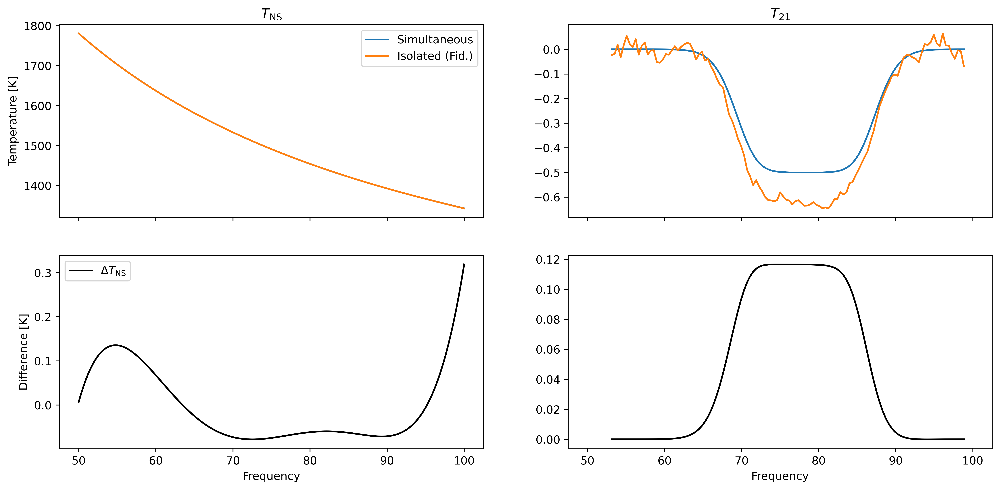

In [94]:
view_results(data_lk_ideal, res_data_ideal, calobs=calobs)

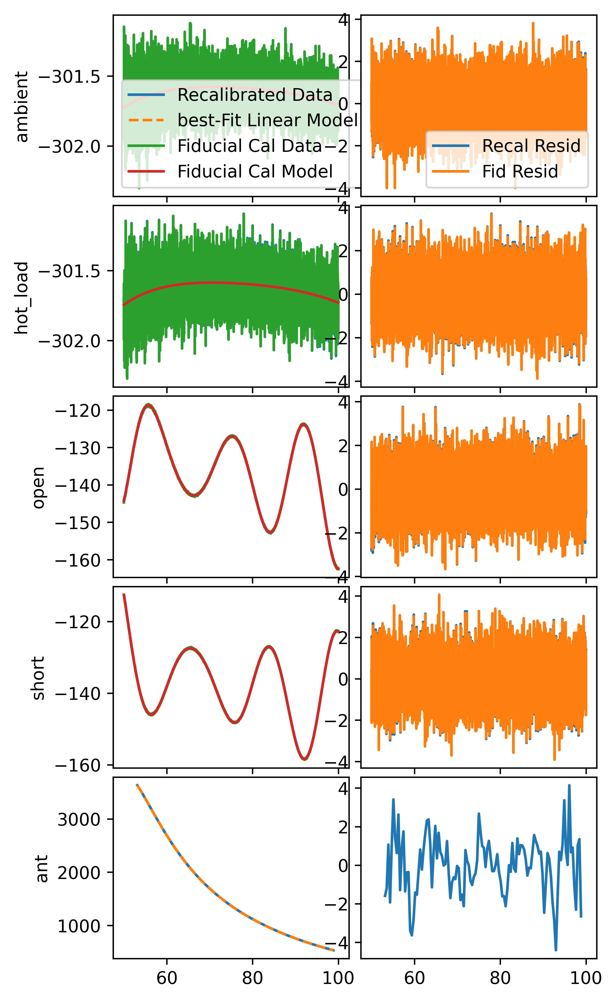

In [50]:
data_lk_ideal.plot_models(params=res_data_ideal.x, calobs=calobs);

So, even though the calibration data has more variance, it still dominates the calibration solutions.

In [109]:
diff = data_lk_ideal.recalibrated_sky_temp(res_data_ideal.x) - data_lk_idealz.recalibrated_sky_temp(res_data_idealz.x)

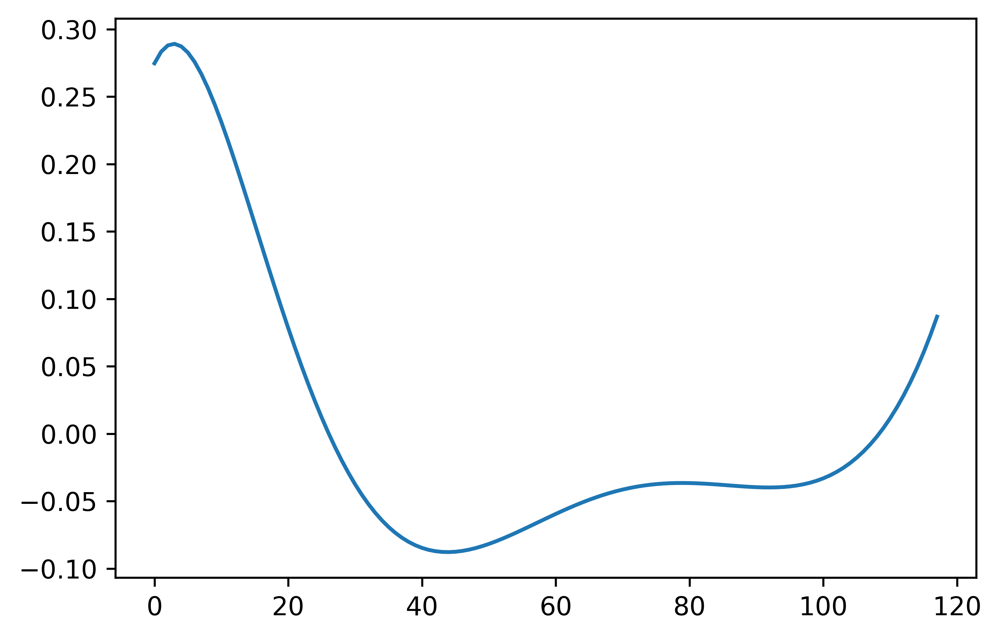

In [110]:
plt.plot(diff)

In [95]:
xx = (res_data_ideal.x[-3],res_data_ideal.x[-1], res_data_ideal.x[-2]) 
get_slf_diff(xx)

-21.922761570762646
20.209018685814996
0.8986548571683386
-0.9319321743075477
1.1217596908809924
-1.1356955315008292


In [96]:
get_lk_diff(res_cmp.x)

91.0461190731512
-98.13213944503514
-9.20587985950624
9.080224148088746
-9.3109667951976
9.167545681561023


In [97]:
get_lk_diff(xx)

-3.399039925843681
-3.267864791658212
-0.022842834219773067
-0.060084619148256024
-0.035450361618131865
-0.0885895770152274


In [111]:
compatible_slf = SemiLinearFit(
    fg=linlog5.at(x=alan_sky_data['freq']), 
    eor=make_absorption(alan_sky_data['freq'], fix=('tau',)), 
    spectrum=data_lk_ideal.recalibrated_sky_temp(res_data_ideal.x), 
    sigma= np.sqrt(qant_var) * calobs.C1(alan_sky_data['freq']) * calobs.t_load_ns
)
res_cmp = compatible_slf()

In [112]:
res_cmp

      fun: -265.80613376801597
 hess_inv: <3x3 LbfgsInvHessProduct with dtype=float64>
      jac: array([0.01888338, 0.01885497, 0.02310685])
  message: 'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 120
      nit: 14
     njev: 30
   status: 0
  success: True
        x: array([ 0.50216697, 78.06736286, 18.34498601])

In [113]:
res_data_ideal.x[-3:]

array([ 0.50059375, 18.29346632, 78.33667281])

#### Ideal Calibration data (data var, more fg terms)

In [98]:
data_lk_ideal_fg8 = DataCalibrationLikelihood.from_labcal(
    this_labcal, 
    field_freq=fsky,
    q_ant=qant, 
    qvar_ant=qant_var, 
    fg_model=LinLog(n_terms=8), 
    eor_components=(eor,),
    sim=True,
    cal_noise='data',
    t_ns_params=t_ns_params,
    loss=loss,
    bm_corr=bmcorr
)

In [99]:
res_data_ideal_fg8 = run_map(data_lk_ideal_fg8.partial_linear_model)

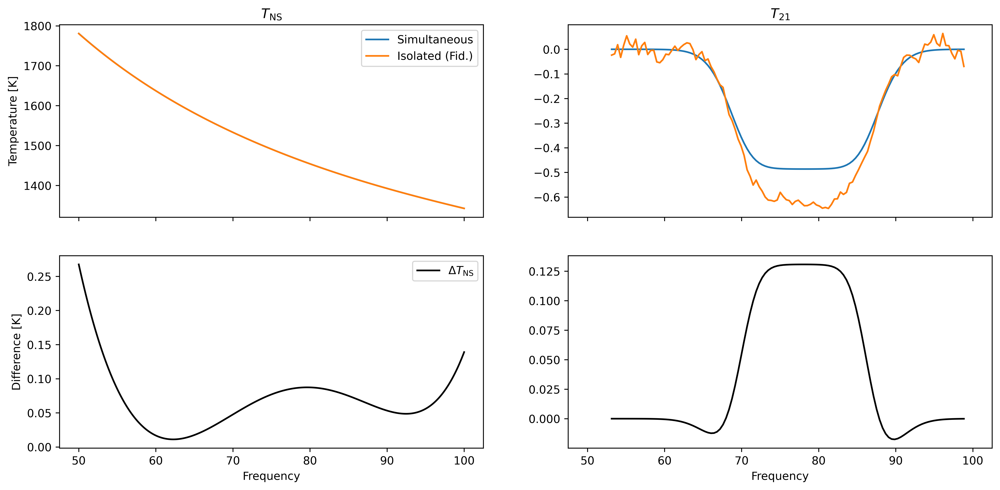

In [100]:
view_results(data_lk_ideal_fg8, res_data_ideal_fg8, calobs=calobs)

#### Default

In [114]:
res_data = run_map(data_lk.partial_linear_model)

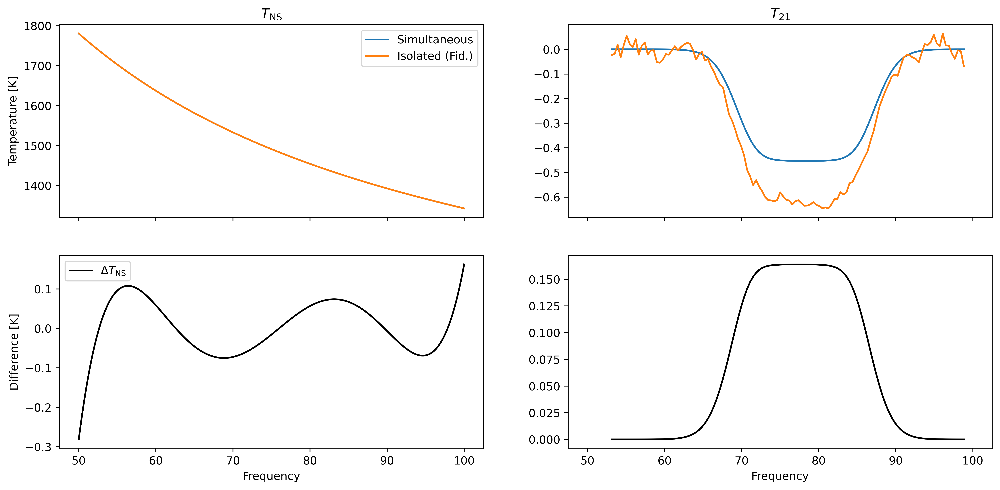

In [115]:
view_results(data_lk, res_data)

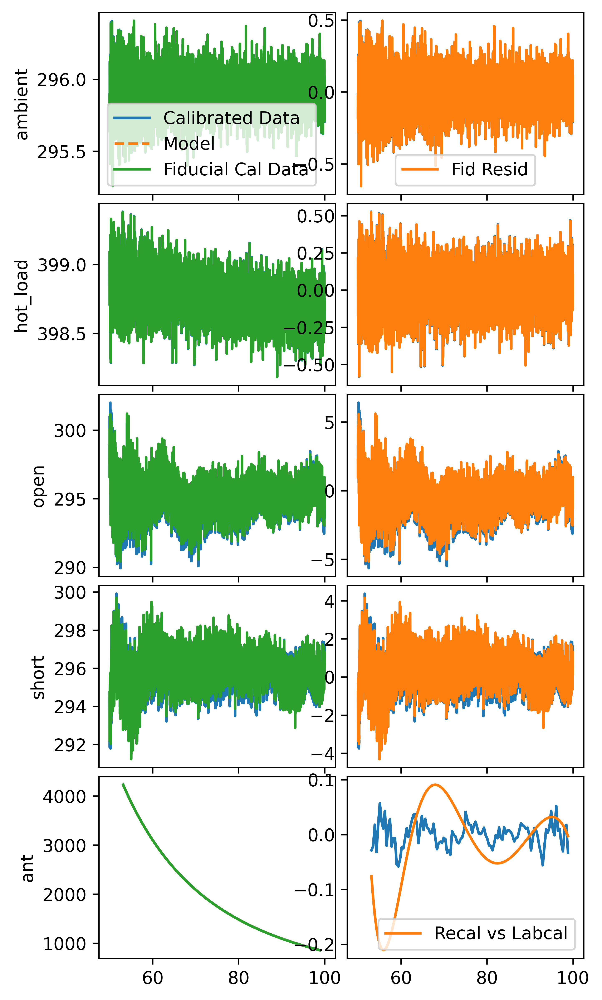

In [116]:
data_lk.plot_calibrated_temps(params=res_data.x, labcal=this_labcal);

Here, it is clear that the sky data is having some effect on the calibration solutions, which means that either the sky isn't flexible enough, or that the calibration solutions aren't.

#### Increase cterms/wterms

The idea here is that possibly there's just not enough flexibility in the calibration to deal with both the calibration data and the sky data. What happens if we increase the flexibility of the calibration?

In [144]:
def get_res_nterms(cterms, wterms, fit=True):
    calobs10 = CalibrationObservation(
    "/data5/edges/data/CalibrationObservations/Receiver01/Receiver01_25C_2015_09_02_040_to_200MHz/", 
    f_low=50.0,
    f_high=100.0,
    run_num={"receiver_reading": 6},
    repeat_num=1,
    cterms=cterms,
    wterms=wterms,
    load_kwargs= {"t_load": 300, "t_load_ns": 1000.0},
    load_spectra = {
        "hot_load": {"ignore_times_percent": 10},
        "ambient": {"ignore_times_percent": 7},
        "open": {"ignore_times_percent": 7},
        "short": {"ignore_times_percent": 7},
    },
    load_s11s = {"lna":{'n_terms': 11, 'model_type': 'polynomial'}}
)

    labcal10 = get_labcal(calobs10).with_ant_s11(alan_ant_s11_func)

    est_tns = calobs10.C1_poly.coeffs[::-1] * calobs10.t_load_ns

    t_ns_params = ParamVec(
        't_lns',
        length=calobs10.cterms,
        min=est_tns - 100.0,
        max=est_tns + 100.0,
        fiducial = est_tns,
        ref = [stats.norm(v, scale=1.0) for v in est_tns]
    )
    
    data_lk_10 = DataCalibrationLikelihood.from_labcal(
        labcal10, 
        field_freq=fsky,
        q_ant=qant, 
        qvar_ant=qant_var, 
        fg_model=fg, 
        eor_components=(eor,),
        sim=False,
        t_ns_params=t_ns_params,
        loss=loss,
        bm_corr=bmcorr
    )
    
    if fit:
        res_data = run_map(data_lk_10.partial_linear_model)

        view_results(data_lk_10, res_data, calobs=calobs10)
        plt.title(f"cterms={cterms}, wterms={wterms}")

        fig, ax = data_lk_10.plot_models(params=res_data.x, calobs=calobs10)
        fig.suptitle(f"cterms={cterms}, wterms={wterms}")
        return data_lk_10, res_data
    else:
        return data_lk_10

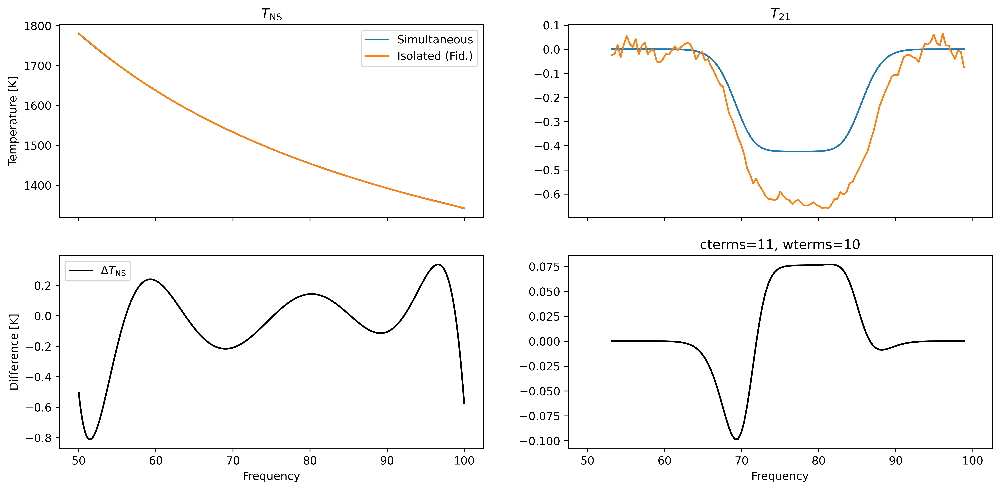

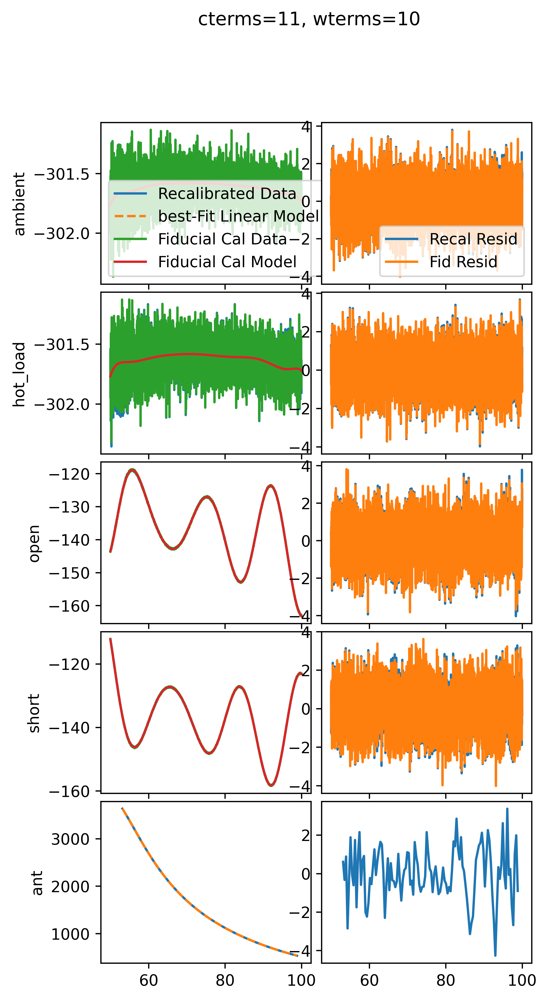

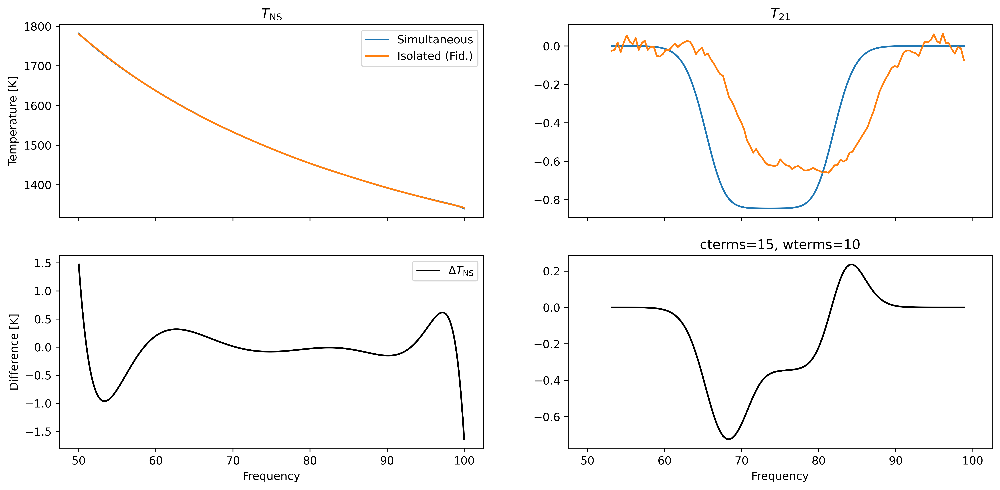

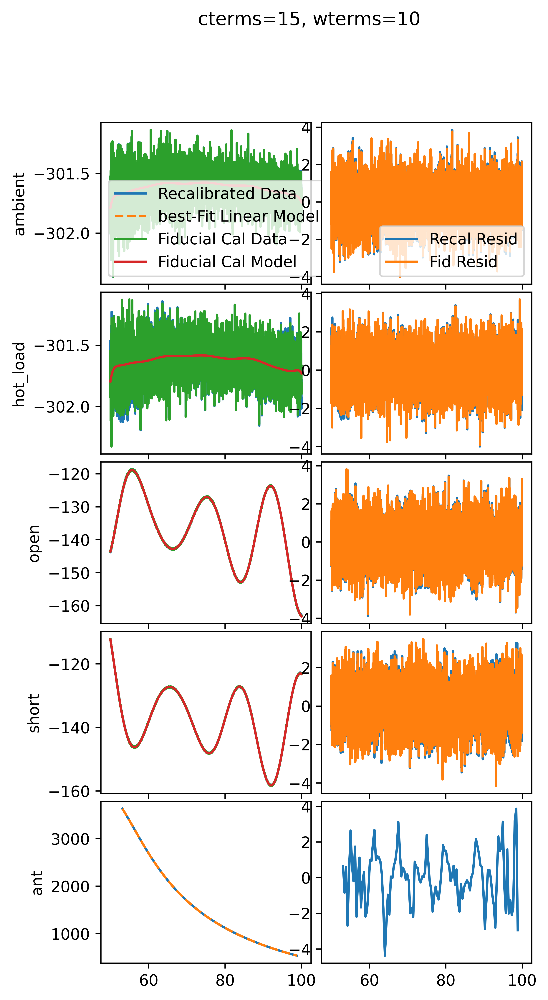

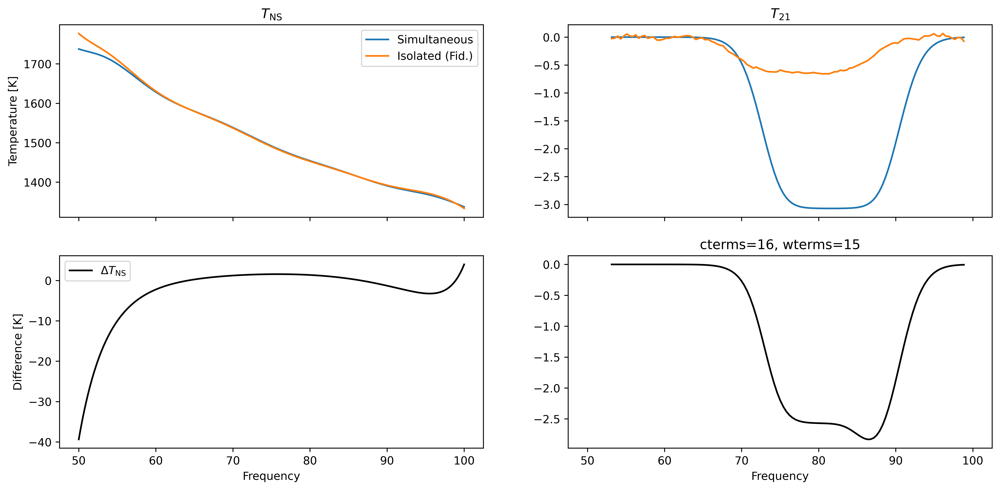

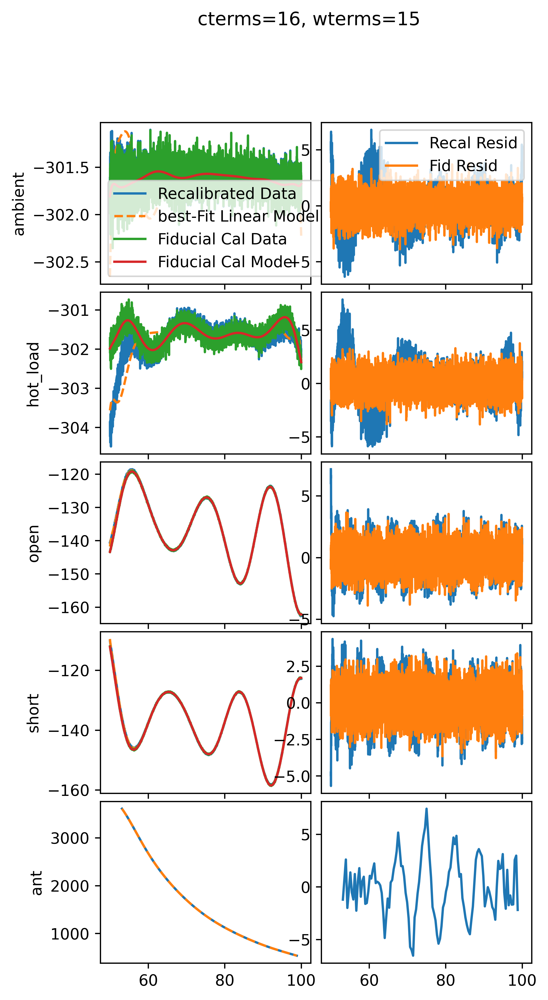

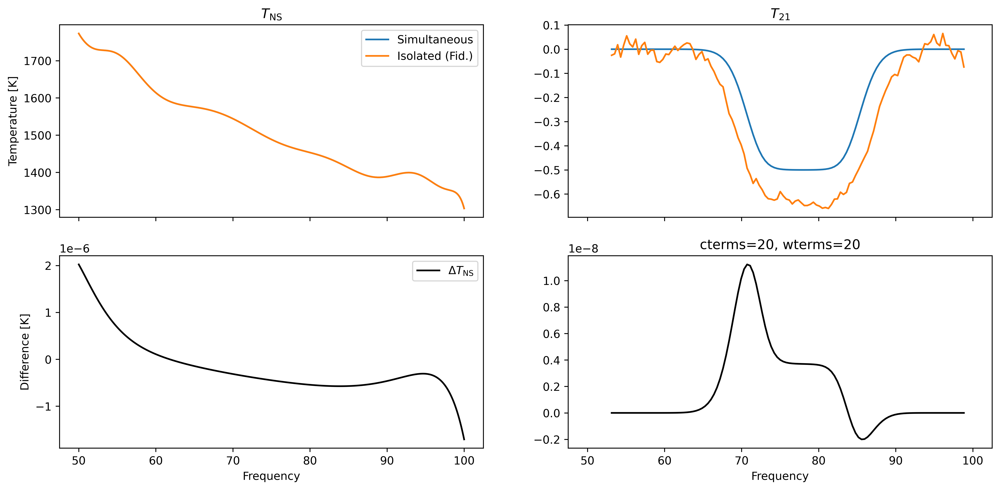

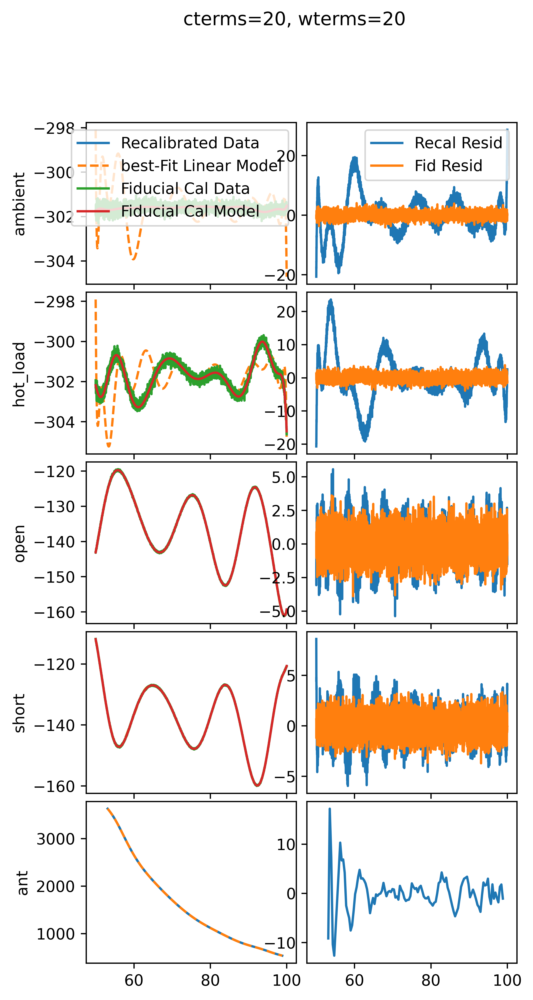

In [32]:
terms_results = []
for (cterms, wterms) in [(11, 10), (15, 10), (16, 15), (20, 20)]:
    terms_results.append(get_res_nterms(cterms, wterms))

There is no evidence that we do any better by increasing the flexibility of the calibration model past ~10 terms.

#### More Flexible Sky Model

It's possible that the calibration model is more than adequate to describe the calibration data, but the sky model is wrong, and driving the calibration away from its correct value. Let's try a more flexible sky model.

In [145]:
def get_res_fgterms(n, fit=True):
    fg = LinLog(n_terms=n)
    data_lk = DataCalibrationLikelihood.from_labcal(
        this_labcal, 
        field_freq=fsky,
        q_ant=qant, 
        qvar_ant=qant_var, 
        fg_model=fg, 
        eor_components=(eor,),
        sim=False,
        t_ns_params=t_ns_params,
        loss=loss,
        bm_corr=bmcorr
    )
    
    if fit:
        res_data = run_map(data_lk.partial_linear_model)

        view_results(data_lk, res_data, calobs=calobs)

        fig, ax = data_lk.plot_models(params=res_data.x, calobs=calobs)
        fig.suptitle(f"nterms={n}")
        return data_lk, res_data
    else:
        return data_lk

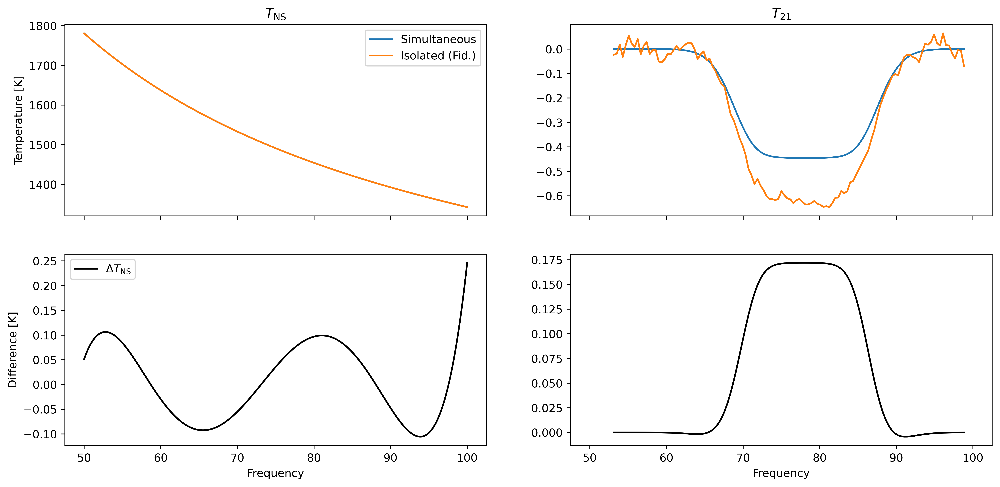

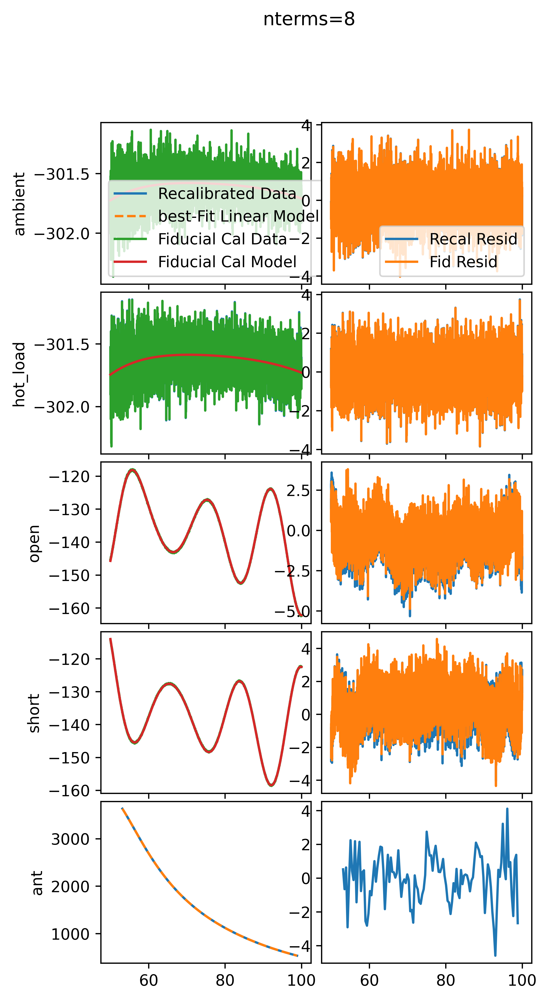

In [118]:
get_res_fgterms(8);

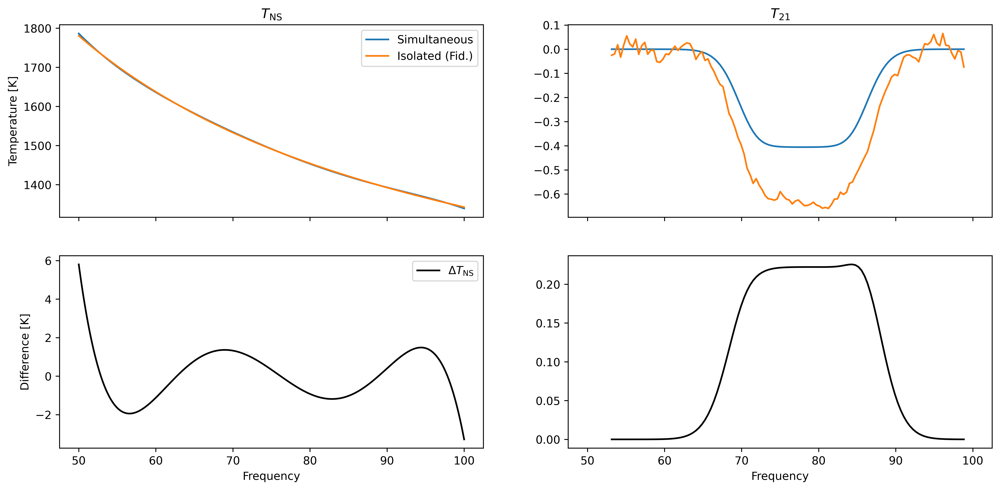

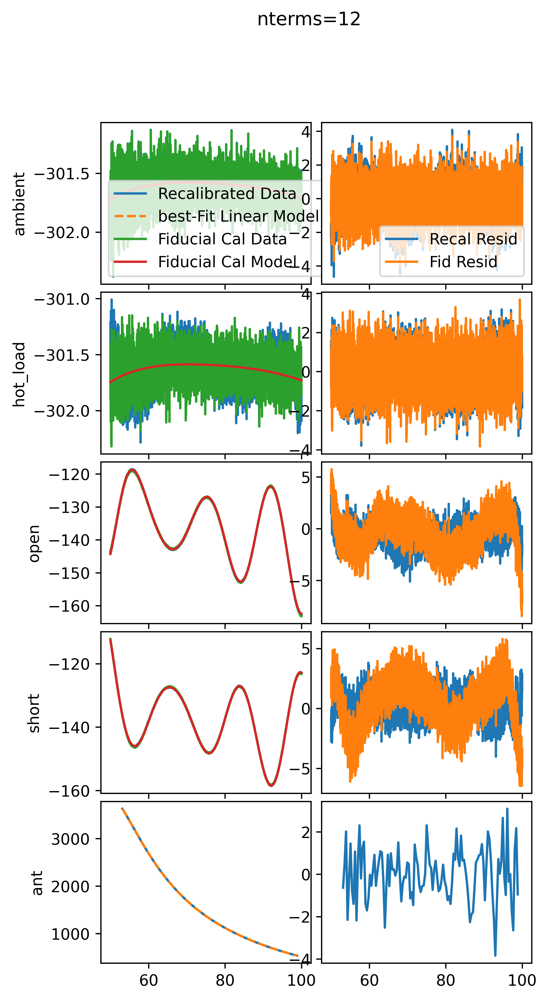

In [38]:
get_res_fgterms(12);

The picture here is that perhaps the FGs are more complicated than a simple 5-term linlog. Increasing the number of terms seems to help get $T_{21}$ back to something reasonable (actually very close to what you get for an ideal fit).

Let's see what would happen if we use that number of terms for a specific calibration:

In [39]:
data_lk_ideal_8 = DataCalibrationLikelihood.from_labcal(
    this_labcal, 
    field_freq=fsky,
    q_ant=qant, 
    qvar_ant=qant_var, 
    fg_model=LinLog(n_terms=8), 
    eor_components=(eor,),
    sim=True,
    cal_noise=1e-15,
    t_ns_params=t_ns_params,
    loss=loss,
    bm_corr=bmcorr
)

In [41]:
res_data_ideal_8 = run_map(data_lk_ideal_8.partial_linear_model)

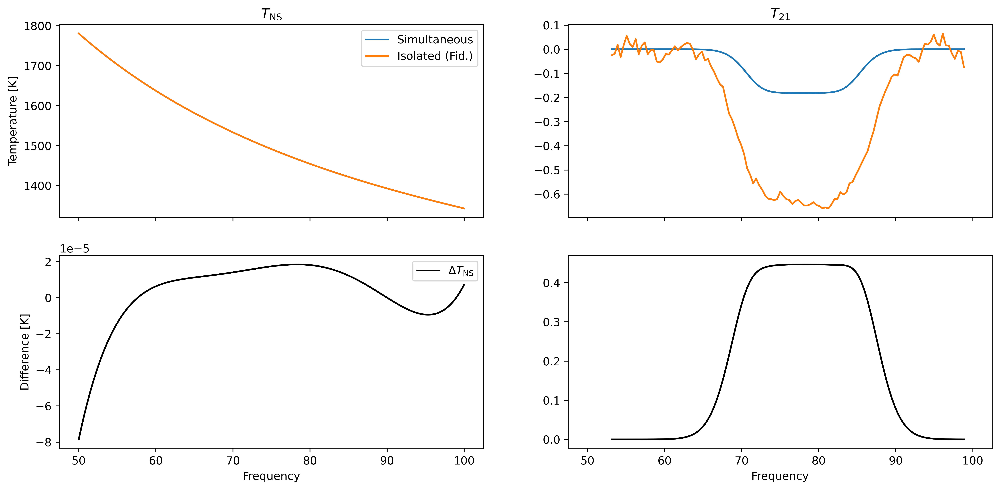

In [42]:
view_results(data_lk_ideal_8, res_data_ideal_8, calobs=this_labcal.calobs)

Interestingly, the forced ideal fit is quite shallow with 8 terms. This needs to be investigated.

#### Use 2017 Calibration Observation

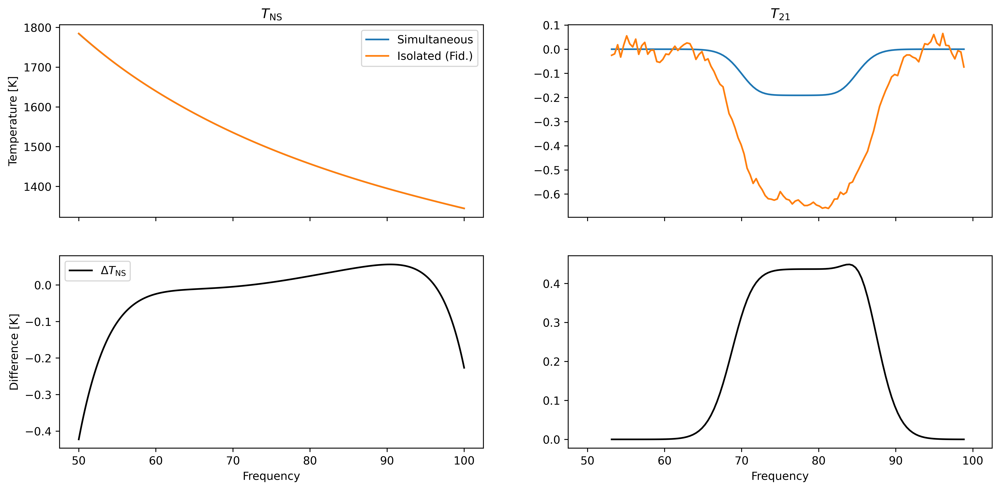

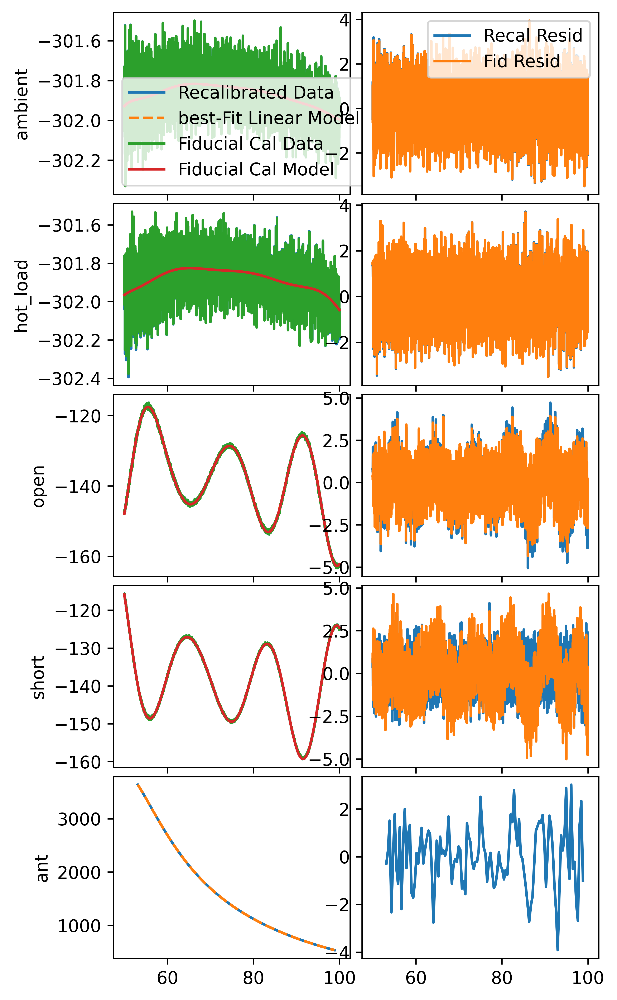

In [43]:
calobs2017 = CalibrationObservation(
    "/data5/edges/data/CalibrationObservations/Receiver01/Receiver01_25C_2017_05_01_040_to_200MHz/", 
    f_low=50.0,
    f_high=100.0,
    run_num={"receiver_reading": 1},
    repeat_num=1,
    cterms=10,
    wterms=10,
    load_kwargs= {"t_load": 300, "t_load_ns": 1000.0},
    load_spectra = {
        "hot_load": {"ignore_times_percent": 10},
        "ambient": {"ignore_times_percent": 7},
        "open": {"ignore_times_percent": 7},
        "short": {"ignore_times_percent": 7},
    },
    load_s11s = {"lna":{'n_terms': 11, 'model_type': 'polynomial'}},
    compile_from_def=False
)

labcal2017 = get_labcal(calobs2017)

est_tns = calobs2017.C1_poly.coeffs[::-1] * calobs2017.t_load_ns

t_ns_params = ParamVec(
    't_lns',
    length=calobs2017.cterms,
    min=est_tns - 100.0,
    max=est_tns + 100.0,
    fiducial = est_tns,
    ref = [stats.norm(v, scale=1.0) for v in est_tns]
)
    
data_lk_2017 = DataCalibrationLikelihood.from_labcal(
    labcal2017, 
    field_freq=fsky,
    q_ant=qant, 
    qvar_ant=qant_var, 
    fg_model=LinLog(n_terms=10), 
    eor_components=(eor,),
    sim=False,
    t_ns_params=t_ns_params,
    loss=loss,
    bm_corr=bmcorr
)
    
res_data = run_map(data_lk_2017.partial_linear_model)

view_results(data_lk_2017, res_data, calobs=calobs2017)
fig, ax = data_lk_2017.plot_models(params=res_data.x, calobs=calobs2017)

Again, it is hard to tell whether what's changing things here is the 2017 calibration parameters, or the extra FG parameters (using 10 here). Everything indicates that the sky model has something in it that is skewing the calibration if allowed to.

### Using emcee

In [119]:
from yabf.samplers.emcee import emcee


In [124]:
default_sampler = emcee(data_lk.partial_linear_model, sampler_kwargs={'nwalkers': 100, 'threads': 24}, save_full_config=False)

In [126]:
default_mcsamples = default_sampler.sample(nsteps=5000, progress='notebook')

  0%|          | 0/5000 [00:00<?, ?it/s]

Removed no burn in


In [127]:
default_mcsamples.saveAsText("emcee_calibration_sky")

In [130]:
import arviz as az

In [142]:
azdata = az.from_emcee(default_sampler._sampler, var_names=[p.name for p in data_lk.partial_linear_model.child_active_params])
azdata = azdata.sel(draw=slice(2000, None))

array([[<AxesSubplot:ylabel='t_lns_1'>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>],
       [<AxesSubplot:ylabel='t_lns_2'>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>],
       [<AxesSubplot:ylabel='t_lns_3'>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>],
       [<AxesSubplot:ylabel='t_lns_4'>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>],
       [<AxesSubplot:ylabel='t_lns_5'>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>],
       [<AxesSubplot:ylabel='A'>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubp

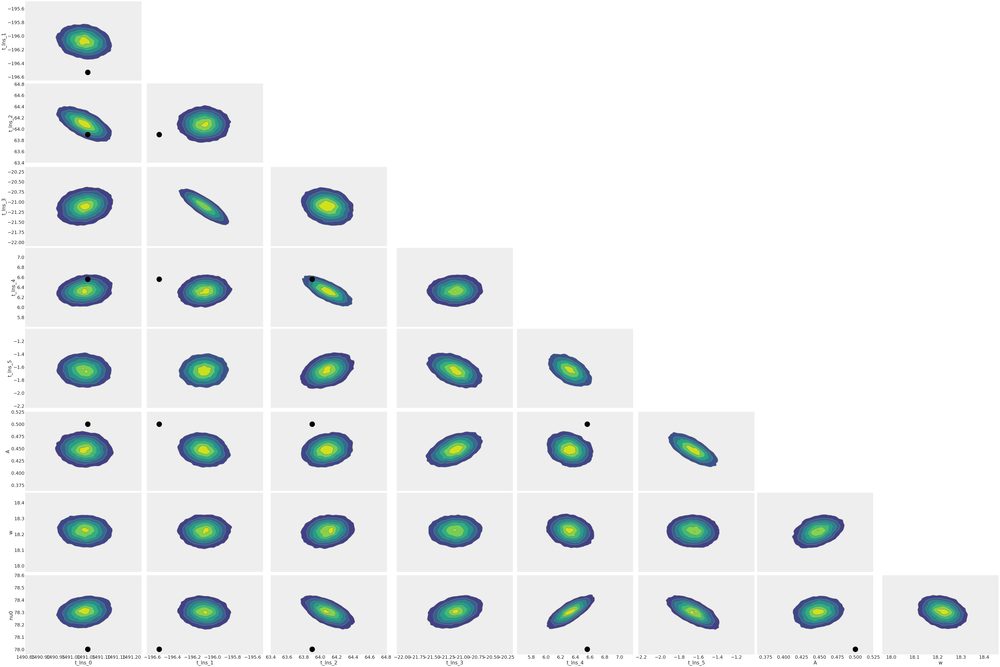

In [143]:
az.style.use("arviz-darkgrid")

az.plot_pair(
    azdata,
    var_names=[p.name for p in data_lk.partial_linear_model.child_active_params],
    kind="kde",
    divergences=True,
    textsize=22,
    reference_values={p.name: p.fiducial for p in data_lk.partial_linear_model.child_active_params},
    reference_values_kwargs={'markersize': 25, 'color': 'k'}
)

In [147]:
data_lk_7 = get_res_fgterms(7, fit=False)

In [148]:
term7_sampler = emcee(
    data_lk_7.partial_linear_model, 
    sampler_kwargs={'nwalkers': 100, 'threads': 24}, 
    save_full_config=False
)

In [ ]:
default_mcsamples = default_sampler.sample(nsteps=5000, progress='notebook')

  0%|          | 0/5000 [00:00<?, ?it/s]

### Using Polychord

#### File Reading

In [14]:
files = glob.glob("*.paramnames")

for fname in files:
    with open(fname, 'r') as fl:
        out = fl.readlines()
        for i, line in  enumerate(out):
            if r"t_{\rm lns}" in line:
                spl=line.split(r"t_{")
                out[i] = spl[0] + r"T_{\rm L+NS,%s}"%i + '\n'
            else:
                break

    with open(fname, 'w') as fl:
        fl.write(''.join(out))

[autoreload of edges_estimate.likelihoods failed: Traceback (most recent call last):
  File "/home/smurray/miniconda3/envs/edges/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/home/smurray/miniconda3/envs/edges/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 410, in superreload
    update_generic(old_obj, new_obj)
  File "/home/smurray/miniconda3/envs/edges/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/home/smurray/miniconda3/envs/edges/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 317, in update_class
    update_instances(old, new)
  File "/home/smurray/miniconda3/envs/edges/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 280, in update_instances
    ref.__class__ = new
  File "/home/smurray/miniconda3/envs/edges/lib/python3.9/site-packages/attr/_make.py", line 626, 

In [8]:
done = [k.replace(".paramnames", "") for k in glob.glob("alan_data_*.paramnames")]
done = {d: loadMCSamples('./'+d) for d in done}

In [9]:
done

{'alan_data_fg7_isolated_tau-fixed_iterative_recal': <getdist.mcsamples.MCSamples at 0x7f7c62cd02b0>,
 'alan_data_fg10_isolated_tau-fixed': <getdist.mcsamples.MCSamples at 0x7f7c60388910>,
 'alan_data_fg10_simul_tau-fixed_iterative_recal': <getdist.mcsamples.MCSamples at 0x7f7c604474f0>,
 'alan_data_fg5_simul_tau-fixed': <getdist.mcsamples.MCSamples at 0x7f7c60388bb0>,
 'alan_data_fg5_isolated_tau-fixed': <getdist.mcsamples.MCSamples at 0x7f7c62cc9400>,
 'alan_data_fg10_isolated_tau-free_iterative_recal': <getdist.mcsamples.MCSamples at 0x7f7c62cc9d30>,
 'alan_data_fg7_simul_tau-fixed_iterative_recal': <getdist.mcsamples.MCSamples at 0x7f7c60388d90>,
 'alan_data_fg7_isolated_tau-fixed': <getdist.mcsamples.MCSamples at 0x7f7c60388d30>,
 'alan_data_fg10_isolated_tau-fixed_iterative_recal': <getdist.mcsamples.MCSamples at 0x7f7c604476a0>,
 'alan_data_fg7_simul_tau-free': <getdist.mcsamples.MCSamples at 0x7f7c60387940>,
 'alan_data_fg5_isolated_tau-fixed_iterative_recal': <getdist.mcsample

In [10]:
data_blobs = {
    name: data_mcmc.get_linear_distribution(done[name], nthreads=16) for name in done
}

./alan_data_fg7_isolated_tau-fixed_iterative_recal {'nterms_fg': 7, 'fix_tau': True, 'simultaneous': False, 'ml_solution': False, 'cterms': 6, 'wterms': 5}
./alan_data_fg10_isolated_tau-fixed {'nterms_fg': 10, 'fix_tau': True, 'simultaneous': False, 'ml_solution': True, 'cterms': 6, 'wterms': 5}
./alan_data_fg10_simul_tau-fixed_iterative_recal {'nterms_fg': 10, 'fix_tau': True, 'simultaneous': True, 'ml_solution': False, 'cterms': 6, 'wterms': 5}
./alan_data_fg5_simul_tau-fixed {'nterms_fg': 5, 'fix_tau': True, 'simultaneous': True, 'ml_solution': True, 'cterms': 6, 'wterms': 5}
./alan_data_fg5_isolated_tau-fixed {'nterms_fg': 5, 'fix_tau': True, 'simultaneous': False, 'ml_solution': True, 'cterms': 6, 'wterms': 5}
./alan_data_fg10_isolated_tau-free_iterative_recal {'nterms_fg': 10, 'fix_tau': False, 'simultaneous': False, 'ml_solution': False, 'cterms': 6, 'wterms': 5}
./alan_data_fg7_simul_tau-fixed_iterative_recal {'nterms_fg': 7, 'fix_tau': True, 'simultaneous': True, 'ml_solution'

  0%|          | 0/16 [00:00<?, ?it/s]

In [36]:
running = [k.replace("_phys_live.txt", "") for k in glob.glob("alan_data_*_phys_live.txt")]
running = [r for r in running if r not in done]

In [37]:
running

['alan_data_nterms10_isolated',
 'alan_data_nterms7_isolated',
 'alan_data_nterms5_isolated']

#### How is Calibration Affected?

First, let's just look at $N_{\rm FG}=5$ (the default case) along with the standard calibration.

In [9]:
fig, ax =  plt.subplots(5, 1, sharex=True, figsize=(8, 10), gridspec_kw={"hspace": 0.05, 'wspace': 0.05})
fig2, ax2 =  plt.subplots(3, 1, sharex=True, figsize=(8, 8), gridspec_kw={"hspace": 0.05, 'wspace': 0.05})
fig3, ax3 =  plt.subplots(2, 1, sharex=True, figsize=(5, 8), gridspec_kw={"hspace": 0.05, 'wspace': 0.05})

blobs = cal_blobs['c6_w5']
mc = cal_runs['c6_w5']
evidence=utils.get_evidence(mc.root)
utils.plot_cal_solutions(blobs, utils.calobs, fig=fig, ax=ax, cidx=1, label=f"Pure Cal, c6_w5: lnZ={evidence:.0f}")
utils.plot_linear_coeffs(blobs, utils.labcal_s11, fig=fig2, ax=ax2, cidx=1, label=f"Pure Cal, c6_w5: lnZ={evidence:.0f}")


blobs = data_blobs['alan_data_fg5_isolated_tau-fixed']
mc = done['alan_data_fg5_isolated_tau-fixed']
evidence=utils.get_evidence(mc.root)
utils.plot_sky_models(blobs, fig=fig3, ax=ax3, cidx=1, label=r"ML Calibration, $N_{\rm FG}=5$")


blobs = data_blobs['alan_data_fg5_simul_tau-fixed']
mc = done['alan_data_fg5_simul_tau-fixed']
evidence=utils.get_evidence(mc.root)
utils.plot_cal_solutions(blobs, utils.calobs, fig=fig, ax=ax, cidx=0, label=r"Simul. $N_{\rm FG}=5$: lnZ=" + f"{evidence:.0f}")
utils.plot_linear_coeffs(blobs, utils.labcal_s11, fig=fig2, ax=ax2, cidx=0, label=r"Simul. $N_{\rm FG}=5$: lnZ=" + f"{evidence:.0f}")
utils.plot_sky_models(blobs, fig=fig3, ax=ax3, cidx=0, label=r"Simul. $N_{\rm FG}=5$: lnZ=" + f"{evidence:.0f}")

ax[0].legend(ncol=1, bbox_to_anchor=(1.01, 0.5), loc='center left')
fig.savefig(f"compare_iso_simul_cal_solutions_5.png", bbox_inches='tight')

ax2[0].legend(ncol=1, bbox_to_anchor=(1.01, 0.5), loc='center left')
fig2.savefig(f"compare_iso_simul_recal_5.png", bbox_inches='tight')

ax3[0].legend(ncol=1, bbox_to_anchor=(1.01, 0.5), loc='center left')
fig3.savefig(f"compare_iso_simul_skymod_5.png", bbox_inches='tight')

blobs = data_blobs['alan_data_fg7_simul_tau-fixed_iterative_recal']
mc = done['alan_data_fg7_simul_tau-fixed_iterative_recal']
evidence=utils.get_evidence(mc.root)
utils.plot_cal_solutions(blobs, utils.calobs, fig=fig, ax=ax, cidx=2, label=r"Simul. $N_{\rm FG}=7$: lnZ=" + f"{evidence:.0f}")
utils.plot_linear_coeffs(blobs, utils.labcal_s11, fig=fig2, ax=ax2, cidx=2, label=r"Simul. $N_{\rm FG}=7$: lnZ=" + f"{evidence:.0f}")
utils.plot_sky_models(blobs, fig=fig3, ax=ax3, cidx=2, label=r"Simul. $N_{\rm FG}=7$: lnZ=" + f"{evidence:.0f}")

blobs = data_blobs['alan_data_fg10_simul_tau-fixed_iterative_recal']
mc = done['alan_data_fg10_simul_tau-fixed_iterative_recal']
evidence=utils.get_evidence(mc.root)
utils.plot_cal_solutions(blobs, utils.calobs, fig=fig, ax=ax, cidx=3, label=r"Simul. $N_{\rm FG}=10$: lnZ=" + f"{evidence:.0f}")
utils.plot_linear_coeffs(blobs, utils.labcal_s11, fig=fig2, ax=ax2, cidx=3, label=r"Simul. $N_{\rm FG}=10$: lnZ=" + f"{evidence:.0f}")
utils.plot_sky_models(blobs, fig=fig3, ax=ax3, cidx=3, label=r"Simul. $N_{\rm FG}=10$: lnZ=" + f"{evidence:.0f}")

ax[0].legend(ncol=1, bbox_to_anchor=(1.01, 0.5), loc='center left')
fig.savefig(f"compare_iso_simul_cal_solutions_all.png", bbox_inches='tight')

ax2[0].legend(ncol=1, bbox_to_anchor=(1.01, 0.5), loc='center left')
fig2.savefig(f"compare_iso_simul_recal_all.png", bbox_inches='tight')

ax3[0].legend(ncol=1, bbox_to_anchor=(1.01, 0.5), loc='center left')
fig3.savefig(f"compare_iso_simul_skymod_all.png", bbox_inches='tight')

In [11]:
g = plots.get_subplot_plotter()
g.triangle_plot(
    [
        done['alan_data_fg5_isolated_tau-fixed'], 
        done['alan_data_fg5_simul_tau-fixed']
    ], 
    legend_labels=[
        r"ML Calibration $N_{\rm FG}=5$",
        r"Simultaneous $N_{\rm FG}=5$"
    ],
    filled=True, 
    params=['A', 'w', 'nu0'],
    contour_colors=['C1', 'C0']
)
g.export("triangle_fg5_iso_vs_simul.png")

In [22]:
x = done['alan_data_fg10_isolated_tau-fixed'].paramNames

In [30]:
x.setLabels([r'a_{21}\ [{\rm K}]',r'\nu_0\ [{\rm MHz}]', r'w\ [{\rm MHz}]', ])

In [31]:
done['alan_data_fg10_simul_tau-fixed_iterative_recal'].paramNames.setLabels([r'a_{21}\ [{\rm K}]',r'\nu_0\ [{\rm MHz}]', r'w\ [{\rm MHz}]', ])

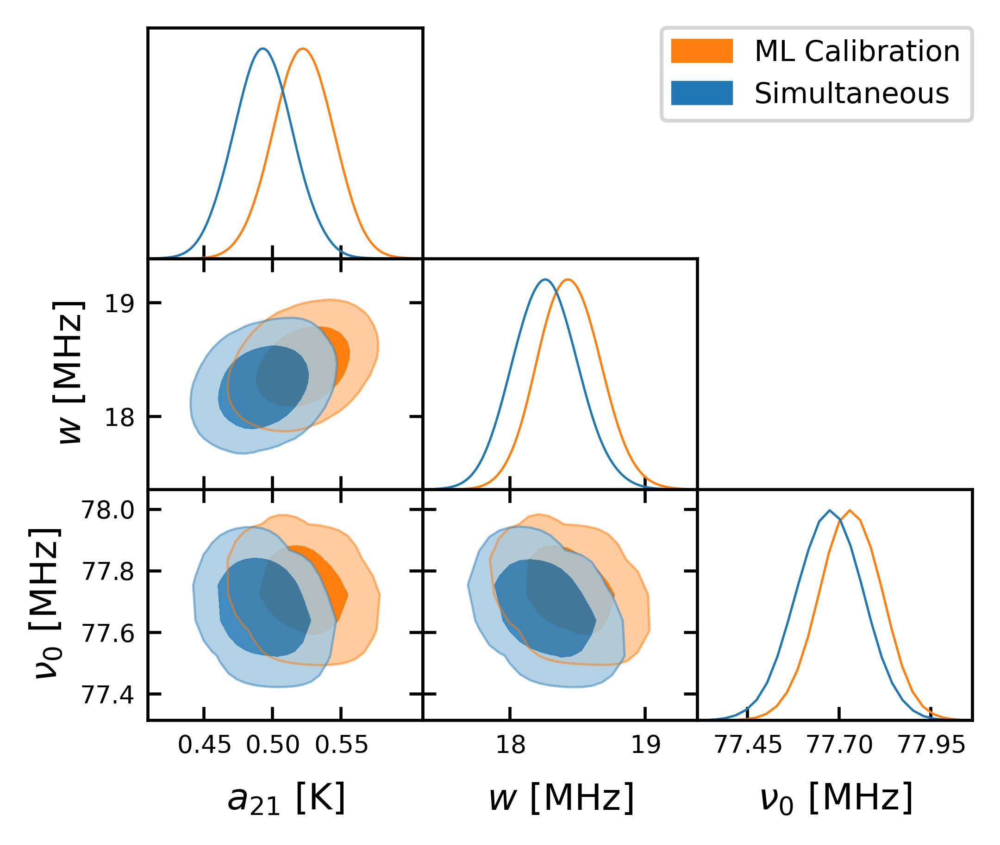

In [32]:
g = plots.get_subplot_plotter(width_inch=3.7, subplot_size_ratio=0.85)
g.triangle_plot(
    [
        done['alan_data_fg10_isolated_tau-fixed'], 
#        done['alan_data_fg5_simul_tau-fixed'],
        done['alan_data_fg10_simul_tau-fixed_iterative_recal'],
#        done['alan_data_fg10_simul_tau-fixed_iterative_recal'],
    ], 
    legend_labels=[
        r"ML Calibration",
        r"Simultaneous",
#        r"Simultaneous $N_{\rm FG}=7$",
#        r"Simultaneous $N_{\rm FG}=10$",
    ],
    contour_colors=['C1', 'C0'],
    filled=True, 
    params=['A', 'w', 'nu0'],
)
g.export("triangle_fg10_iso_vs_simul.png")

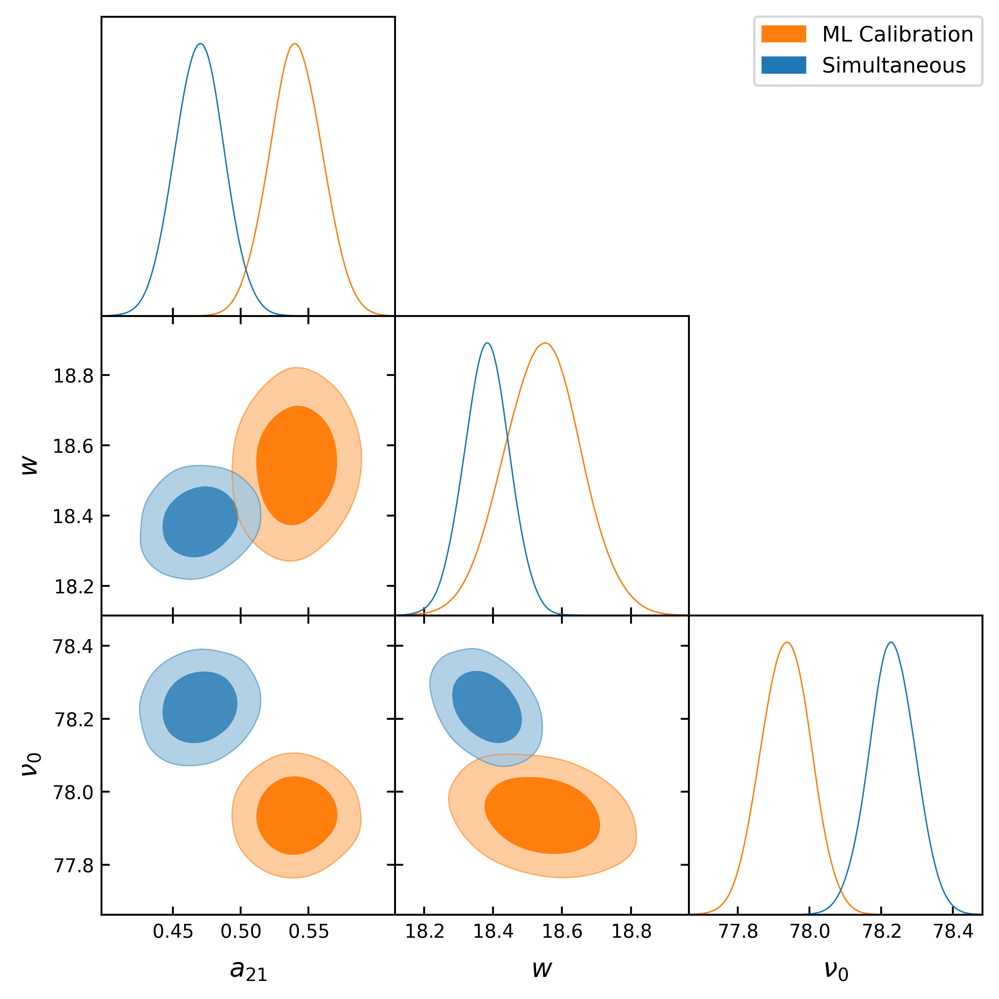

In [11]:
g = plots.get_subplot_plotter()
g.triangle_plot(
    [
        done['alan_data_fg7_isolated_tau-fixed_iterative_recal'], 
#        done['alan_data_fg5_simul_tau-fixed'],
        done['alan_data_fg7_simul_tau-fixed_iterative_recal'],
#        done['alan_data_fg10_simul_tau-fixed_iterative_recal'],
    ], 
    legend_labels=[
        r"ML Calibration",
        r"Simultaneous",
#        r"Simultaneous $N_{\rm FG}=7$",
#        r"Simultaneous $N_{\rm FG}=10$",
    ],
    contour_colors=['C1', 'C0'],
    filled=True, 
    params=['A', 'w', 'nu0']
)
g.export("triangle_fg7_iso_vs_simul.png")

In [12]:
g = plots.get_subplot_plotter()
g.triangle_plot(
    [
        done['alan_data_fg5_isolated_tau-fixed'], 
        done['alan_data_fg5_simul_tau-fixed'],
        done['alan_data_fg7_simul_tau-fixed_iterative_recal'],
        done['alan_data_fg10_simul_tau-fixed_iterative_recal'],
    ], 
    legend_labels=[
        r"ML Calibration $N_{\rm FG}=5$",
        r"Simultaneous $N_{\rm FG}=5$",
        r"Simultaneous $N_{\rm FG}=7$",
        r"Simultaneous $N_{\rm FG}=10$",
    ],
    contour_colors=['C1', 'C0', 'C2', 'C3'],
    filled=True, 
    params=['A', 'w', 'nu0']
)
g.export("triangle_fg5-7-10_iso_vs_simul.png")

In [14]:
g = plots.get_subplot_plotter()
g.triangle_plot(
    [
        done['alan_data_fg5_isolated_tau-fixed'], 
        done['alan_data_fg7_isolated_tau-fixed'],
        done['alan_data_fg10_isolated_tau-fixed'],
        done['alan_data_fg10_simul_tau-fixed_iterative_recal'],
    ], 
    legend_labels=[
        r"ML Calibration $N_{\rm FG}=5$",
        r"ML Calibration $N_{\rm FG}=7$",
        r"ML Calibration $N_{\rm FG}=10$",
        r"Simultaneous $N_{\rm FG}=10$",
    ],
    contour_colors=['C1', 'C0', 'C2', 'C3'],
    filled=True, 
    params=['A', 'w', 'nu0']
)
g.export("triangle_fg5-7-10_iso_vs_simul_mv_iso.png")

In [ ]:
fig, ax =  plt.subplots(5, 1, sharex=True, figsize=(8, 10), gridspec_kw={"hspace": 0.05, 'wspace': 0.05})

blobs = cal_blobs['c6_w5']
mc = cal_runs['c6_w5']
evidence=utils.get_evidence(mc.root)
utils.plot_cal_solutions(blobs, utils.calobs, fig=fig, ax=ax, cidx=1, label=f"Pure Cal, c6_w5: lnZ={evidence:.0f}")
utils.plot_linear_coeffs(blobs, utils.labcal_s11, fig=fig2, ax=ax2, cidx=1, label=f"Pure Cal, c6_w5: lnZ={evidence:.0f}")


blobs = data_blobs['alan_data_fg5_simul_tau-fixed']
mc = done['alan_data_fg5_simul_tau-fixed']
evidence=utils.get_evidence(mc.root)
utils.plot_cal_solutions(blobs, utils.calobs, fig=fig, ax=ax, cidx=0, label=r"Simul. $N_{\rm FG}=5$: lnZ=" + f"{evidence:.0f}")
utils.plot_linear_coeffs(blobs, utils.labcal_s11, fig=fig2, ax=ax2, cidx=0, label=r"Simul. $N_{\rm FG}=5$: lnZ=" + f"{evidence:.0f}")

ax[0].legend(ncol=1, bbox_to_anchor=(1.01, 0.5), loc='center left')
fig.savefig(f"compare_iso_simul_cal_solutions_5.png", bbox_inches='tight')

ax2[0].legend(ncol=1, bbox_to_anchor=(1.01, 0.5), loc='center left')
fig2.savefig(f"compare_iso_simul_recal_5.png", bbox_inches='tight')

blobs = data_blobs['alan_data_fg7_simul_tau-fixed_iterative_recal']
mc = done['alan_data_fg7_simul_tau-fixed_iterative_recal']
evidence=utils.get_evidence(mc.root)
utils.plot_cal_solutions(blobs, utils.calobs, fig=fig, ax=ax, cidx=2, label=r"Simul. $N_{\rm FG}=7$: lnZ=" + f"{evidence:.0f}")
utils.plot_linear_coeffs(blobs, utils.labcal_s11, fig=fig2, ax=ax2, cidx=2, label=r"Simul. $N_{\rm FG}=7$: lnZ=" + f"{evidence:.0f}")

blobs = data_blobs['alan_data_fg10_simul_tau-fixed_iterative_recal']
mc = done['alan_data_fg10_simul_tau-fixed_iterative_recal']
evidence=utils.get_evidence(mc.root)
utils.plot_cal_solutions(blobs, utils.calobs, fig=fig, ax=ax, cidx=3, label=r"Simul. $N_{\rm FG}=10$: lnZ=" + f"{evidence:.0f}")
utils.plot_linear_coeffs(blobs, utils.labcal_s11, fig=fig2, ax=ax2, cidx=3, label=r"Simul. $N_{\rm FG}=10$: lnZ=" + f"{evidence:.0f}")

ax[0].legend(ncol=1, bbox_to_anchor=(1.01, 0.5), loc='center left')
fig.savefig(f"compare_iso_simul_cal_solutions_all.png", bbox_inches='tight')

ax2[0].legend(ncol=1, bbox_to_anchor=(1.01, 0.5), loc='center left')
fig2.savefig(f"compare_iso_simul_recal_all.png", bbox_inches='tight')


In [21]:
g = plots.get_subplot_plotter()
g.triangle_plot([v for k,v in done.items() if '7' in k], legend_labels=[k.replace("alan_data_", "") for k,v in done.items() if '7' in k],filled=True, params=['A', 'w', 'nu0'])

g.export("nterms7_temp.png")

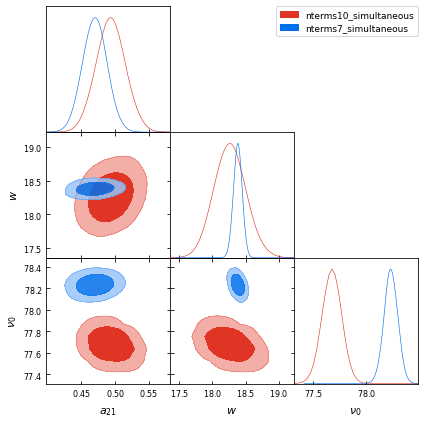

In [252]:
g = plots.get_subplot_plotter()
g.triangle_plot([v for k,v in done.items() if 'simultaneous' in k], legend_labels=[k.replace("alan_data_", "") for k,v in done.items() if 'simultaneous' in k],filled=True, params=['A', 'w', 'nu0'])

In [83]:
n = 0
for i, (name, model) in enumerate(data_lk_7term.nwfg_model.linear_model.model.models.items()):
    for j in range(model.n_terms):
        done['alan_data_nterms7_simultaneous'].addDerived(data_lk_7term_blobs['params'][:, 0, n], name=f'{name}_{j}', label=f'{name}_{j}')
        n += 1

NameError: name 'data_lk_7term' is not defined

In [281]:
g = plots.get_subplot_plotter()
g.triangle_plot(done['alan_data_nterms7_simultaneous'], labels=['A', 'w', 'nu0', 'fg_0'], filled=True)

TypeError: list indices must be integers or slices, not str

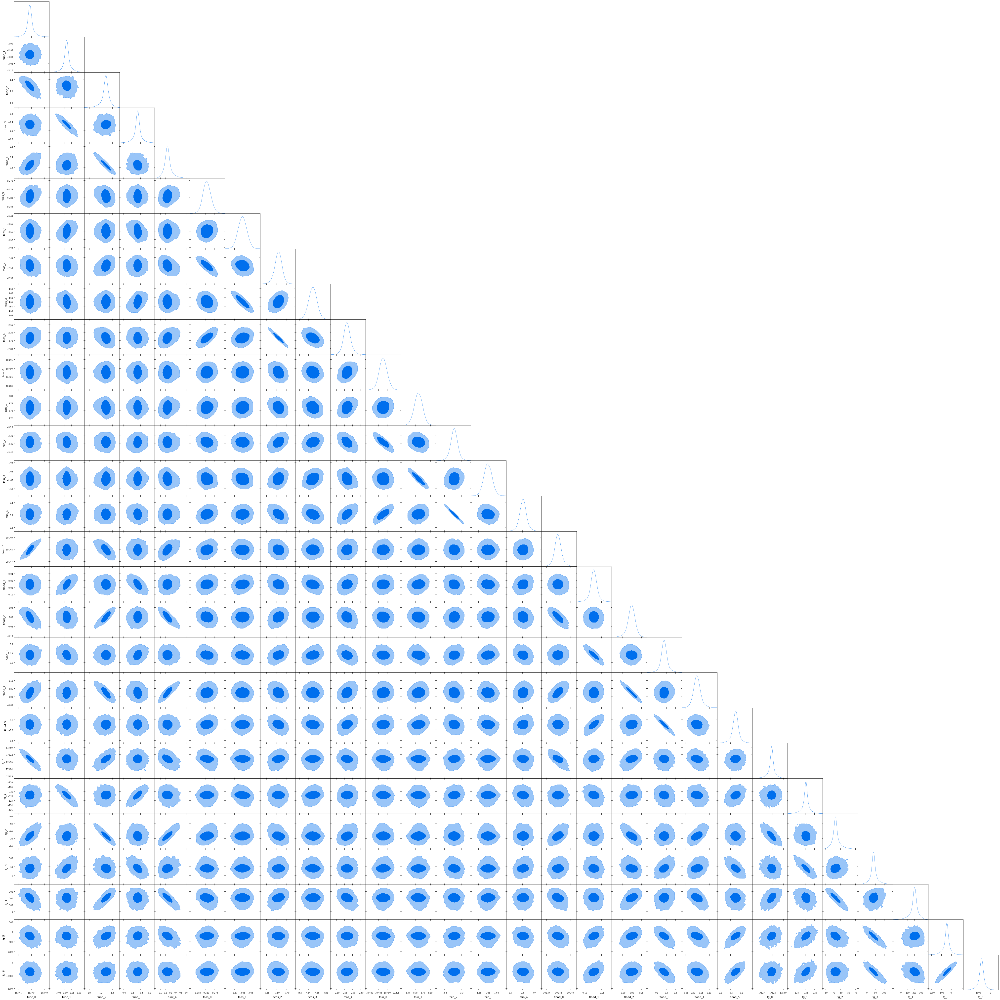

In [268]:
g = plots.get_subplot_plotter()
g.triangle_plot(nterms7_simul_derived, filled=True)

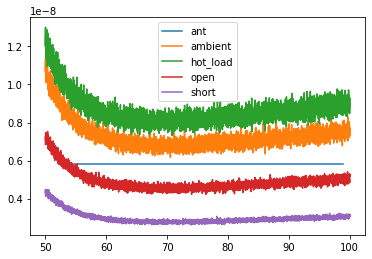

In [275]:
for src, var in data_lk_7term.data['data_variance'].items():
    if src == 'ant':
        var = var * len(data_lk_7term.nwfg_model._freq('ambient')) / len(data_lk_7term.nwfg_model._freq(src))
    plt.plot(data_lk_7term.nwfg_model._freq(src), var, label=src)
plt.legend()

In [259]:
done['alan_data_nterms7_simultaneous'].samples.shape

(23786, 9)

In [245]:
done['alan_data_nterms7_simultaneous'].setParamNames(
    ParamNames(names=[p.name for p in pnames.names], labels=[r'T_{\rm NS, %s}'%i for i in range(6)] + [p.label for p in pnames.names[6:]])
)

In [34]:
g = plots.get_subplot_plotter()
g.triangle_plot([done['alan_data_nterms7_simultaneous'], cal_only_samples_c6w5], filled=True, params='t_lns*')
g.export("compare_7term_to_cal.png")

In [ ]:
g = plots.get_subplot_plotter()
g.triangle_plot([done['alan_data_nterms7_simultaneous'], cal_only_samples_c6w5], filled=True, params='tunc*')
g.export("compare_7term_to_cal.png")

In [247]:
calobs.write("alans_noise_waves_2015.h5")

In [32]:
data_lk_7term = utils.get_likelihood(
    utils.labcal_s11, 
    fsky=utils.sky_data['freq'],
    fg=LinLog(n_terms=7),
    eor=utils.make_absorption(utils.sky_data['freq'], fix=('tau',)),
    sim=False,
    tns_width=3
)

In [40]:
def get_linear_distribution(samples,  n=1,nthreads=1, **kwargs):
    freq = np.linspace(50, 100, 200)

    nper_thread = len(samples) // nthreads
    last_n = nper_thread
    if len(samples) % nthreads:
        nper_thread += 1
        last_n = len(samples) - (nthreads-1)*nper_thread
    
    def do_stuff(thread):
        lk = data_mcmc.get_likelihood(**kwargs)
            
        tns_model = lk.t_ns_model.model.model.at(x=freq)
        
        nn = last_n if thread == nthreads-1 else nper_thread
        
        params = np.zeros((nn, n, lk.partial_linear_model.linear_model.n_terms))

        tns = np.zeros((nn, len(freq)))
        tload = np.zeros((nn, n, len(freq)))
        tunc = np.zeros((nn, n, len(freq)))
        tcos = np.zeros((nn, n, len(freq)))
        tsin = np.zeros((nn, n, len(freq)))
        tfg = np.zeros((nn, n, len(lk.nwfg_model.field_freq)))
        t21 = np.zeros((nn, len(lk.nwfg_model.field_freq)))
        a = np.zeros((nn, n, len(lk.nwfg_model.field_freq)))
        b = np.zeros((nn, n, len(lk.nwfg_model.field_freq)))
        recal_sky = np.zeros((nn, n, len(lk.nwfg_model.field_freq)))
        resids = np.zeros((nn, n, len(lk.nwfg_model.field_freq)))

        start = thread*nper_thread
        
        for i, sample in enumerate(samples[start:start+nn]):
            ctx = lk.partial_linear_model.get_ctx(params=sample)
            fit = lk.partial_linear_model.reduce_model(ctx=ctx, params=sample)[0]

            params[i] = fit.get_sample(n)
            tns[i] = tns_model(parameters=sample[:tns_model.n_terms])
            
            t21[i] = ctx['eor_spectrum']

            for j, p in enumerate(params[i]):
                tunc[i, j] = fit.fit.model.get_model('tunc', x=freq, parameters=p)
                tcos[i, j] = fit.fit.model.get_model('tcos', x=freq, parameters=p)
                tsin[i, j] = fit.fit.model.get_model('tsin', x=freq, parameters=p)
                tload[i, j] = fit.fit.model.get_model('tload', x=freq, parameters=p)
                tfg[i, j] = fit.fit.model.get_model('fg', x=lk.nwfg_model.field_freq, parameters=p)
                a[i, j], b[i,j] = lk.get_linear_coefficients(ctx=ctx, linear_params=p)
                recal_sky[i, j] = lk.recalibrated_sky_temp(a=a[i,j], b=b[i,j])
                resids[i, j] = recal_sky[i, j] - t21[i] - tfg[i, j]
        
        return tns, tload, tunc, tcos, tsin, params, tfg, t21, a, b, recal_sky, resids
        
    out = p_map(do_stuff, range(nthreads), num_cpus=nthreads)
    
    out_dict = {'samples': samples, 'freq': freq}
    for i, name in enumerate(['tns', 'tload', 'tunc', 'tcos', 'tsin', 'params', 'tfg', 't21', 'a', 'b', 'recal_sky', 'resids']):
        if name =='tfg' and cal_lk:
            break
            
        out_dict[name] = np.concatenate(tuple(o[i] for o in out))
    
    np.savez(data_mcmc.get_label(**kwargs)+"_blobs.npz", **out_dict)
        
    return out_dict

In [ ]:
cal_lk_blobs = data_lk_7term_blobs = get_linear_distribution(cal_only_samples_c6w5.samples, cterms=6, wterms=5, nthreads=16, cal_lk=True)

STRUCTURE:edges-io:Checking CalibrationObservation folder contents format at /data4/smurray/Projects/radio/EOR/Edges/bayesian-calibration/Receiver01_25C_2015_09_02_040_to_200MHz.


  0%|          | 0/16 [00:00<?, ?it/s]

ERROR:edges-io:The path /data4/smurray/Projects/radio/EOR/Edges/bayesian-calibration/Receiver01_25C_2015_09_02_040_to_200MHz does not exist!
STRUCTURE:edges-io:Checking Spectra folder contents format at S11.
STRUCTURE:edges-io:Checking CalibrationObservation folder contents format at /data4/smurray/Projects/radio/EOR/Edges/bayesian-calibration/Receiver01_25C_2015_09_02_040_to_200MHz.
ERROR:edges-io:The path S11 does not exist!
ERROR:edges-io:The filename S11 does not have the correct format for a Spectra. Correct format: Spectra.
ERROR:edges-io:The path /data4/smurray/Projects/radio/EOR/Edges/bayesian-calibration/Receiver01_25C_2015_09_02_040_to_200MHz does not exist!
STRUCTURE:edges-io:Checking CalibrationObservation folder contents format at /data4/smurray/Projects/radio/EOR/Edges/bayesian-calibration/Receiver01_25C_2015_09_02_040_to_200MHz.
STRUCTURE:edges-io:Checking Resistances folder contents format at S11.
ERROR:edges-io:The path S11 does not exist!
STRUCTURE:edges-io:Checking S

In [91]:
data_lk_7term_blobs = get_linear_distribution(samples.samples, nterms_fg=7, simultaneous=True, fix_tau=True, nthreads=16)

  0%|          | 0/16 [00:00<?, ?it/s]

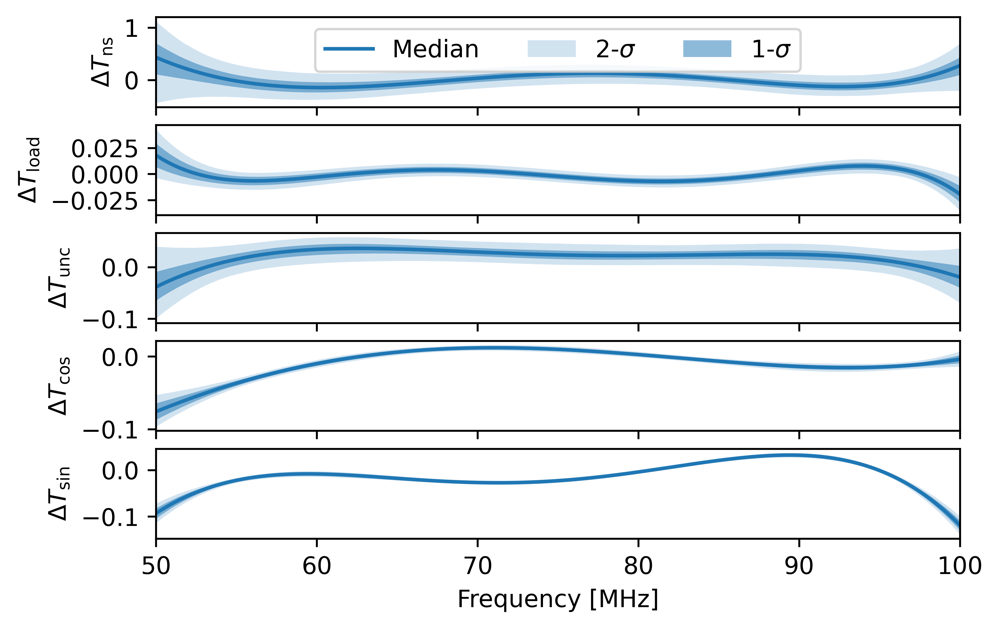

In [140]:
plot_cal_solutions(data_lk_7term_blobs, calobs)

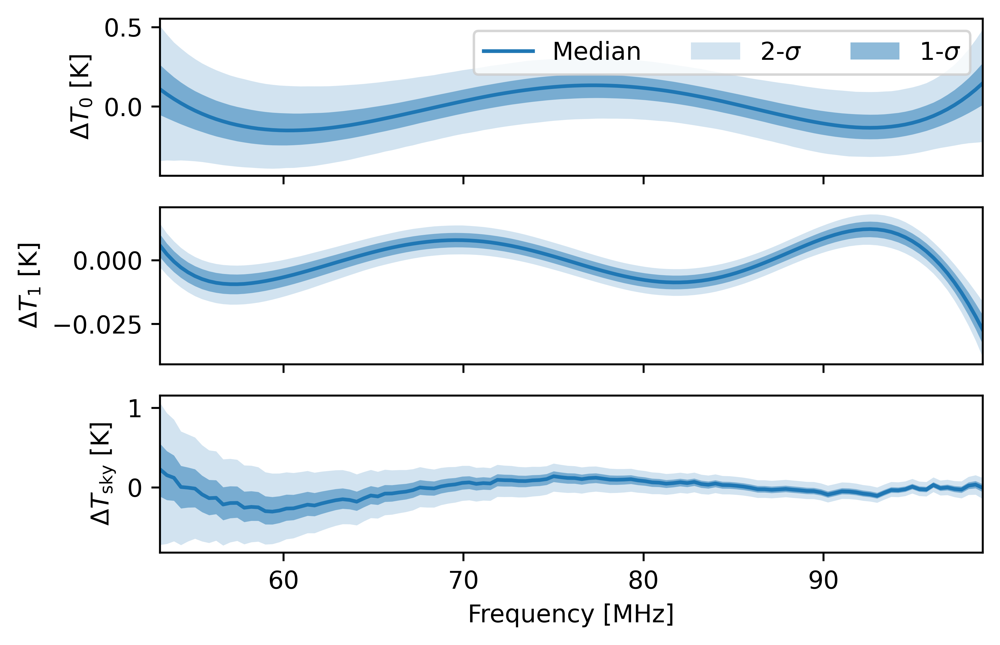

In [142]:
plot_linear_coeffs(data_lk_7term_blobs,labcal_s11)

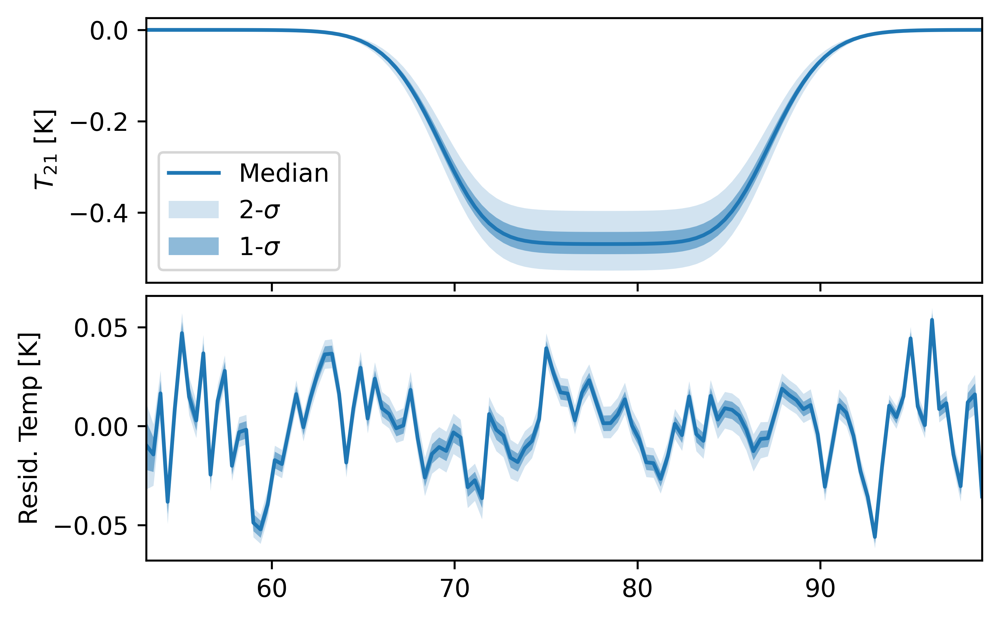

In [148]:
plot_sky_models(data_lk_7term_blobs)

# Some random math

$$
\hat{T} = T_0 Q + T_1
$$

\begin{align}
K_0 T_0 &= T_{\rm NS} \\
K_0 T_1 &= K_1 T_{\rm unc} + K_2 T_{\rm cos} + K_3 T_{\rm sin} - T_L = \mathbf{K}\mathbf{T_{\rm NW}}
\end{align}

\begin{alignat}{4}
&T_0 &&\, Q_{\rm amb} \, &-& \, T_{\rm amb} &=& \, \mathbf{K}_{\rm amb} && \, \mathbf{T}_{\rm NW} \\
&T_0 &&\, Q_{\rm hot} \, &-& \, T_{\rm hot} &=& \, \mathbf{K}_{\rm hot} && \, \mathbf{T}_{\rm NW} \\
&T_0 &&\, Q_{\rm opn} \, &-& \, T_{\rm opn} &=& \, \mathbf{K}_{\rm opn} && \, \mathbf{T}_{\rm NW} \\
&T_0 &&\, Q_{\rm sht} \, &-& \, T_{\rm sht} &=& \, \mathbf{K}_{\rm sht} && \, \mathbf{T}_{\rm NW} \\
\end{alignat}

\begin{alignat}{4}
    &T_0 &&\, Q_{\rm amb} \, &-& \, T_{\rm amb} &=& \, \mathbf{K}_{\rm amb} && \, \mathbf{T}_{\rm NW} \\
    &T_0 &&\, Q_{\rm hot} \, &-& \, T_{\rm hot} &=& \, \mathbf{K}_{\rm hot} && \, \mathbf{T}_{\rm NW} \\
    &T_0 &&\, Q_{\rm opn} \, &-& \, T_{\rm opn} &=& \, \mathbf{K}_{\rm opn} && \, \mathbf{T}_{\rm NW} \\
    &T_0 &&\, Q_{\rm sht} \, &-& \, T_{\rm sht} &=& \, \mathbf{K}_{\rm sht} && \, \mathbf{T}_{\rm NW} \\
    &T_0 &&\, Q_{\rm ant} \, &-& \, \left[ LT_{21} + (1-L)T_{\rm env}\right] &=& \, \mathbf{K}_{\rm ant} && \, \mathbf{T}_{\rm NW} + L T_{\rm FG} \\
 \end{alignat}

$$
\mathbf{r}_{\rm NW} = T_0 Q_{\rm src} - T_{\rm src} - \mathbf{K}_{\rm src} \mathbf{T_{\rm NW}}
$$

$$
  \hat{T}_0 Q_{\rm ant} - \left[ LT_{21} + (1-L)T_{\rm env}\right] = \mathbf{K}_{\rm ant}\hat{\mathbf{T}}_{\rm NW} + L T_{\rm FG}
$$

$$
  \hat{T}_0 Q_{\rm ant} - T_{\rm ant} = \mathbf{K}_{\rm ant}\hat{\mathbf{T}}_{\rm NW}
$$

$$
  \hat{T}_0 Q_{\rm ant} - \left[ LT_{21} + L T_{\rm FG} + (1-L)T_{\rm env}\right] = \mathbf{K}_{\rm ant}\hat{\mathbf{T}}_{\rm NW}
$$



$$
    P({\rm params}|{\rm data}, {\rm model}) = \frac{\mathcal{L}({\rm data}|{\rm params}, {\rm model}) \ P({\rm params})}{P({\rm data}|{\rm model})}
$$

$$
    \mathcal{L}(\mathbf{d} | \theta) = \frac{1}{\sqrt{(2\pi)^{N_d} \left|\Sigma(\theta)\right|}} \exp\left\{- \left[\mathbf{m}(\theta) - \mathbf{d}\right]^T \Sigma^{-1}(\theta)\left[\mathbf{m}(\theta) - \mathbf{d}\right]\right\}
$$

### Math about doing simul/one after the other

We have data $\{d_c, d_f\}$ (cal and field data) and parameters $\{\theta_c, \theta_s\}$ (cal and sky parameters).

Doing a simultaneous fit of all the data gives us a posterior:

$$
    P(\theta_c, \theta_s|d_c, d_f) \propto P(d_c,d_f|\theta_c, \theta_s) P(\theta_c)P(\theta_s),
$$

where all we have assumed is that the priors on $\theta_c$ and $\theta_s$ are uncorrelated.

Now, since the _data_ from the calibration and field are uncorrelated, we can write this as

$$
    P(\theta_c, \theta_s|d_c, d_f) \propto P(d_c|\theta_c) P(d_f|\theta_c, \theta_s) P(\theta_c)P(\theta_s),
$$

where we have also used the fact that $\theta_f$ does not say anything about the calibration data (but both calibration and sky parameters affect the field data). But $P(d_c|\theta_c)P(\theta_c)$ is simply proportional to the posterior $P(\theta_c|d_c)$, so we have

$$
    P(\theta_c, \theta_s|d_c, d_f) \propto P(d_f|\theta_c, \theta_s) P(\theta_c|d_c) P(\theta_s).
$$

This is exactly equivalent to getting the posterior of $\theta_c$ given $d_c$, and using it as a prior for a fit to $d_f$ using $\theta_c$ and $\theta_s$.

Thus I don't think that there is any mathematical difference between the two. The example of the models for $\theta_c$ and $\theta_s$ being entirely degenerate still works here, even if fit simultaneously: the calibration data will pin down $\theta_c$ in this case, because $\theta_s$ does not depend on it at all, then $\theta_s$ will be pinned by the field data.



In [91]:
file_roots = [fl.replace(".paramnames", "") for fl in glob.glob("alan_data_*.paramnames")]

In [92]:
file_roots

['alan_data_nterms10_simultaneous',
 'alan_data_fg10_isolated_tau-fixed',
 'alan_data_fg5_simul_tau-fixed',
 'alan_data_fg5_isolated_tau-fixed',
 'alan_data_fg7_isolated_tau-fixed',
 'alan_data_fg10_isolated_tau-free',
 'alan_data_fg7_simul_tau-free',
 'alan_data_nterms7_simultaneous']

In [94]:
for root in file_roots:
    if 'isolated' in root:
        all_fls = Path('.').glob(root+"*")
        for fl in all_fls:
            fl.replace(fl.with_name(fl.name.replace(root, root+"_iterative_recal")))

In [2]:
recal_tsky2 = utils.recalibrate(utils.labcal_s11, utils.sky_data['t_ant'], utils.sky_data['freq'], cal_lk=utils.get_cal_lk(utils.calobs))
recal_tsky = utils.recalibrate(utils.labcal_s11, utils.sky_data['t_ant'], utils.sky_data['freq'],)


In [5]:
recal_tsky2 - recal_tsky

array([ 0.27739868,  0.24582462,  0.21431599,  0.1831289 ,  0.1525063 ,
        0.12264643,  0.09372589,  0.06590206,  0.03930657,  0.01404885,
       -0.00977696, -0.03209751, -0.05285308, -0.07200151, -0.08951174,
       -0.10536509, -0.11955844, -0.13209591, -0.14299179, -0.1522676 ,
       -0.15995662, -0.166096  , -0.17072867, -0.1739093 , -0.17569154,
       -0.17613577, -0.17530566, -0.17326855, -0.1700954 , -0.16586511,
       -0.16064759, -0.15451647, -0.14755616, -0.13983912, -0.13144737,
       -0.1224582 , -0.1129506 , -0.10300252, -0.09268666, -0.08208113,
       -0.07126025, -0.06029369, -0.04925113, -0.03820018, -0.02720498,
       -0.01632738, -0.0056272 ,  0.0048401 ,  0.01502171,  0.02486778,
        0.03433201,  0.04337127,  0.05194653,  0.06002214,  0.06756527,
        0.07454787,  0.08094594,  0.08673396,  0.09189679,  0.09642068,
        0.10029352,  0.10351124,  0.10606759,  0.10796132,  0.10919693,
        0.10978161,  0.10972421,  0.10903705,  0.10773308,  0.10

In [6]:
from run_alan_data_mcmc import get_likelihood

In [7]:
lk = get_likelihood(5, True, True, False)

In [9]:
from yabf.samplers.polychord import polychord

In [11]:
poly = polychord(
    save_full_config=False,
    likelihood=lk.partial_linear_model,
    output_dir='polychord_chains',
    output_prefix=f'remove_me',
    sampler_kwargs=dict(
        nlive=1024,
        read_resume=False,
        feedback = 2
    )
)

In [12]:
poly.nderived

52

In [13]:
poly.derived_shapes

[0, 0]